In [1]:
from scipy.io import loadmat
import os
import re
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import cm
plt.style.use("seaborn")
from tqdm import tqdm
import time
from typing import List, Set, Dict, Tuple, Optional, Callable, Iterator, Union, NoReturn
import math
import json
import random
import joblib
import pickle
import xml.etree.ElementTree as etree

import matplotlib.image as mpimg
import seaborn as sns
import timeit
import cv2 as cv
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
from sklearn import metrics

import tensorflow as tf
import keras
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from keras.utils.vis_utils import plot_model
from tensorflow.keras import backend as K
from tensorflow.keras import optimizers
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras import layers
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import AveragePooling2D
from tensorflow.keras.layers import GlobalAveragePooling2D
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import Activation
from tensorflow.keras.layers import Dropout
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Rescaling
from tensorflow.keras.layers import Input
from tensorflow.keras.layers import Dense


In [46]:
%load_ext tensorboard
%tensorboard --logdir logs/scalars

## Fonctions

In [2]:
def equalize_img(img: np.ndarray) -> np.ndarray:
    img_YUV = cv.cvtColor(img, cv.COLOR_BGR2YUV)
    img_YUV[:,:,0] = cv.equalizeHist(img_YUV[:,:,0])
    img_equ = cv.cvtColor(img_YUV, cv.COLOR_YUV2RGB)
    img_RGB = cv.cvtColor(img_equ, cv.COLOR_BGR2RGB)
    return img_RGB

def resize_img(img: np.ndarray, resolution: int = 200) -> np.ndarray:
    ratio = img.shape[0]/img.shape[1]
    borne_min = 0.75
    borne_max = 1.33334
    if ratio >= borne_min and ratio <= borne_max:
        resize: np.ndarray = cv.resize(img, (resolution, resolution), interpolation=cv.INTER_CUBIC)
    elif ratio < borne_min:
        presize = math.ceil(resolution*ratio*borne_max)
        resize: np.ndarray = cv.resize(img, (resolution, presize), interpolation=cv.INTER_CUBIC)
        rajout = (resolution - presize) /2
        resize: np.ndarray = cv.copyMakeBorder(resize, top=math.ceil(rajout), bottom=math.floor(rajout), left=0, right=0, borderType=cv.BORDER_REPLICATE)
    elif ratio > borne_max:
        presize = math.ceil(resolution*1/(ratio*borne_min))
        resize: np.ndarray = cv.resize(img, (presize, resolution), interpolation=cv.INTER_CUBIC)
        rajout = (resolution - presize) /2
        resize: np.ndarray = cv.copyMakeBorder(resize, top=0, bottom=0, left=math.ceil(rajout), right=math.floor(rajout), borderType=cv.BORDER_REPLICATE)
    else:
        resize = np.array(0)
    return resize

def recadre_inbox(img: np.ndarray, bndbox: dict, square=True) -> np.ndarray:
    if square:
        loop = True
        switch = True
        while loop:
            box_ratio = (bndbox['ymax'] - bndbox['ymin'])/(bndbox['xmax'] - bndbox['xmin'])
            if box_ratio > 1:
                if switch:
                    if bndbox['xmax'] < img.shape[1]:
                        bndbox['xmax'] += 1
                    switch = False
                else:
                    if bndbox['xmin'] > 0:
                        bndbox['xmin'] -= 1
                    switch = True
                if (bndbox['xmax'] >= img.shape[1]) & (bndbox['xmin'] <= 0):
                    loop = False
            elif box_ratio < 1:
                if switch:
                    if bndbox['ymax'] < img.shape[0]:
                        bndbox['ymax'] += 1
                    switch = False
                else:
                    if bndbox['ymin'] > 0:
                        bndbox['ymin'] -= 1
                    switch = True
                if (bndbox['ymax'] >= img.shape[0]) & (bndbox['ymin'] <= 0):
                    loop = False
            else:
                loop = False
    return img[bndbox['ymin']:bndbox['ymax'],bndbox['xmin']:bndbox['xmax']]

def img_process(imgs, bndbox = None, resolution: int = 200, equalize: bool = False, denois: Optional[int] = None) -> np.ndarray:
    imgs_out = []
    for i, img in enumerate(imgs):
        if bndbox != None:
            img = recadre_inbox(img=img, bndbox=bndbox[i])
        img = resize_img(img=img, resolution=resolution)
        if equalize:
            img = equalize_img(img=img)
        if denois != None:
            img = cv.fastNlMeansDenoisingColored(src=img, h=denois)
        imgs_out.append(img)
    return np.array(imgs_out)

In [3]:
def plot_histogram(img: np.ndarray, title: str = "Image") -> None:
    luma = cv.cvtColor(img, cv.COLOR_BGR2YUV)[:,:,0]
    hist, bins = np.histogram(
                    luma.flatten(),
                    256, [0,256])
    # Cumulative Distribution Function
    cdf = hist.cumsum()
    cdf_normalized = cdf * float(hist.max()) / cdf.max()

    # Plot histogram
    fig = plt.figure(figsize=(20,6))
    plt.subplot(1, 2, 1)
    plt.imshow(img)
    plt.title(title)
    plt.grid(False)
    plt.subplot(1, 2, 2)
    plt.plot(cdf_normalized, 
             color='r', alpha=.7,
             linestyle='--')
    plt.hist(luma.flatten(),256,[0,256])
    plt.xlim([0,256])
    plt.legend(('cdf','histogram'), loc = 'upper left')
    plt.title("Histogrammeet et histogramme cumulé", color="#343434")
    plt.suptitle("Image et son Histogramme", fontsize=22, y=.98)
    plt.show()
    
def plot_aug(aug, name: str, data: np.ndarray, index: Optional[int] = None, n_exemple: int = 9, plot_size: int = 5) -> None:
    # Convert test img to array
    if index == None:
        index = random.randint(0, data.shape[0])
        print(index)
    sqrt = math.floor(math.sqrt(n_exemple))
    plt.figure(figsize=(plot_size*sqrt,plot_size*math.ceil(n_exemple/sqrt)))
    x = data[index]
    x = x.reshape((1,) + x.shape)
    it = aug.flow(x, batch_size=1)
    for i in range(n_exemple):
        plt.subplot(math.ceil(n_exemple/sqrt), sqrt, i+1)
        batch = it.next()
        plt.imshow(batch[0]/255)
        plt.grid(False)
        plt.xticks([], [])
        plt.yticks([], [])
    # plt.suptitle("Data Augmentation : "+name,
    #             fontsize=22, y=.90)
    plt.tight_layout()
    plt.show()

In [4]:
class ModelCNN:
    """
    Permet de manipuler différents Réseau à Convolution pour de la Classification
    dans le même objet pour simplifier les comparaisons et visualisations
    """
    def __init__(self, y_train: np.ndarray, y_test: np.ndarray, y_val: np.ndarray, epochs: int = 30):
        self.models = pd.DataFrame(columns=[
            'name',
            'data_use',
            'model',
            'confusion_matrice',
            'Error',
            'Jaccard Macro',
            'Precision Macro',
            'Recall Macro',
            'F_mesure Macro',
            'Jaccard Micro',
            'Precision Micro',
            'Recall Micro',
            'F_mesure Micro',
            'fit_time',
            'pred_time',
            'y_pred',
            'history'
        ])
        self.models.set_index('name', inplace=True)
        self.scoring = {}
        self.y_train = y_train
        self.y_test = y_test
        self.y_val = y_val
        self.x = {}
        self.augment = {}
        self.epochs = epochs
    def save_models(self, path: str) -> None:
        self.models.drop(['model'], axis=1).loc[self.models['y_pred'].notna()].to_pickle(path=path)
        print('données du fichier '+ path + ' bien sauvegardé')
    def load_models(self, path: str) -> None:
        new_data = pd.read_pickle(path)
        self.models = pd.concat([self.models, new_data])
        print('données du fichier '+ path + ' bien chargé')
    def add_model(self, name: str, model = None, layers: Optional[list] = None, scoring: list = [], optimizer='adam') -> None:
        self.models.loc[name, 'data_use'] = 'no fit'
        metrics = []
        if scoring == []:
            scoring = list(self.scoring.keys())
        for i in scoring:
            metrics.append(self.scoring[i])
        if layers != None:
            model = Sequential(layers=layers)
        if model == None:
            raise ValueError('Aucune valeurs n\'est rentré dans "model" ou "layers"')
        model.compile(optimizer=optimizer,
            loss="sparse_categorical_crossentropy",
            metrics=metrics)
        self.models.loc[name]['model'] = model
        print('le model '+ name + ' ajouté')
    def unload_models(self) -> None:
        for mod in self.models.index.to_list():
            self.models.loc[mod]['model'] = None
        K.clear_session()
    def add_data(self, name: str, x_train: np.ndarray, x_test: np.ndarray, x_val: np.ndarray) -> None:
        self.x[name] = {
            'x_train': x_train,
            'x_test': x_test,
            'x_val': x_val
        }
    def add_augment(self, name: str, augment) -> None:
        self.augment[name] = augment
    def add_scoring(self, scoring: Union[Callable, str]) -> None:
        if type(scoring) == str:
            name = scoring
        else:
            name = scoring.__name__
        self.scoring[name] = scoring
    def fit(self, model_name: str, data: Optional[str] = None, augment: Optional[str] = None, verbose: int = 1, batch: int = 32) -> None:
        model = self.models.loc[model_name]
        start_fit = time.time()
        history = model.model.fit(
            self.augment[augment].flow(
                self.x[data]['x_train'], self.y_train,
                batch_size=batch, shuffle=True),
            validation_data=(self.x[data]['x_val'], self.y_val),
            batch_size=batch,
            steps_per_epoch=None,
            epochs=self.epochs,
            verbose=verbose)
        fit_pred = time.time()
        y_pred = model.model.predict(self.x[data]['x_test'])
        pred_end = time.time()
        model.history = history.history
        model.fit_time = fit_pred - start_fit
        model.pred_time = pred_end - fit_pred
        model.y_pred = y_pred
        y_predict = y_pred.argmax(1)
        y_true = self.y_test
        model['confusion_matrice'] = metrics.confusion_matrix(y_true, y_predict)
        model['Error'] = metrics.hamming_loss(y_true, y_predict)
        model['Jaccard Macro'] = metrics.jaccard_score(y_true, y_predict, average='macro')
        model['Precision Macro'] = metrics.precision_score(y_true, y_predict, average='macro')
        model['Recall Macro'] = metrics.recall_score(y_true, y_predict, average='macro')
        model['F_mesure Macro'] = metrics.f1_score(y_true, y_predict, average='macro')
        model['Jaccard Micro'] = metrics.jaccard_score(y_true, y_predict, average='micro')
        model['Precision Micro'] = metrics.precision_score(y_true, y_predict, average='micro')
        model['Recall Micro'] = metrics.recall_score(y_true, y_predict, average='micro')
        model['F_mesure Micro'] = metrics.f1_score(y_true, y_predict, average='micro')
    def plot_history_scores(self, model_list: list = [], metric_list: list = [], loss: bool = True, plot_size: int = 10) -> None:
        if model_list == []:
            model_list = self.models.index.to_list()
        if metric_list == []:
            metric_list = list(self.scoring.keys())
        if loss:
            metric_list.append('loss')
        for name in model_list:
            model = self.models.loc[name]
            lenth = len(metric_list)
            sqrt = math.floor(math.sqrt(lenth))
            plt.figure(figsize=(plot_size*math.ceil(lenth/sqrt), plot_size*sqrt))
            plt.suptitle('Scores du model : ' + model.name, fontsize=20)
            for it, metric in enumerate(metric_list):
                plt.subplot(sqrt, math.ceil(lenth/sqrt), it+1)
                plt.style.context('seaborn-whitegrid')
                plt.plot(model.history[metric], color="b")
                plt.plot(model.history['val_' + metric],
                        linestyle='--', color="orange")
                plt.title(metric, fontsize=18)
                plt.yticks(fontsize=12)
                plt.xticks(fontsize=12)
                plt.xlabel('epoch', fontsize=14)
                plt.ylabel(metric, fontsize=14)
                plt.legend(['train', 'validation'], loc='lower left')
            plt.show()
    def plot_augment(self, augmented: str, img_ex: Optional[int] = None, n_exemple: int = 9, plot_size: int = 5) -> None:
        if img_ex == None:
            img_ex = random.randint(0, x_train.shape[0])
        sqrt = math.floor(math.sqrt(n_exemple))
        plt.figure(figsize=(plot_size*sqrt,plot_size*math.ceil(n_exemple/sqrt)))
        x = image.img_to_array(x_train[img_ex])
        x = x.reshape((1,) + x.shape)
        it = 0
        for batch in self.augment[augmented].flow(x, batch_size=1):
            plt.subplot(math.ceil(n_exemple/sqrt), sqrt, it+1)
            plt.imshow(image.array_to_img(batch[0]))
            plt.grid(False)
            it += 1
            if it % n_exemple == 0:
                break
        plt.suptitle("Data Augmentation with Keras",
                    fontsize=22, y=.90)
        plt.show()
    def plot_perf(self, perf_list: List[str] = [], model_list: List = [], plot_size: int = 10) -> None:
        if perf_list == []:
            perf_list = ['Error', 'Jaccard Macro', 'Precision Macro',
                        'Recall Macro', 'F_mesure Macro', 'Jaccard Micro',
                        'Precision Micro', 'Recall Micro', 'F_mesure Micro',
                        'fit_time', 'pred_time']
        if model_list == []:
            models = self.models
        else:
            models = self.models.loc[model_list]
        lenth = len(perf_list)
        sqrt = math.floor(math.sqrt(lenth))
        plt.figure(figsize=(plot_size*sqrt,plot_size*math.ceil(lenth/sqrt)))
        for it, score in enumerate(perf_list):
            plt.subplot(math.ceil(lenth/sqrt), sqrt, it+1)
            value = models[score].values.astype('float')
            colors = cm.winter(value / float(max(value)))
            plt.bar(models.index, value, color = colors)
            plt.title('Score '+score+' par Modele', fontsize=18)
            plt.xticks(rotation=60, fontsize=14)
            plt.yticks(fontsize=16)
            plt.xlabel('')
            plt.ylabel(score, fontsize=14)
        plt.tight_layout()
        plt.show()
    def plot_confmat(self, model_list: list = [], plot_size: int = 8, annot: bool = True) -> None:
        if model_list == []:
            model_list = self.models.index.to_list()
        lenth = len(model_list)
        sqrt = math.floor(math.sqrt(lenth))
        plt.figure(figsize=(plot_size*sqrt,plot_size*math.ceil(lenth/sqrt)))
        for it, name in enumerate(model_list):
            plt.subplot(math.ceil(lenth/sqrt), sqrt, it+1)
            sns.heatmap(self.models.loc[name]['confusion_matrice'], annot=annot, cbar=False,
                        xticklabels=lab_encode.classes_, yticklabels=lab_encode.classes_, square=True)
            plt.title('Matrice de Confusion de '+ name, fontsize=18)
            plt.xticks(rotation=60, fontsize=14)
            plt.yticks(fontsize=14)
            plt.ylabel('True Labels', fontsize=16)
            plt.xlabel('Predicted Labels', fontsize=16)
        plt.tight_layout()
        plt.show()

In [5]:
def recall_m(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    recall = true_positives / (possible_positives + K.epsilon())
    return recall

def precision_m(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    precision = true_positives / (predicted_positives + K.epsilon())
    return precision
def f1_m(y_true, y_pred):
    precision = precision_m(y_true, y_pred)
    recall = recall_m(y_true, y_pred)
    return 2*((precision*recall)/(precision+recall+K.epsilon()))

In [6]:
def show_images_classes(path, classes, num_sample) -> None:
    """This function is used to display the first 
    n images of a directory passed as an argument. 
    It is adapted to subdirectories. 
    
    The matplotlib.image library must be loaded 
    with the alias mpimg. 

    Parameters
    ----------------------------------------
    path : string
        Link of root directory
    classes : string 
        Name of the subdirectory
    num_smaple : integer
        Number of picture to show
    ----------------------------------------
    """
    fig = plt.figure(figsize=(30,20))
    fig.patch.set_facecolor('#343434')
    plt.suptitle("{}".format(classes.split("-")[1]), y=.83,
                 color="white", fontsize=22)
    images = os.listdir(path + "/" + classes)[:num_sample]
    for i in range(num_sample):
        img = mpimg.imread(path+"/"+classes+"/"+images[i])
        plt.subplot(int(num_sample/8+1), 8, i+1)
        plt.imshow(img)
        plt.axis('off')
    plt.show()
def plot_img(imgs: list, title: Optional[list] = None, plot_size: int = 10):
    lenth = len(imgs)
    sqrt = math.floor(math.sqrt(lenth))
    plt.figure(figsize=(plot_size*sqrt,plot_size*math.ceil(lenth/sqrt)))
    for it, img in enumerate(imgs):
        plt.subplot(math.ceil(lenth/sqrt), sqrt, it+1)
        plt.imshow(img)
        if title != None:
            plt.title(title[it], fontsize=16)
        plt.grid(False)
        plt.yticks([])
    plt.show()

In [7]:
def make_model(input_shape, num_classes):
    inputs = keras.Input(shape=input_shape)
    # Entry block
    x = layers.Rescaling(scale=1./255)(inputs)
    x = layers.Conv2D(32, 3, strides=2, padding="same")(x)
    x = layers.BatchNormalization()(x)
    x = layers.Activation("relu")(x)

    x = layers.Conv2D(64, 3, padding="same")(x)
    x = layers.BatchNormalization()(x)
    x = layers.Activation("relu")(x)

    previous_block_activation = x  # Set aside residual

    for size in [128, 256, 512, 768]:
        x = layers.Activation("relu")(x)
        x = layers.SeparableConv2D(size, 3, padding="same")(x)
        x = layers.BatchNormalization()(x)

        x = layers.Activation("relu")(x)
        x = layers.SeparableConv2D(size, 3, padding="same")(x)
        x = layers.BatchNormalization()(x)

        x = layers.MaxPooling2D(3, strides=2, padding="same")(x)

        # Project residual
        residual = layers.Conv2D(size, 1, strides=2, padding="same")(
            previous_block_activation
        )
        x = layers.add([x, residual])  # Add back residual
        previous_block_activation = x  # Set aside next residual

    x = layers.SeparableConv2D(1024, 3, padding="same")(x)
    x = layers.BatchNormalization()(x)
    x = layers.Activation("relu")(x)

    x = layers.GlobalAveragePooling2D()(x)
    if num_classes == 2:
        activation = "sigmoid"
        units = 1
    else:
        activation = "softmax"
        units = num_classes

    x = layers.Dropout(0.5)(x)
    outputs = layers.Dense(units, activation=activation)(x)
    return keras.Model(inputs, outputs)
def transfert_to_model(init_model, nb_classes: int):
    # Dont retrain layers
    for layer in init_model.layers:
        layer.trainable = False
    # Add new fully-connected layers
    base_output = init_model.output
    base_output = Dense(128, activation='relu')(base_output)
    base_output = Dropout(0.2)(base_output)
    # Output : new classifier
    predictions = Dense(nb_classes, activation='softmax')(base_output)
    # Define new model
    out_model = Model(inputs=init_model.input,
                            outputs=predictions)
    return out_model

## Préparation

In [15]:
IMAGES = 'Data/images/'
ANNOTATION = 'Data/annotation/'
folder_list = os.listdir(IMAGES)

dogs_list = [
    'Labrador_retriever', 
    'golden_retriever', 
    'German_shepherd', 
    'Chihuahua', 
    'Siberian_husky', 
    'Yorkshire_terrier', 
    'Shih-Tzu', 
    'French_bulldog', 
    'boxer', 
    'beagle'
    ]
final_folder = []
for folder in folder_list:
    for dog in dogs_list:
        if dog in folder:
            final_folder.append(folder)
            break

num_breeds = len(dogs_list)
img_path = []
labels = []
bndbox = []

for folder_path in final_folder:
    files_path = os.listdir(ANNOTATION + folder_path)
    for file_path in files_path:
        img_path.append(IMAGES + folder_path + '/' + file_path + '.jpg')
        annot_elem = etree.parse(ANNOTATION + folder_path + '/' + file_path).getroot().find('object')
        labels.append(annot_elem.find('name').text)
        bndbox.append({
            'xmin': int(annot_elem.find('bndbox').find('xmin').text),
            'ymin': int(annot_elem.find('bndbox').find('ymin').text),
            'xmax': int(annot_elem.find('bndbox').find('xmax').text),
            'ymax': int(annot_elem.find('bndbox').find('ymax').text)
        })

In [16]:
size = []
ratios = []
imgs = []
size_box = []
ratios_box = []
img_box = []
for i, path in enumerate(img_path):
    imgs.append(cv.cvtColor(cv.imread(path), cv.COLOR_BGR2RGB))
    shape = cv.imread(path).shape
    size.append(shape[0]*shape[1])
    ratios.append(shape[0]/shape[1])
    img_box.append(recadre_inbox(imgs[i], bndbox=bndbox[i]))
    shape = img_box[-1].shape
    size_box.append(shape[0]*shape[1])
    ratios_box.append(shape[0]/shape[1])
size = np.array(size)
ratios = np.array(ratios)
size_box = np.array(size_box)
ratios_box = np.array(ratios_box)

lab_encode = LabelEncoder()
Y = lab_encode.fit_transform(labels)

train_ratio = 0.75
validation_ratio = 0.15
test_ratio = 0.10

# train is now 75% of the entire data set
# the _junk suffix means that we drop that variable completely
x_train, x_test, y_train, y_test, box_train, box_test = train_test_split(imgs, Y, bndbox, test_size=1 - train_ratio, random_state=8)

# test is now 10% of the initial data set
# validation is now 15% of the initial data set
x_val, x_test, y_val, y_test, box_val, box_test = train_test_split(x_test, y_test, box_test, test_size=test_ratio/(test_ratio + validation_ratio), random_state=7) 

## Exploration

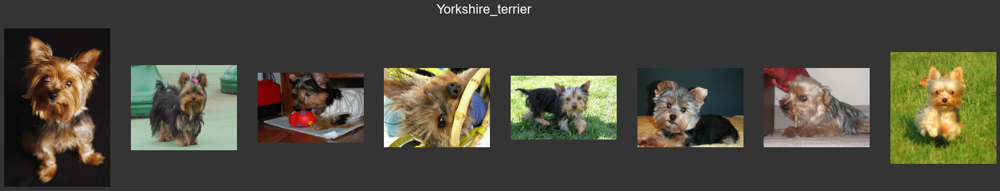

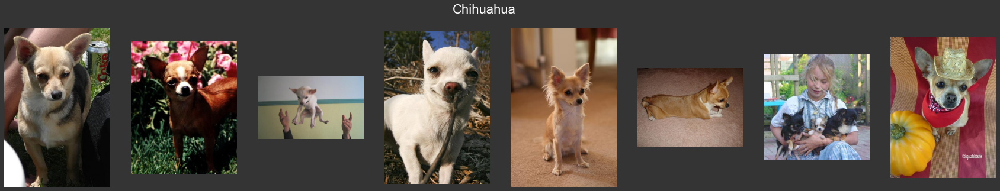

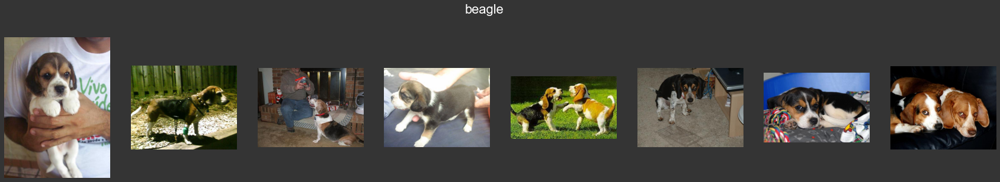

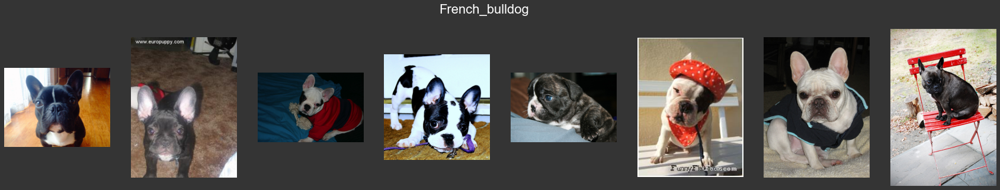

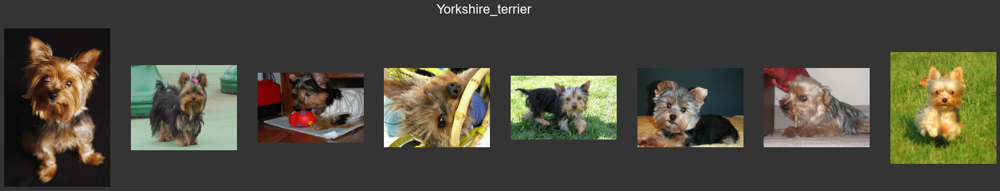

In [60]:
for i in np.random.randint(0, len(final_folder), size=5):
    show_images_classes(IMAGES, final_folder[i], 8)

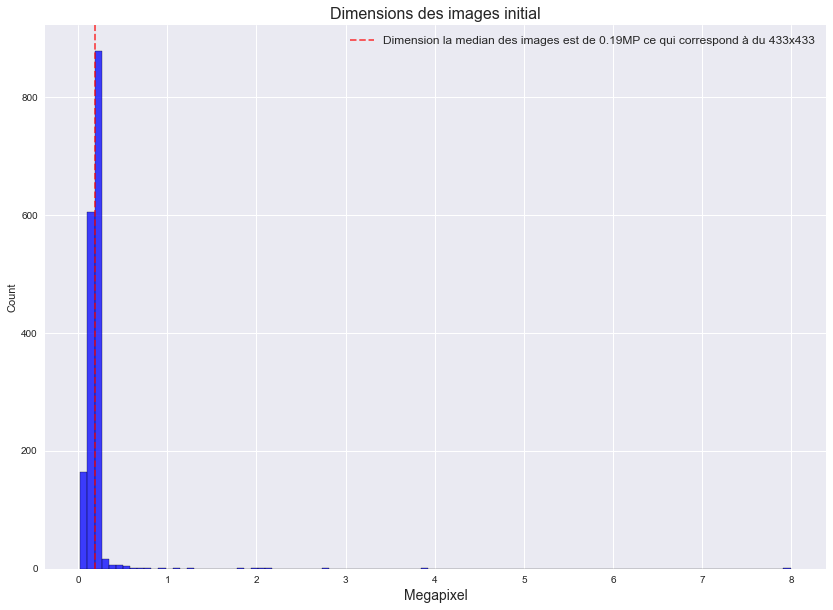

In [12]:
plt.figure(figsize=(14,10))
sns.histplot(size / 1000000, bins=100, color='Blue')
plt.axvline(np.median(size / 1000000),
           color='r', alpha=.7,
           linestyle='--',
           label="Dimension la median des images est de {:.2f}MP ce qui correspond à du {:.0f}x{:.0f}".format(np.median(size / 1000000), math.sqrt(np.median(size)), math.sqrt(np.median(size))))
plt.title('Dimensions des images initial', fontsize=16)
plt.xlabel('Megapixel', fontsize=14)
plt.legend(fontsize=12)
plt.show()

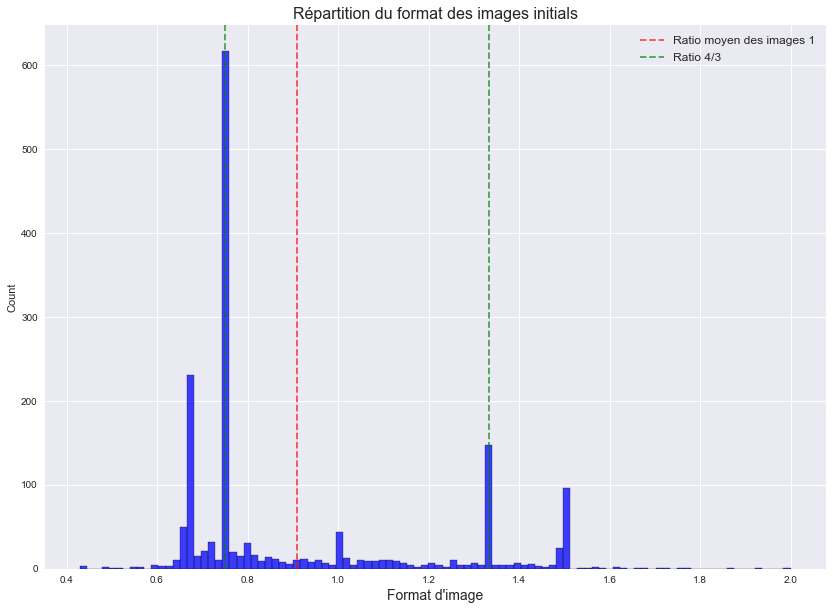

0.6517647058823529


In [42]:
plt.figure(figsize=(14,10))
sns.histplot(ratios, bins=100, color='Blue')
plt.axvline(np.mean(ratios),
           color='r', alpha=.7,
           linestyle='--',
           label="Ratio moyen des images {:.0f}".format(np.median(ratios)))
plt.axvline(1.333333,
           color='g', alpha=.7,
           linestyle='--',
           label="Ratio 4/3")
plt.axvline(0.75,
           color='g', alpha=.7,
           linestyle='--')
plt.xlabel('Format d\'image', fontsize=14)
plt.title('Répartition du format des images initials', fontsize=16)
plt.legend(fontsize=12)
plt.show()

# proportion des images 4/3 ou plus carré
print(ratios[ratios >= 0.75][ratios[ratios >= 0.75] < 1.3334].shape[0] / ratios.shape[0])

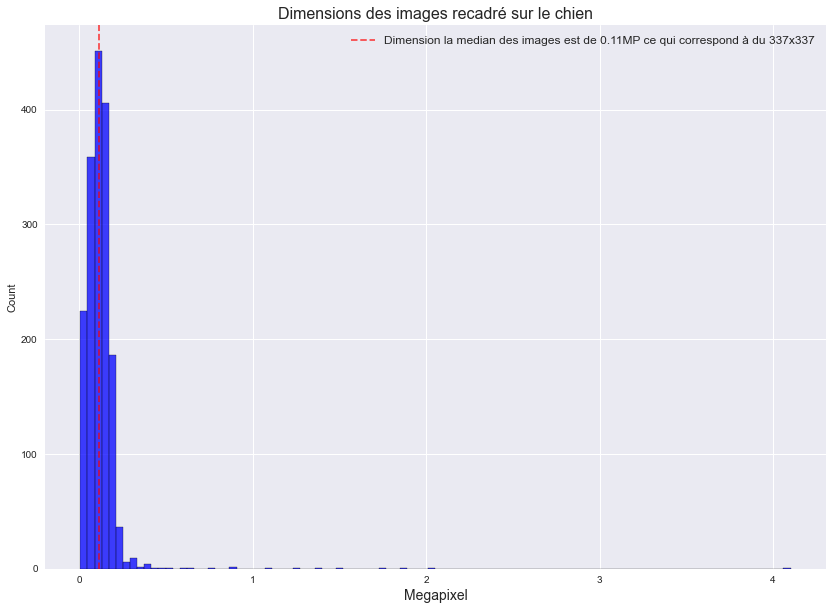

In [13]:
plt.figure(figsize=(14,10))
sns.histplot(size_box / 1000000, bins=100, color='Blue')
plt.axvline(np.median(size_box / 1000000),
           color='r', alpha=.7,
           linestyle='--',
           label="Dimension la median des images est de {:.2f}MP ce qui correspond à du {:.0f}x{:.0f}".format(np.median(size_box / 1000000), math.sqrt(np.median(size_box)), math.sqrt(np.median(size_box))))
plt.title('Dimensions des images recadré sur le chien', fontsize=16)
plt.xlabel('Megapixel', fontsize=14)
plt.legend(fontsize=12)
plt.show()

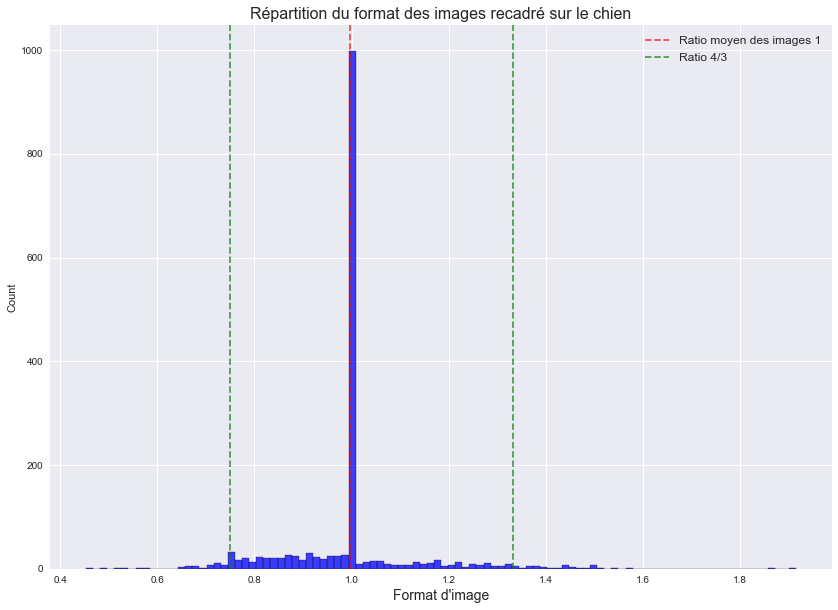

0.9382352941176471


In [41]:
plt.figure(figsize=(14,10))
sns.histplot(ratios_box, bins=100, color='Blue')
plt.axvline(np.mean(ratios_box),
           color='r', alpha=.7,
           linestyle='--',
           label="Ratio moyen des images {:.0f}".format(np.median(ratios_box)))
plt.axvline(1.333333,
           color='g', alpha=.7,
           linestyle='--',
           label="Ratio 4/3")
plt.axvline(0.75,
           color='g', alpha=.7,
           linestyle='--')
plt.xlabel('Format d\'image', fontsize=14)
plt.title('Répartition du format des images recadré sur le chien', fontsize=16)
plt.legend(fontsize=12)
plt.show()

# proportion des images 4/3 ou plus carré
print(ratios_box[ratios_box >= 0.75][ratios_box[ratios_box >= 0.75] < 1.3334].shape[0] / ratios_box.shape[0])

## Visualisation

In [57]:
rd = random.randint(0, len(imgs))
print(rd)

1491


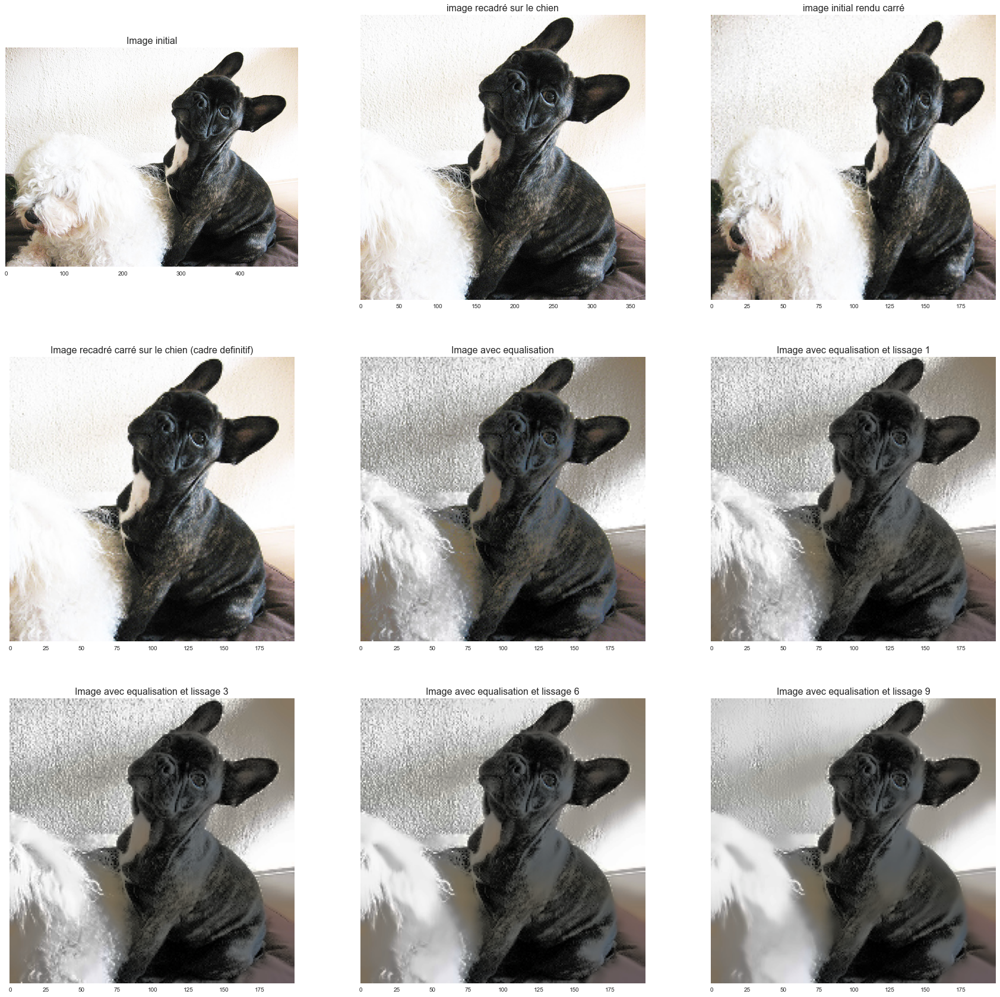

In [58]:
plot_img([
    imgs[rd],
    recadre_inbox(imgs[rd], bndbox[rd], False),
    img_process([imgs[rd]])[0],
    img_process([imgs[rd]], [bndbox[rd]], 200)[0],
    img_process([imgs[rd]], [bndbox[rd]], 200, True)[0],
    img_process([imgs[rd]], [bndbox[rd]], 200, True, 1)[0],
    img_process([imgs[rd]], [bndbox[rd]], 200, True, 3)[0],
    img_process([imgs[rd]], [bndbox[rd]], 200, True, 6)[0],
    img_process([imgs[rd]], [bndbox[rd]], 200, True, 9)[0]],
         ['Image initial', 'image recadré sur le chien', 'image initial rendu carré', 'Image recadré carré sur le chien (cadre definitif)', 'Image avec equalisation', 'Image avec equalisation et lissage 1', 'Image avec equalisation et lissage 3', 'Image avec equalisation et lissage 6', 'Image avec equalisation et lissage 9'])

333


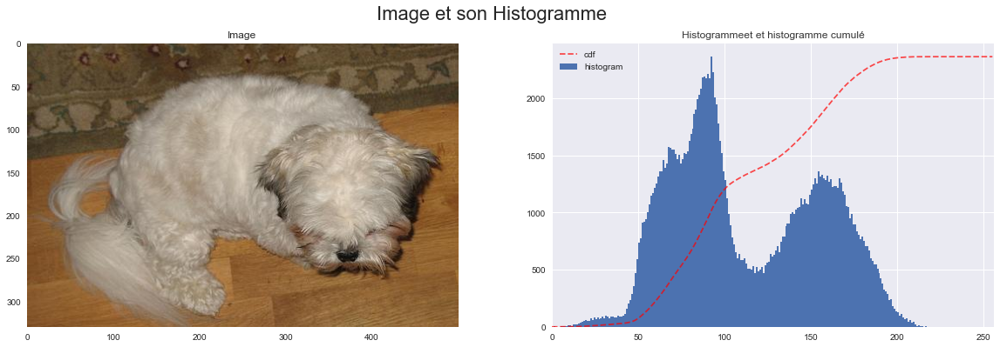

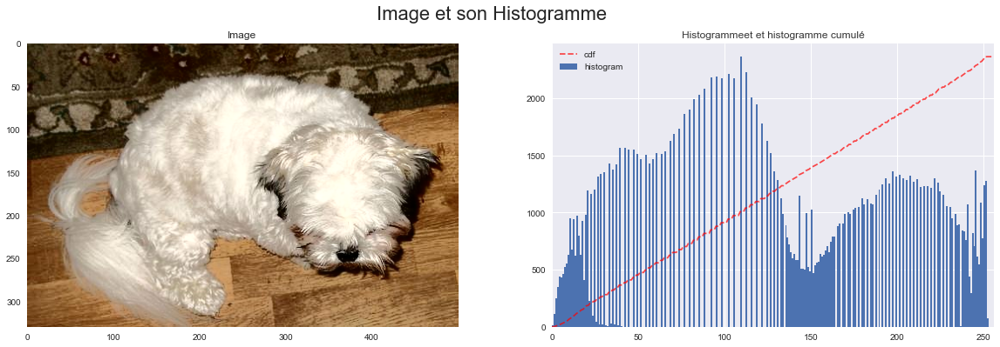

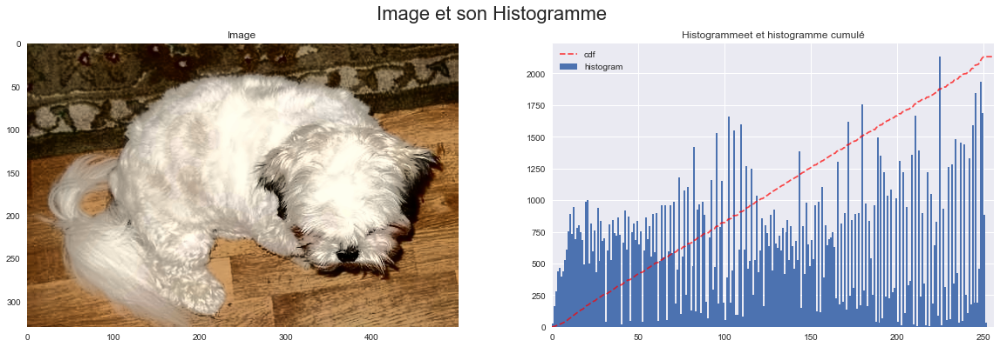

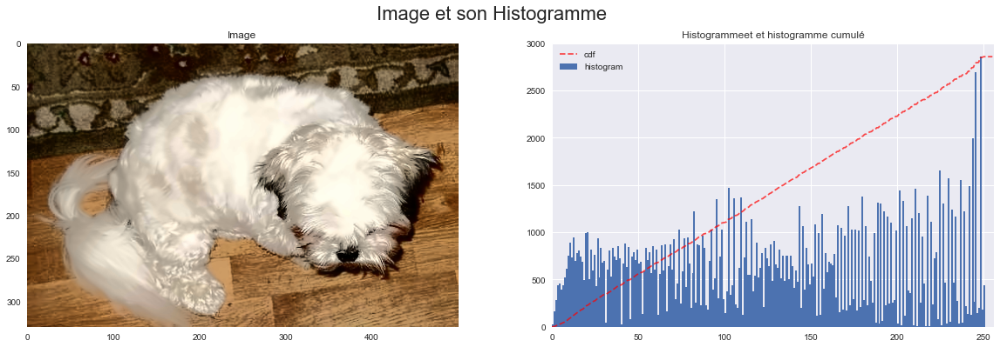

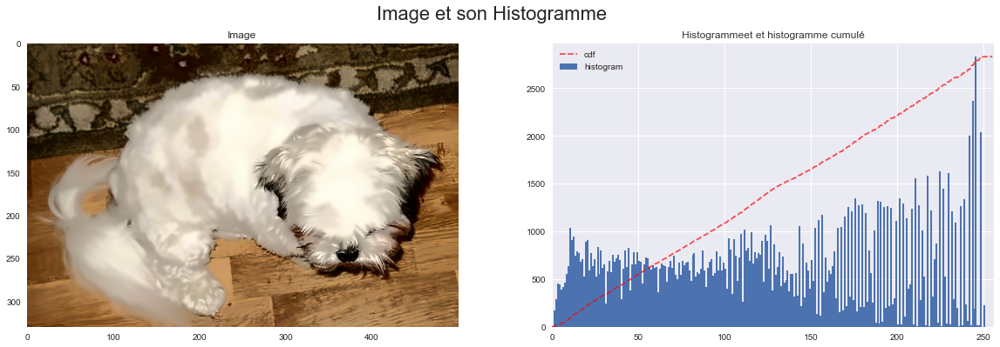

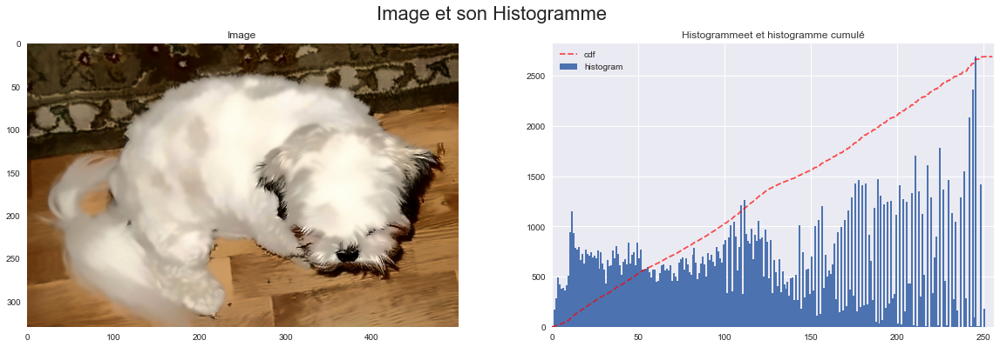

In [60]:
rd = random.randint(0, len(imgs))
rd = 333
print(rd)
plot_histogram(imgs[rd])
plot_histogram(equalize_img(imgs[rd]))

dst_img = cv.fastNlMeansDenoisingColored(
    src=equalize_img(imgs[rd]),
    h=1)
plot_histogram(dst_img)

dst_img = cv.fastNlMeansDenoisingColored(
    src=equalize_img(imgs[rd]),
    h=3)
plot_histogram(dst_img)

dst_img = cv.fastNlMeansDenoisingColored(
    src=equalize_img(imgs[rd]),
    h=6)
plot_histogram(dst_img)

dst_img = cv.fastNlMeansDenoisingColored(
    src=equalize_img(imgs[rd]),
    h=9)
plot_histogram(dst_img)

## Augmentation

In [12]:
x_box = img_process(imgs=imgs, bndbox=bndbox, resolution=200)

In [13]:
rd = random.randint(0, len(x_box))
print(rd)

545


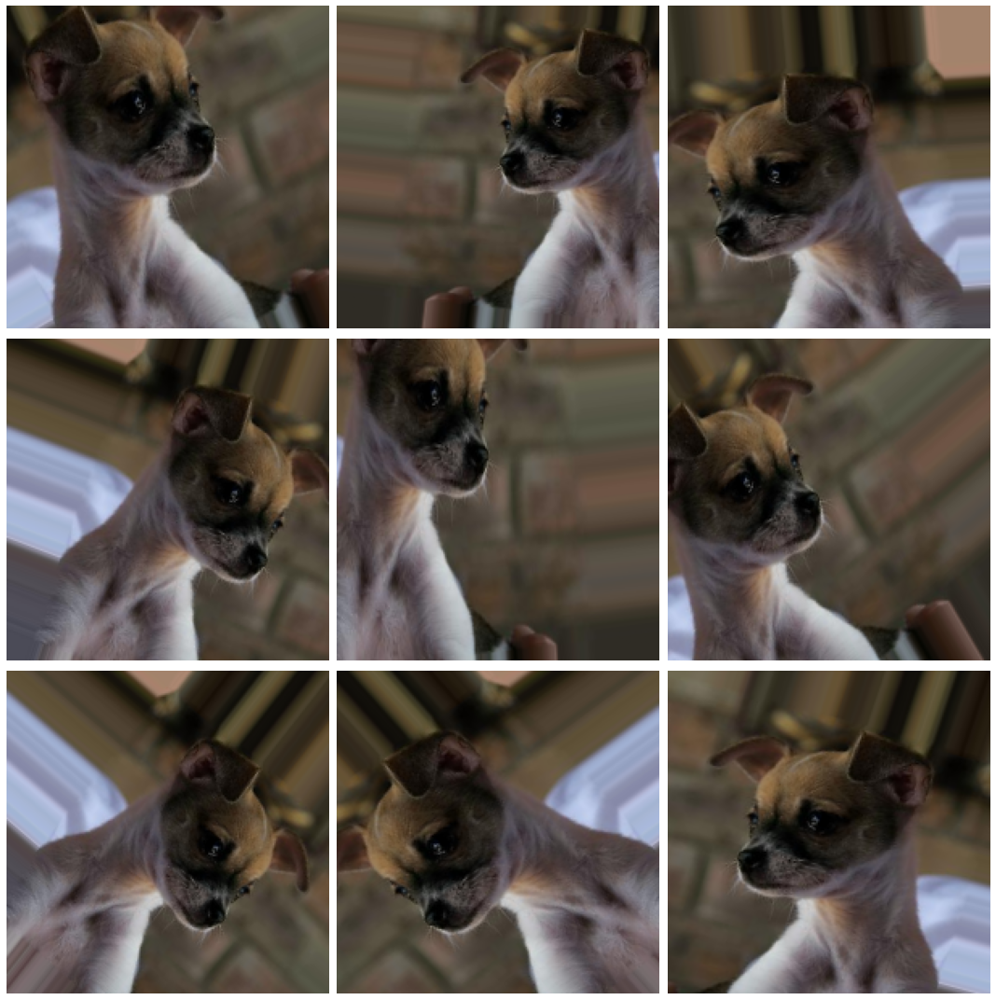

In [14]:
basic = ImageDataGenerator(
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True
    )
plot_aug(basic, 'bright', x_box, 29, 9)

## Recherche du meilleur prétraitement

In [76]:
models_data = ModelCNN(y_train=y_train, y_test=y_test, y_val=y_val, epochs=40)
models_data.add_scoring('accuracy')
models_data.add_scoring(f1_m)

basic_aug = ImageDataGenerator(
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True)
models_data.add_augment('basic_aug', basic_aug)
opt = optimizers.SGD(learning_rate=0.01)
with open('Data/data_search.pkl', 'rb') as handle:
    full_x = pickle.load(handle)
models_data.x = full_x

In [11]:
x_train_resize = img_process(imgs=x_train, resolution=200)
x_test_resize = img_process(imgs=x_test, resolution=200)
x_val_resize = img_process(imgs=x_val, resolution=200)

x_train_box = img_process(imgs=x_train, bndbox=box_train, resolution=200)
x_test_box = img_process(imgs=x_test, bndbox=box_test, resolution=200)
x_val_box = img_process(imgs=x_val, bndbox=box_val, resolution=200)

x_train_box_eq = img_process(imgs=x_train, bndbox=box_train, resolution=200, equalize=True)
x_test_box_eq = img_process(imgs=x_test, bndbox=box_test, resolution=200, equalize=True)
x_val_box_eq = img_process(imgs=x_val, bndbox=box_val, resolution=200, equalize=True)

x_train_box_eq_dn1 = img_process(imgs=x_train, bndbox=box_train, resolution=200, equalize=True, denois=1)
x_test_box_eq_dn1 = img_process(imgs=x_test, bndbox=box_test, resolution=200, equalize=True, denois=1)
x_val_box_eq_dn1 = img_process(imgs=x_val, bndbox=box_val, resolution=200, equalize=True, denois=1)

x_train_box_eq_dn3 = img_process(imgs=x_train, bndbox=box_train, resolution=200, equalize=True, denois=3)
x_test_box_eq_dn3 = img_process(imgs=x_test, bndbox=box_test, resolution=200, equalize=True, denois=3)
x_val_box_eq_dn3 = img_process(imgs=x_val, bndbox=box_val, resolution=200, equalize=True, denois=3)

x_train_box_eq_dn6 = img_process(imgs=x_train, bndbox=box_train, resolution=200, equalize=True, denois=6)
x_test_box_eq_dn6 = img_process(imgs=x_test, bndbox=box_test, resolution=200, equalize=True, denois=6)
x_val_box_eq_dn6 = img_process(imgs=x_val, bndbox=box_val, resolution=200, equalize=True, denois=6)

x_train_box_eq_dn9 = img_process(imgs=x_train, bndbox=box_train, resolution=200, equalize=True, denois=9)
x_test_box_eq_dn9 = img_process(imgs=x_test, bndbox=box_test, resolution=200, equalize=True, denois=9)
x_val_box_eq_dn9 = img_process(imgs=x_val, bndbox=box_val, resolution=200, equalize=True, denois=9)

In [12]:
models_data.add_data('basic', x_train_resize, x_test_resize, x_val_resize)
models_data.add_data('box', x_train_box, x_test_box, x_val_box)
models_data.add_data('box_eq', x_train_box_eq, x_test_box_eq, x_val_box_eq)
models_data.add_data('box_eq_dn1', x_train_box_eq_dn1, x_test_box_eq_dn1, x_val_box_eq_dn1)
models_data.add_data('box_eq_dn3', x_train_box_eq_dn3, x_test_box_eq_dn3, x_val_box_eq_dn3)
models_data.add_data('box_eq_dn6', x_train_box_eq_dn6, x_test_box_eq_dn6, x_val_box_eq_dn6)
models_data.add_data('box_eq_dn9', x_train_box_eq_dn9, x_test_box_eq_dn9, x_val_box_eq_dn9)

In [13]:
with open('Data/data_search.pkl', 'wb') as handle:
    pickle.dump(models_data.x, handle, protocol=pickle.HIGHEST_PROTOCOL)

In [11]:
for name in ['basic', 'box', 'box_eq', 'box_eq_dn1', 'box_eq_dn3', 'box_eq_dn6', 'box_eq_dn9']:
    basic_conv = [
        Rescaling(scale=1./255),
        Conv2D(64, (3,3), activation='relu'),
        MaxPooling2D(2,2),
        Conv2D(128, (3,3), activation='relu'),
        MaxPooling2D(2,2),
        Conv2D(256, (3,3), activation='relu'),
        MaxPooling2D(2,2),
        Flatten(),
        Dense(1024, activation='relu'),
        Dense(num_breeds, activation='softmax')
    ]
    models_data.add_model(name=name, layers=basic_conv, optimizer=opt)
    models_data.fit(model_name=name, data=name, augment='basic_aug')
    models_data.models.loc[name].model = None
    models_data.save_models('Models/search_data_'+name+'.pkl')
    del basic_conv
    models_data.unload_models()

le model basic ajouté
Epoch 1/40
40/40 [==============================] - 31s 640ms/step - loss: 2.3042 - accuracy: 0.1239 - f1_m: 9.3867 - val_loss: 2.2844 - val_accuracy: 0.1255 - val_f1_m: 9.4160
Epoch 2/40
40/40 [==============================] - 13s 330ms/step - loss: 2.2925 - accuracy: 0.1302 - f1_m: 9.3899 - val_loss: 2.2851 - val_accuracy: 0.1412 - val_f1_m: 9.6166
Epoch 3/40
40/40 [==============================] - 13s 317ms/step - loss: 2.2863 - accuracy: 0.1357 - f1_m: 9.4552 - val_loss: 2.2700 - val_accuracy: 0.1373 - val_f1_m: 9.4063
Epoch 4/40
40/40 [==============================] - 12s 308ms/step - loss: 2.2797 - accuracy: 0.1443 - f1_m: 9.4008 - val_loss: 2.2635 - val_accuracy: 0.1373 - val_f1_m: 9.5381
Epoch 5/40
40/40 [==============================] - 12s 308ms/step - loss: 2.2701 - accuracy: 0.1475 - f1_m: 9.2591 - val_loss: 2.2507 - val_accuracy: 0.1765 - val_f1_m: 9.5501
Epoch 6/40
40/40 [==============================] - 12s 299ms/step - loss: 2.2568 - accuracy:

c:\Users\Jayma\.conda\envs\tf\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


données du fichier Models/search_data_box.pkl bien sauvegardé
le model box_eq ajouté
Epoch 1/40
40/40 [==============================] - 12s 289ms/step - loss: 2.3069 - accuracy: 0.1200 - f1_m: 9.1969 - val_loss: 2.2822 - val_accuracy: 0.1216 - val_f1_m: 9.5749
Epoch 2/40
40/40 [==============================] - 11s 281ms/step - loss: 2.2877 - accuracy: 0.1451 - f1_m: 9.4156 - val_loss: 2.2765 - val_accuracy: 0.1608 - val_f1_m: 9.5671
Epoch 3/40
40/40 [==============================] - 12s 285ms/step - loss: 2.2823 - accuracy: 0.1451 - f1_m: 9.4100 - val_loss: 2.2529 - val_accuracy: 0.1647 - val_f1_m: 9.4491
Epoch 4/40
40/40 [==============================] - 11s 283ms/step - loss: 2.2645 - accuracy: 0.1584 - f1_m: 9.3544 - val_loss: 2.2517 - val_accuracy: 0.2000 - val_f1_m: 9.2013
Epoch 5/40
40/40 [==============================] - 12s 284ms/step - loss: 2.2443 - accuracy: 0.1749 - f1_m: 9.0651 - val_loss: 2.2224 - val_accuracy: 0.1294 - val_f1_m: 8.7022
Epoch 6/40
40/40 [============

c:\Users\Jayma\.conda\envs\tf\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


données du fichier Models/search_data_box_eq.pkl bien sauvegardé
le model box_eq_dn1 ajouté
Epoch 1/40
40/40 [==============================] - 13s 295ms/step - loss: 2.3085 - accuracy: 0.1153 - f1_m: 9.3093 - val_loss: 2.2841 - val_accuracy: 0.1412 - val_f1_m: 9.3114
Epoch 2/40
40/40 [==============================] - 11s 284ms/step - loss: 2.2944 - accuracy: 0.1341 - f1_m: 9.4168 - val_loss: 2.2722 - val_accuracy: 0.1412 - val_f1_m: 9.4806
Epoch 3/40
40/40 [==============================] - 12s 285ms/step - loss: 2.2828 - accuracy: 0.1490 - f1_m: 9.3959 - val_loss: 2.2606 - val_accuracy: 0.1725 - val_f1_m: 9.5959
Epoch 4/40
40/40 [==============================] - 12s 285ms/step - loss: 2.2702 - accuracy: 0.1482 - f1_m: 9.3112 - val_loss: 2.2441 - val_accuracy: 0.1333 - val_f1_m: 9.1804
Epoch 5/40
40/40 [==============================] - 12s 289ms/step - loss: 2.2599 - accuracy: 0.1529 - f1_m: 9.1225 - val_loss: 2.2295 - val_accuracy: 0.1922 - val_f1_m: 9.3192
Epoch 6/40
40/40 [=====

In [12]:
models_data.save_models('Models/search_data.pkl')
del models_data

données du fichier Models/search_data.pkl bien sauvegardé


In [77]:
models_data.load_models('Models/search_data.pkl')

données du fichier Models/search_data.pkl bien chargé


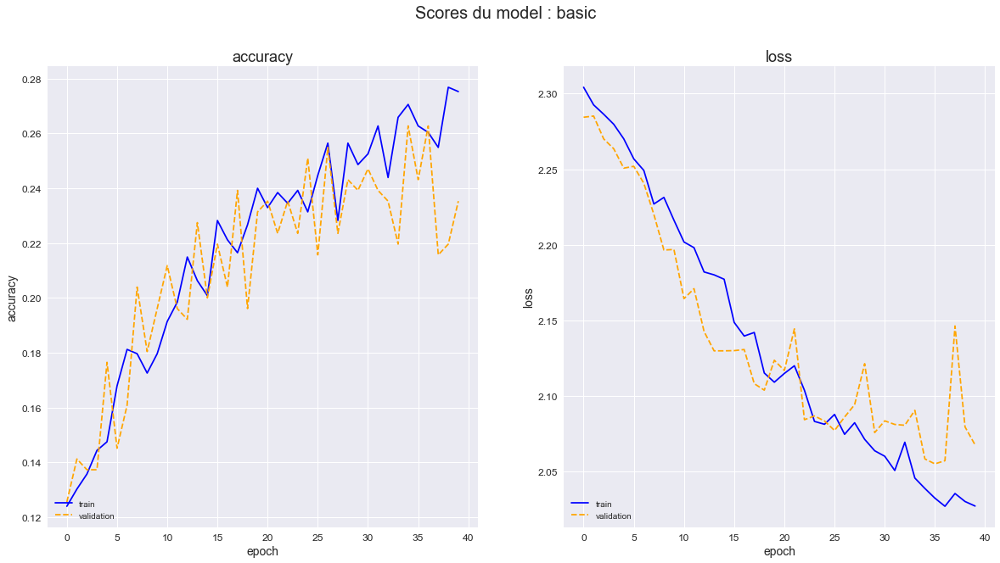

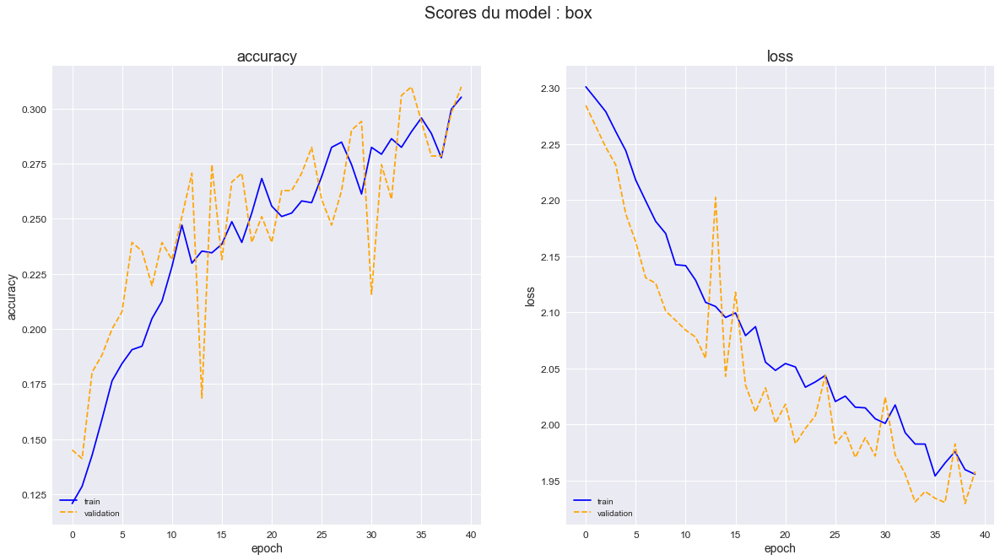

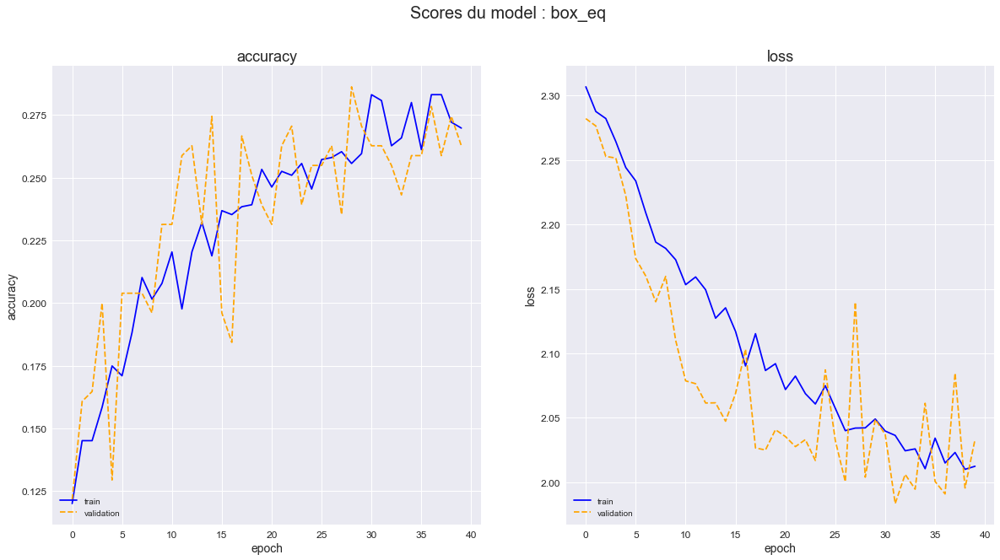

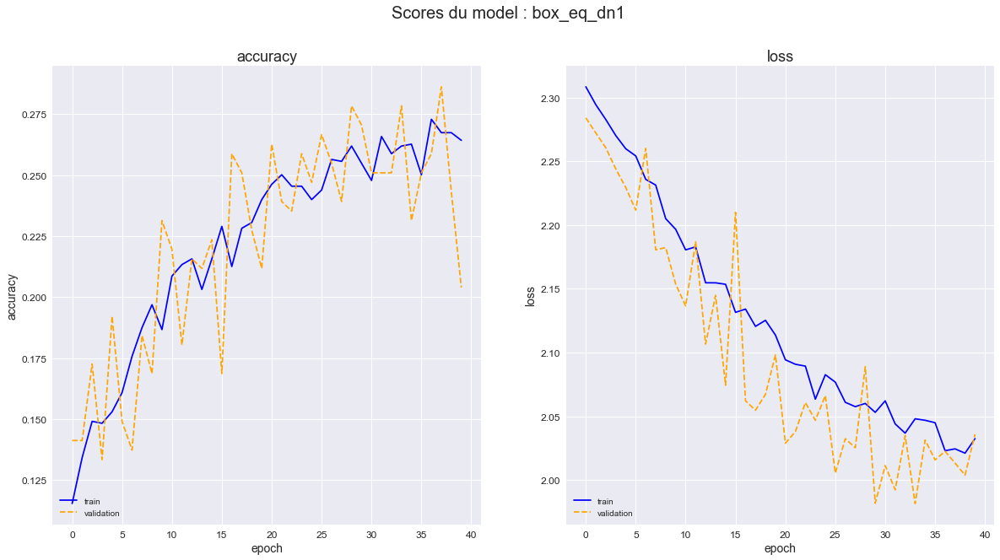

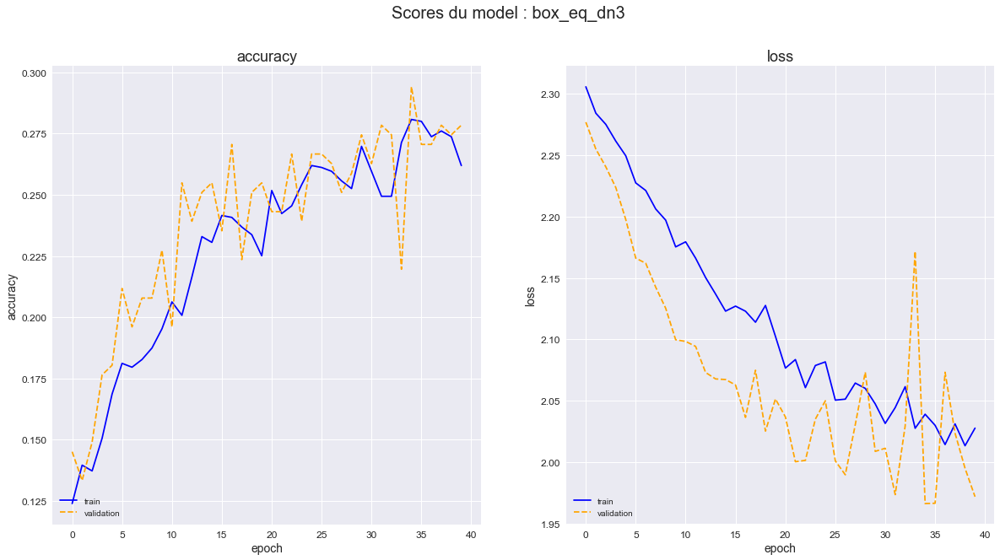

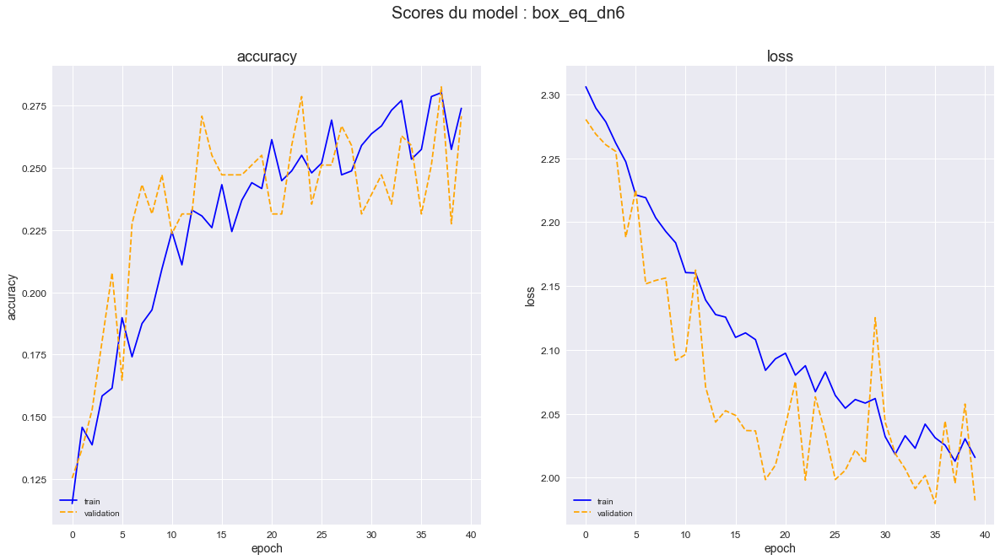

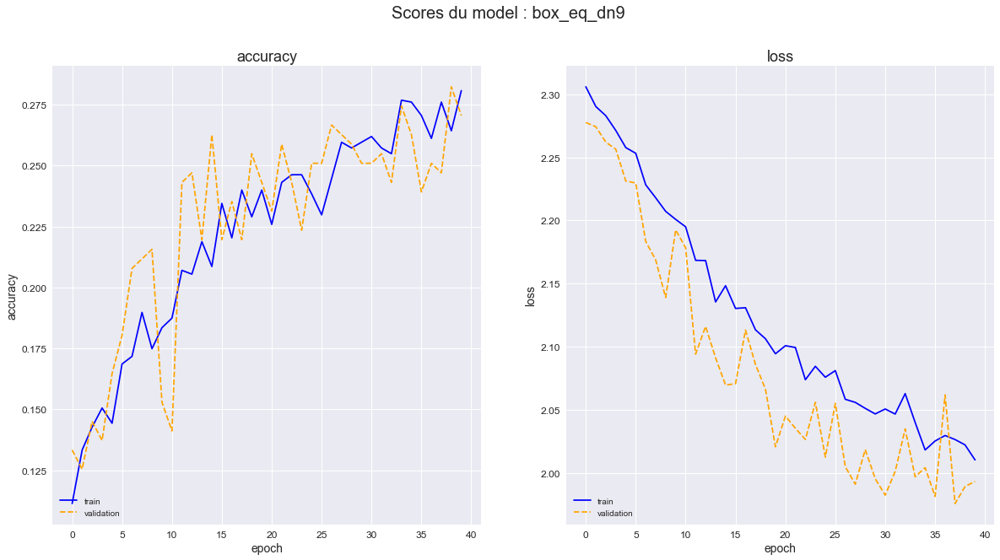

In [78]:
models_data.plot_history_scores(metric_list=['accuracy'])

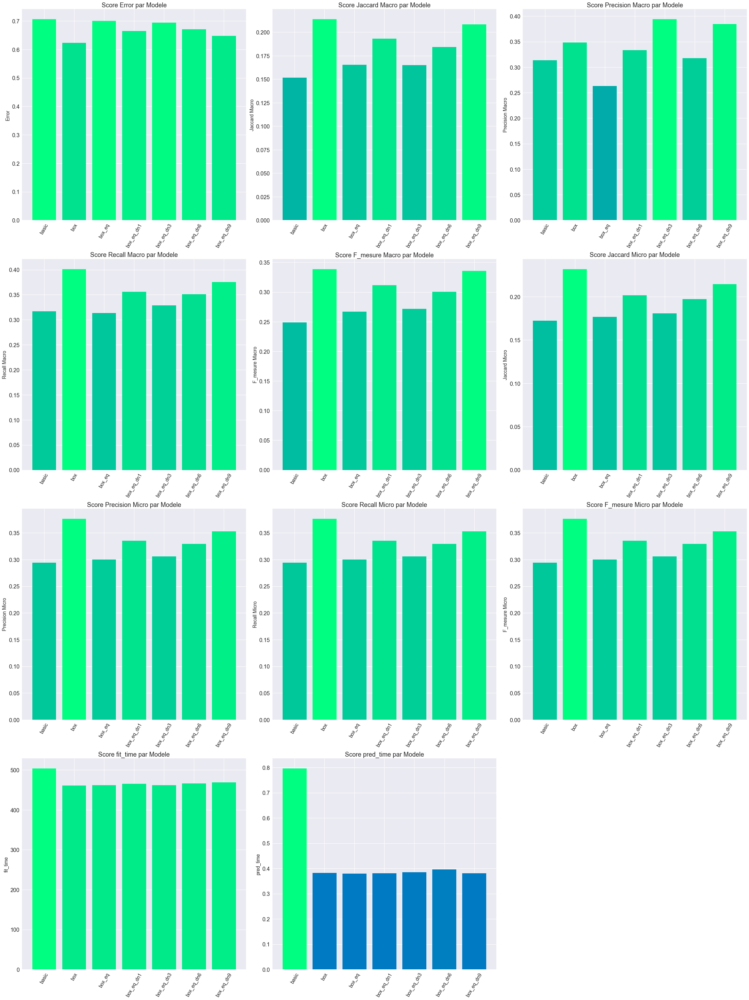

In [22]:
models_data.plot_perf()

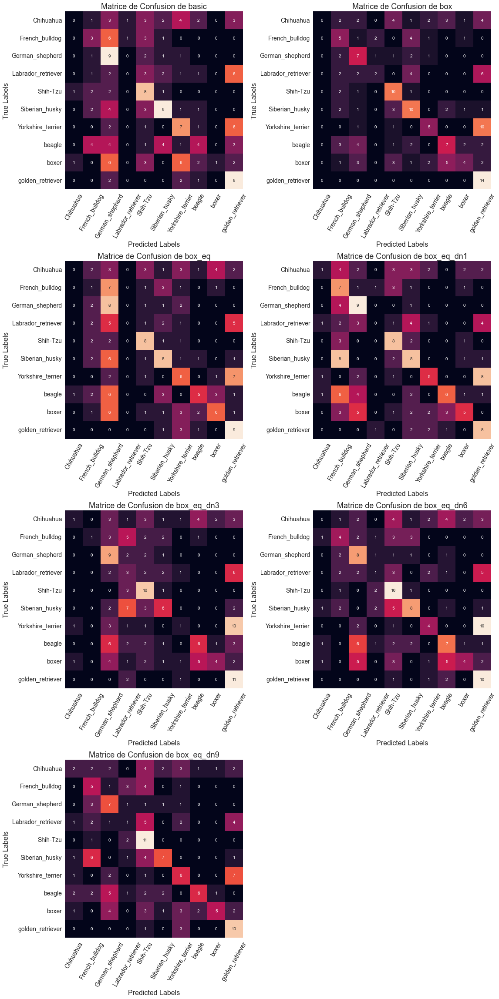

In [23]:
models_data.plot_confmat()

## Recherche du meilleur augmentateur

In [16]:
models_aug = ModelCNN(y_train=y_train, y_test=y_test, y_val=y_val, epochs=100)
models_aug.add_scoring('accuracy')
models_aug.add_scoring(f1_m)

x_train_box = img_process(imgs=x_train, bndbox=box_train, resolution=200)
x_test_box = img_process(imgs=x_test, bndbox=box_test, resolution=200)
x_val_box = img_process(imgs=x_val, bndbox=box_val, resolution=200)
models_aug.add_data('box', x_train_box, x_test_box, x_val_box)

opt = optimizers.SGD(learning_rate=0.01)

In [15]:
nothing = ImageDataGenerator()
basic = ImageDataGenerator(
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True)
bright = ImageDataGenerator(
    brightness_range=(0.5, 1.5),
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True)
bright_strong = ImageDataGenerator(
    brightness_range=(0.25, 2),
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True)
chan_shift = ImageDataGenerator(
    channel_shift_range=80,
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True)
full = ImageDataGenerator(
    brightness_range=(0.5, 1.5),
    channel_shift_range=80,
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True)

models_aug.add_augment('nothing', nothing)
models_aug.add_augment('basic', basic)
models_aug.add_augment('bright', bright)
models_aug.add_augment('bright_strong', bright_strong)
models_aug.add_augment('chan_shift', chan_shift)
models_aug.add_augment('full', full)

In [ ]:
for name in ['nothing', 'basic', 'bright', 'bright_strong', 'chan_shift', 'full']:
    basic_conv = [
        Rescaling(scale=1./255),
        Conv2D(64, (3,3), activation='relu'),
        MaxPooling2D(2,2),
        Conv2D(128, (3,3), activation='relu'),
        MaxPooling2D(2,2),
        Conv2D(256, (3,3), activation='relu'),
        MaxPooling2D(2,2),
        Flatten(),
        Dense(1024, activation='relu'),
        Dense(num_breeds, activation='softmax')
    ]
    model_conv = Sequential(basic_conv)
    models_aug.add_model(name=name, model=model_conv, optimizer=opt)
    models_aug.fit(model_name=name, data='box', augment=name)
    models_aug.models.loc[name].model = None
    models_aug.save_models('Models/search_aug_'+name+'.pkl')
    del basic_conv, model_conv
    models_aug.unload_models()

In [12]:
models_aug.save_models('Models/search_aug.pkl')
del models_aug

données du fichier Models/search_aug.pkl bien sauvegardé


In [17]:
models_aug.load_models('Models/search_aug.pkl')

données du fichier Models/search_aug.pkl bien chargé


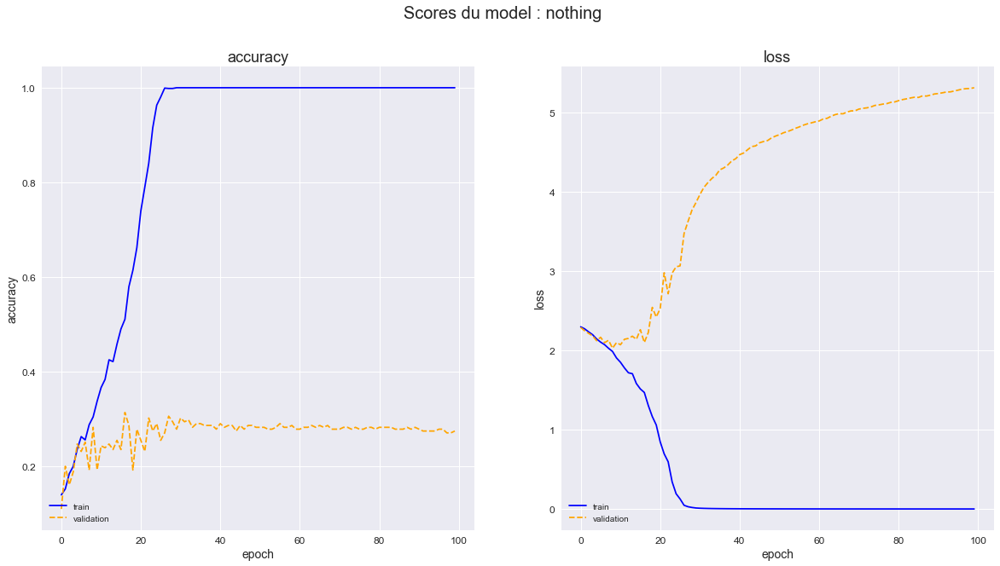

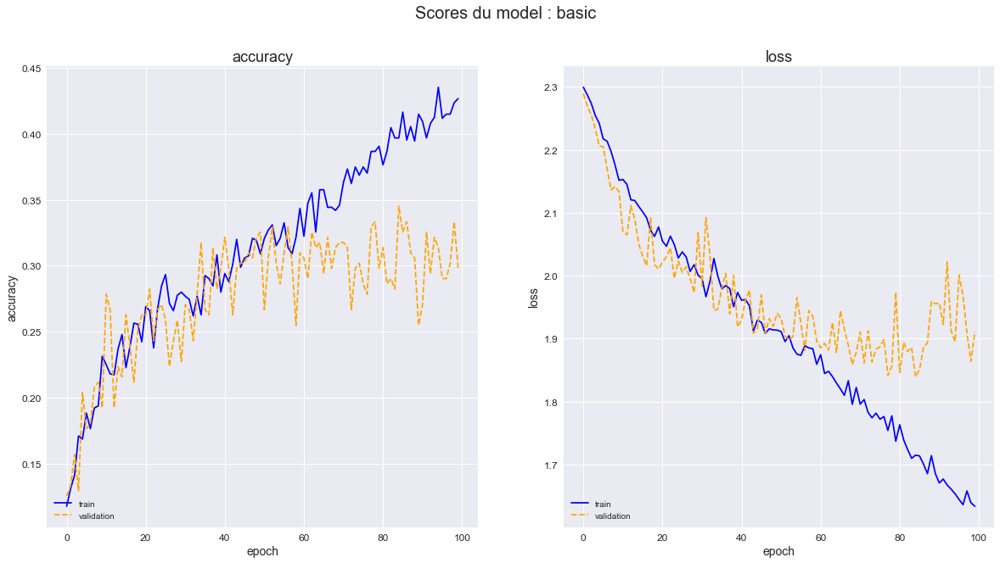

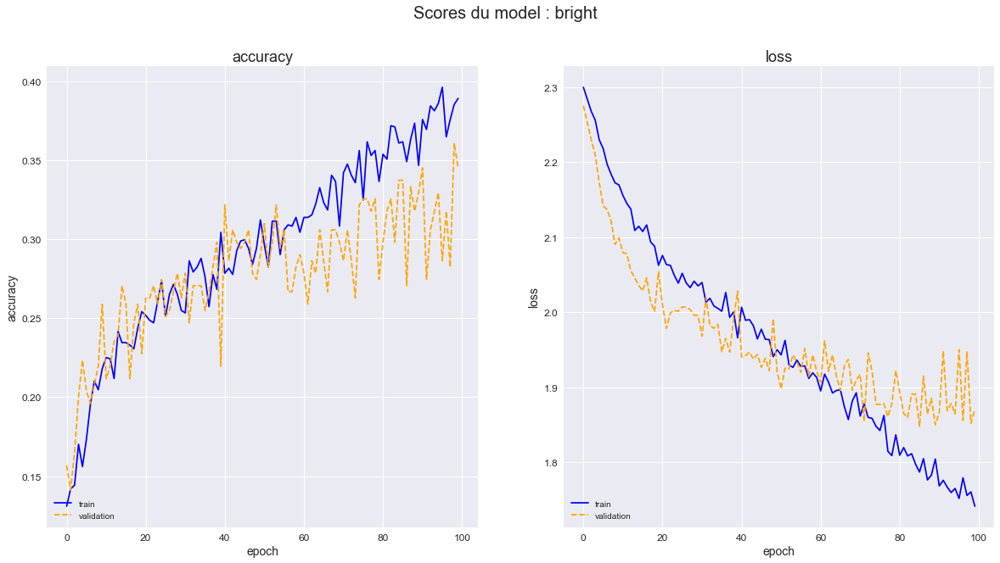

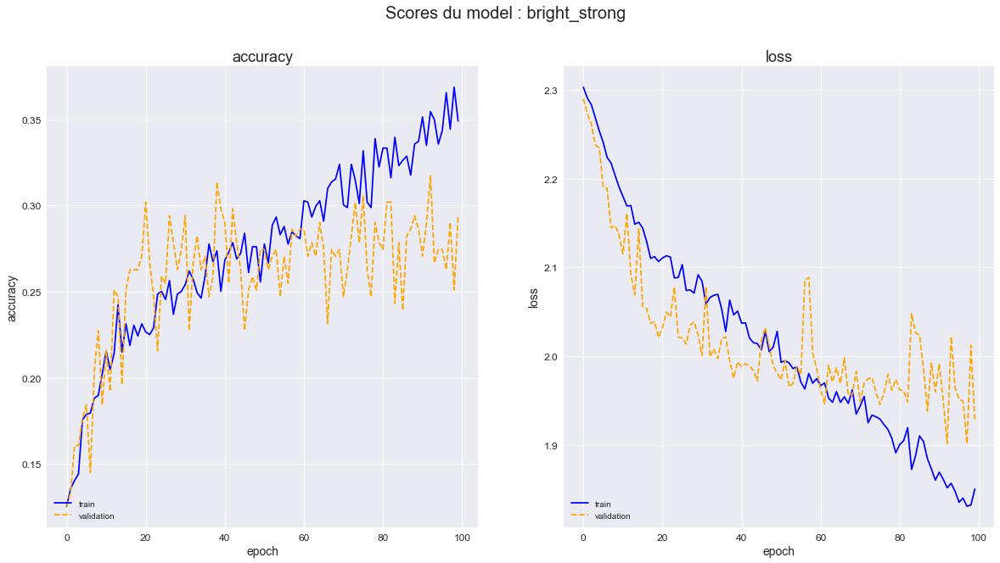

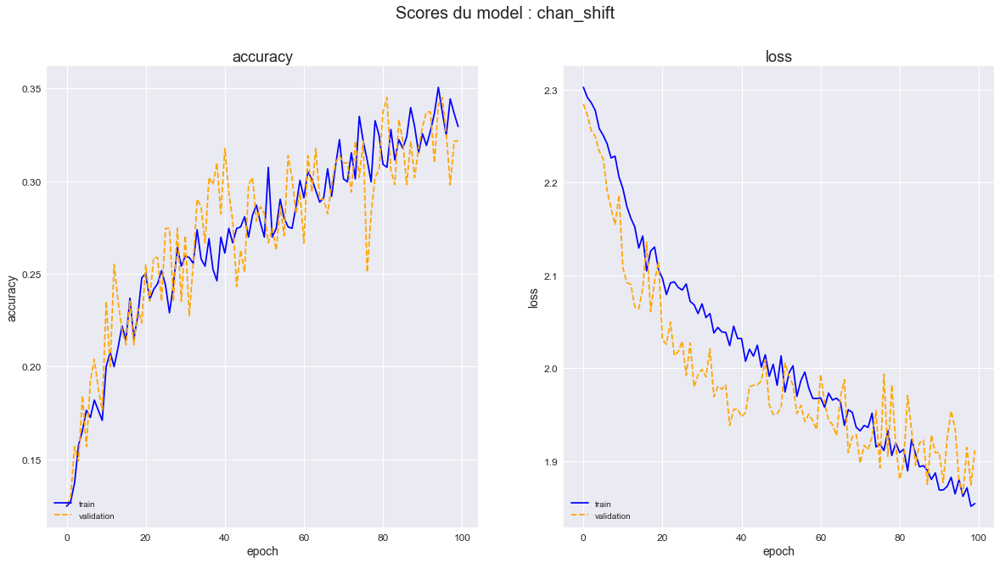

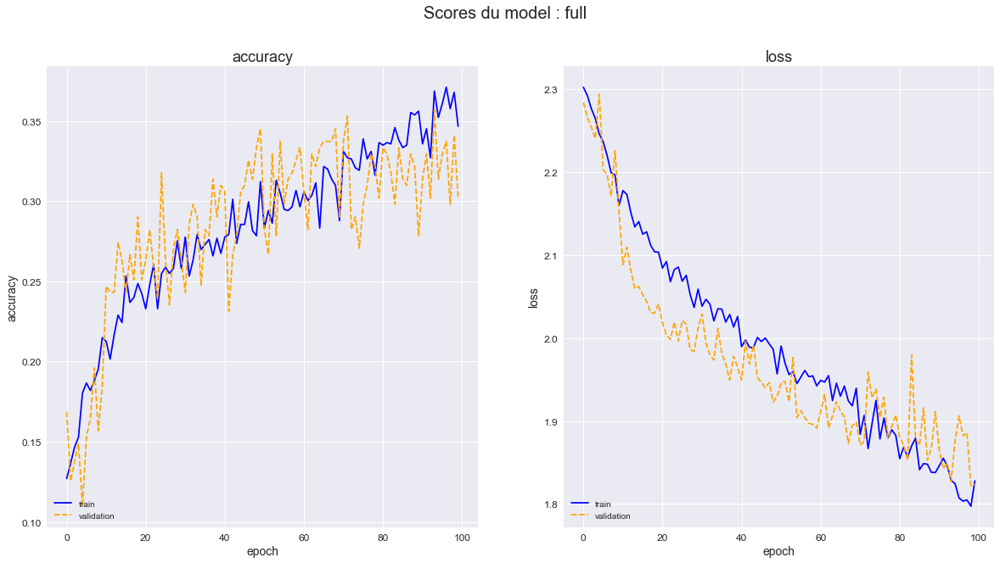

In [18]:
models_aug.plot_history_scores(metric_list=['accuracy'])

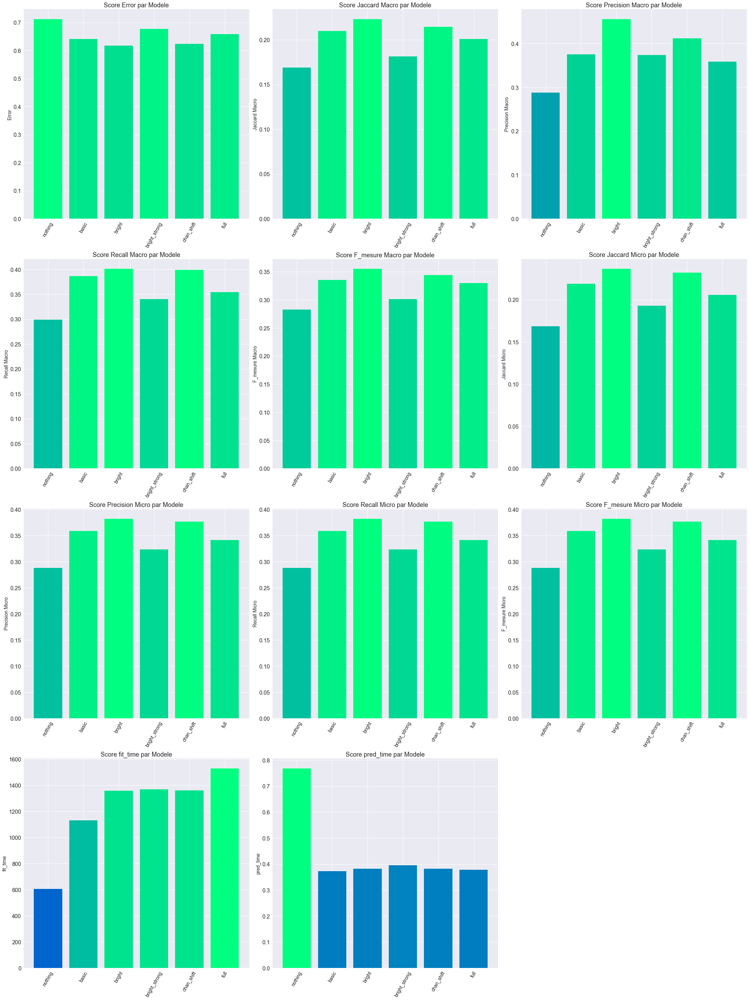

In [19]:
models_aug.plot_perf()

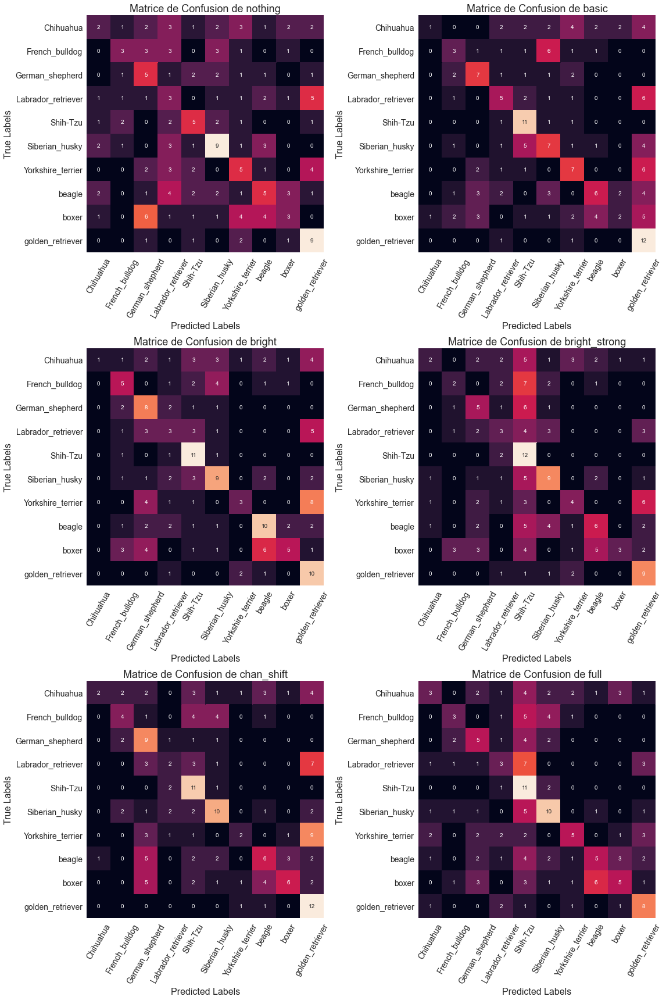

In [20]:
models_aug.plot_confmat()

## Recherche du meilleur modèle

In [16]:
models_find = ModelCNN(y_train=y_train, y_test=y_test, y_val=y_val, epochs=100)
models_find.add_scoring('accuracy')
models_find.add_scoring(f1_m)

x_train_box = img_process(imgs=x_train, bndbox=box_train, resolution=200)
x_test_box = img_process(imgs=x_test, bndbox=box_test, resolution=200)
x_val_box = img_process(imgs=x_val, bndbox=box_val, resolution=200)
models_find.add_data('box', x_train_box, x_test_box, x_val_box)

opt = optimizers.SGD(learning_rate=0.01)

bright = ImageDataGenerator(
    brightness_range=(0.5, 1.5),
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True)
models_find.add_augment('bright', bright)

In [14]:
models_list = [
    {
        'name': '2conv',
        'layers': [
            Rescaling(scale=1./255, input_shape=(200, 200, 3)),
            Conv2D(filters=16, kernel_size=(3,3), padding='same', use_bias=False),
            BatchNormalization(axis=3, scale=False),
            Activation('relu'),
            MaxPooling2D(pool_size=(4, 4), strides=(4, 4), padding='same'),
            Conv2D(filters=32, kernel_size=(3,3), padding='same', use_bias=False),
            BatchNormalization(axis=3, scale=False),
            Activation('relu'),
            GlobalAveragePooling2D(),
            Dense(128, activation='relu'),
            Dense(num_breeds, activation='softmax')
        ]
    }, {
        'name': '3conv',
        'layers': [
            Rescaling(scale=1./255, input_shape=(200, 200, 3)),
            Conv2D(64, (3,3), activation='relu'),
            MaxPooling2D(2,2),
            Conv2D(128, (3,3), activation='relu'),
            MaxPooling2D(2,2),
            Conv2D(256, (3,3), activation='relu'),
            MaxPooling2D(2,2),
            Flatten(),
            Dense(1024, activation='relu'),
            Dense(num_breeds, activation='softmax')
        ]
    }, {
        'name': '4conv',
        'layers': [
            Rescaling(scale=1./255, input_shape=(200, 200, 3)),
            Conv2D(filters=96,kernel_size=(11,11),strides=(4,4),padding="valid",activation="relu"),
            MaxPooling2D(pool_size=(3,3),strides=(2,2)),
            BatchNormalization(),
            Conv2D(filters=256,kernel_size=(5,5),strides=(1,1),padding="valid",activation="relu"),
            MaxPooling2D(pool_size=(3,3),strides=(2,2)),
            BatchNormalization(),
            Conv2D(filters=384,kernel_size=(3,3),strides=(1,1),padding="valid",activation="relu"),
            Conv2D(filters=384,kernel_size=(3,3),strides=(1,1),padding="valid",activation="relu"),
            Conv2D(filters=256,kernel_size=(3,3),strides=(1,1),padding="valid",activation="relu"),
            MaxPooling2D(pool_size=(3,3),strides=(2,2)),
            BatchNormalization(),
            Flatten(),
            Dense(4096,activation="relu"),
            Dropout(0.4),
            BatchNormalization(),
            Dense(4096,activation="relu"),
            Dropout(0.4),
            BatchNormalization(),
            Dense(1000,activation="relu"),
            Dropout(0.4),
            BatchNormalization(),
            Dense(num_breeds, activation="softmax"),
        ]
    }, {
        'name': '5conv',
        'layers': [
            Rescaling(scale=1./255, input_shape=(200, 200, 3)),
            Conv2D(32, (3, 3), padding='same'),
            Activation('relu'),
            Conv2D(32, (3, 3)),
            Activation('relu'),
            MaxPooling2D(pool_size=(2, 2)),
            Dropout(0.25),
            Conv2D(64, (3, 3), padding='same'),
            Activation('relu'),
            Conv2D(64, (3, 3)),
            Activation('relu'),
            MaxPooling2D(pool_size=(2, 2)),
            Dropout(0.25),
            Flatten(),
            Dense(512),
            Activation('relu'),
            Dropout(0.5),
            Dense(num_breeds, activation='softmax')
        ]
    }, {
        'name': '8conv',
        'layers': [
            Rescaling(scale=1./255, input_shape=(200, 200, 3)),
            Conv2D(filters=32, kernel_size=(3,3), padding='same', activation='relu'),
            Conv2D(32, (3,3), activation='relu'),
            MaxPooling2D((2,2)),  # Pooling
            Dropout(0.2), # Dropout
            Conv2D(64, (3,3), padding='same', activation='relu'),
            Conv2D(64, (3,3), activation='relu'),
            MaxPooling2D((2,2)),
            Dropout(0.2),
            Conv2D(128, (3,3), padding='same', activation='relu'),
            Conv2D(128, (3,3), activation='relu'),
            Activation('relu'),
            MaxPooling2D((2,2)),
            Dropout(0.2),
            Conv2D(512, (5,5), padding='same', activation='relu'),
            Conv2D(512, (5,5), activation='relu'),
            MaxPooling2D((4,4)),
            Dropout(0.2),
            Flatten(),
            Dense(1024, activation='relu'),
            Dropout(0.2),
            Dense(num_breeds, activation='softmax')
        ]
    }
]


In [23]:
for i, model in enumerate(models_list):
    mod = Sequential(model['layers'])
    

In [15]:
for i, model in enumerate(models_list):
    models_find.add_model(name=model['name'], layers=model['layers'], optimizer=opt)
    models_find.fit(model_name=model['name'], data='box', augment='bright')
    models_find.save_models('Models/search_model_'+model['name']+'.pkl')
    models_find.unload_models()

le model basic_2conv ajouté
Epoch 1/100
40/40 [==============================] - 14s 340ms/step - loss: 2.3023 - accuracy: 0.1208 - f1_m: 9.2795 - val_loss: 2.3027 - val_accuracy: 0.0941 - val_f1_m: 9.8499
Epoch 2/100
40/40 [==============================] - 14s 347ms/step - loss: 2.2821 - accuracy: 0.1569 - f1_m: 9.3296 - val_loss: 2.2962 - val_accuracy: 0.1412 - val_f1_m: 9.6141
Epoch 3/100
40/40 [==============================] - 14s 361ms/step - loss: 2.2697 - accuracy: 0.1631 - f1_m: 9.2709 - val_loss: 2.2916 - val_accuracy: 0.1333 - val_f1_m: 9.2234
Epoch 4/100
40/40 [==============================] - 15s 381ms/step - loss: 2.2645 - accuracy: 0.1608 - f1_m: 9.2906 - val_loss: 2.2879 - val_accuracy: 0.1412 - val_f1_m: 9.3526
Epoch 5/100
40/40 [==============================] - 22s 549ms/step - loss: 2.2585 - accuracy: 0.1686 - f1_m: 9.1890 - val_loss: 2.2839 - val_accuracy: 0.1294 - val_f1_m: 9.5095
Epoch 6/100
40/40 [==============================] - 29s 719ms/step - loss: 2.2525

c:\Users\Jayma\.conda\envs\tf\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


données du fichier Models/search_model_basic_2conv.pkl bien sauvegardé
le model basic_3conv ajouté
Epoch 1/100
40/40 [==============================] - 15s 350ms/step - loss: 2.2983 - accuracy: 0.1294 - f1_m: 9.3617 - val_loss: 2.2848 - val_accuracy: 0.1255 - val_f1_m: 9.6675
Epoch 2/100
40/40 [==============================] - 14s 340ms/step - loss: 2.2869 - accuracy: 0.1420 - f1_m: 9.4715 - val_loss: 2.2679 - val_accuracy: 0.1255 - val_f1_m: 9.5698
Epoch 3/100
40/40 [==============================] - 14s 341ms/step - loss: 2.2771 - accuracy: 0.1553 - f1_m: 9.4142 - val_loss: 2.2598 - val_accuracy: 0.1216 - val_f1_m: 9.5990
Epoch 4/100
40/40 [==============================] - 14s 340ms/step - loss: 2.2627 - accuracy: 0.1553 - f1_m: 9.3588 - val_loss: 2.2647 - val_accuracy: 0.1255 - val_f1_m: 9.3504
Epoch 5/100
40/40 [==============================] - 14s 340ms/step - loss: 2.2442 - accuracy: 0.1694 - f1_m: 9.1680 - val_loss: 2.2140 - val_accuracy: 0.1843 - val_f1_m: 9.1528
Epoch 6/100

In [16]:
models_find.add_model(name='very_deep_cnn', model=make_model(input_shape=x_train_box[0].shape, num_classes=10), optimizer=opt)

le model very_deep_cnn ajouté


In [17]:
models_find.add_model(name='very_deep_cnn', model=make_model(input_shape=x_train_box[0].shape, num_classes=10), optimizer=opt)
models_find.fit(model_name='very_deep_cnn', data='box', augment='bright')
models_find.save_models('Models/search_model_very_deep_cnn.pkl')
models_find.unload_models()

le model very_deep_cnn ajouté
Epoch 1/100
40/40 [==============================] - 62s 1s/step - loss: 2.4142 - accuracy: 0.1255 - f1_m: 7.1297 - val_loss: 2.3015 - val_accuracy: 0.1255 - val_f1_m: 9.9624
Epoch 2/100
40/40 [==============================] - 19s 458ms/step - loss: 2.3357 - accuracy: 0.1569 - f1_m: 7.0067 - val_loss: 2.3014 - val_accuracy: 0.1255 - val_f1_m: 9.9796
Epoch 3/100
40/40 [==============================] - 18s 447ms/step - loss: 2.3142 - accuracy: 0.1929 - f1_m: 6.9123 - val_loss: 2.3005 - val_accuracy: 0.0863 - val_f1_m: 9.9796
Epoch 4/100
40/40 [==============================] - 25s 609ms/step - loss: 2.2540 - accuracy: 0.1875 - f1_m: 6.6890 - val_loss: 2.2991 - val_accuracy: 0.1255 - val_f1_m: 9.7192
Epoch 5/100
40/40 [==============================] - 46s 1s/step - loss: 2.2396 - accuracy: 0.1867 - f1_m: 6.8070 - val_loss: 2.2995 - val_accuracy: 0.1255 - val_f1_m: 9.7192
Epoch 6/100
40/40 [==============================] - 26s 642ms/step - loss: 2.2352 - a

In [18]:
models_list_250 = [
    {
        'name': '3conv',
        'layers': [
            Rescaling(scale=1./255),
            Conv2D(64, (3,3), activation='relu'),
            MaxPooling2D(2,2),
            Conv2D(128, (3,3), activation='relu'),
            MaxPooling2D(2,2),
            Conv2D(256, (3,3), activation='relu'),
            MaxPooling2D(2,2),
            Flatten(),
            Dense(1024, activation='relu'),
            Dense(num_breeds, activation='softmax')
        ]
    }, {
        'name': '5conv',
        'layers': [
            Rescaling(scale=1./255),
            Conv2D(32, (3, 3), padding='same'),
            Activation('relu'),
            Conv2D(32, (3, 3)),
            Activation('relu'),
            MaxPooling2D(pool_size=(2, 2)),
            Dropout(0.25),
            Conv2D(64, (3, 3), padding='same'),
            Activation('relu'),
            Conv2D(64, (3, 3)),
            Activation('relu'),
            MaxPooling2D(pool_size=(2, 2)),
            Dropout(0.25),
            Flatten(),
            Dense(512),
            Activation('relu'),
            Dropout(0.5),
            Dense(num_breeds, activation='softmax')
        ]
    }, {
        'name': '8conv',
        'layers': [
            Rescaling(scale=1./255),
            Conv2D(filters=32, kernel_size=(3,3), padding='same', activation='relu'),
            Conv2D(32, (3,3), activation='relu'),
            MaxPooling2D((2,2)),  # Pooling
            Dropout(0.2), # Dropout
            Conv2D(64, (3,3), padding='same', activation='relu'),
            Conv2D(64, (3,3), activation='relu'),
            MaxPooling2D((2,2)),
            Dropout(0.2),
            Conv2D(128, (3,3), padding='same', activation='relu'),
            Conv2D(128, (3,3), activation='relu'),
            Activation('relu'),
            MaxPooling2D((2,2)),
            Dropout(0.2),
            Conv2D(512, (5,5), padding='same', activation='relu'),
            Conv2D(512, (5,5), activation='relu'),
            MaxPooling2D((4,4)),
            Dropout(0.2),
            Flatten(),
            Dense(1024, activation='relu'),
            Dropout(0.2),
            Dense(num_breeds, activation='softmax')
        ]
    }
]

In [19]:
models_find.epochs = 250
for i, model in enumerate(models_list_250):
    models_find.add_model(name=model['name']+ '_250', layers=model['layers'], optimizer=opt)
    del models_list[i]['layers']
    models_find.fit(model_name=model['name']+ '_250', data='box', augment='bright')
    models_find.save_models('Models/search_model_'+model['name']+'_250.pkl')
    models_find.unload_models()

le model basic_3conv_250 ajouté
Epoch 1/250
40/40 [==============================] - 15s 343ms/step - loss: 2.2987 - accuracy: 0.1192 - f1_m: 9.4004 - val_loss: 2.2798 - val_accuracy: 0.1255 - val_f1_m: 9.6135
Epoch 2/250
40/40 [==============================] - 13s 333ms/step - loss: 2.2867 - accuracy: 0.1333 - f1_m: 9.4510 - val_loss: 2.2697 - val_accuracy: 0.1216 - val_f1_m: 9.5404
Epoch 3/250
40/40 [==============================] - 14s 337ms/step - loss: 2.2794 - accuracy: 0.1443 - f1_m: 9.4126 - val_loss: 2.2586 - val_accuracy: 0.1882 - val_f1_m: 9.6309
Epoch 4/250
40/40 [==============================] - 14s 349ms/step - loss: 2.2687 - accuracy: 0.1710 - f1_m: 9.3179 - val_loss: 2.2411 - val_accuracy: 0.2118 - val_f1_m: 9.3544
Epoch 5/250
40/40 [==============================] - 14s 344ms/step - loss: 2.2571 - accuracy: 0.1851 - f1_m: 9.2608 - val_loss: 2.2139 - val_accuracy: 0.1725 - val_f1_m: 9.4466
Epoch 6/250
40/40 [==============================] - 14s 341ms/step - loss: 2.

In [31]:
models_find.save_models('Models/search_model.pkl')
del models_find

données du fichier Models/search_model.pkl bien sauvegardé


In [33]:
models_find.load_models('Models/search_model.pkl')

données du fichier Models/search_model.pkl bien chargé


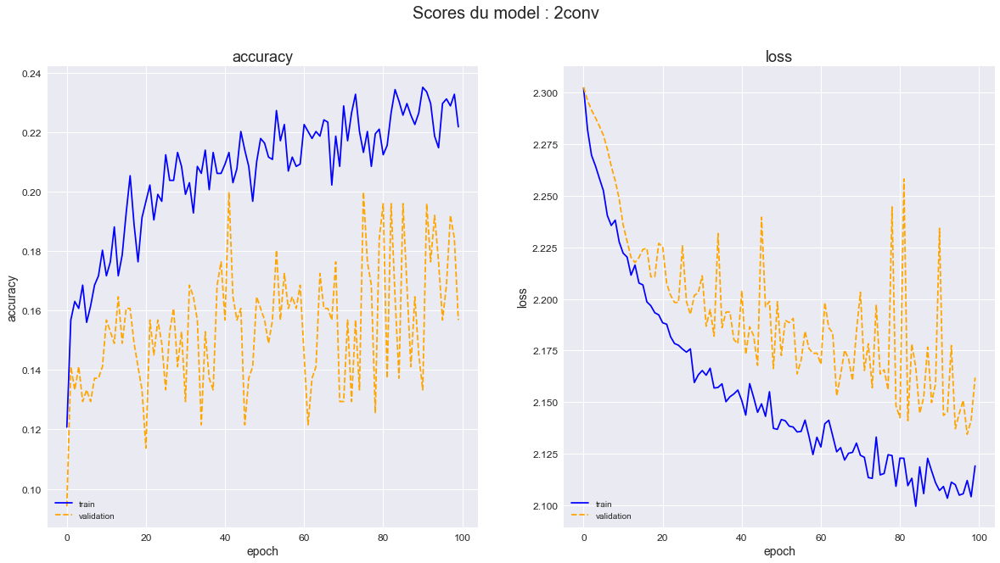

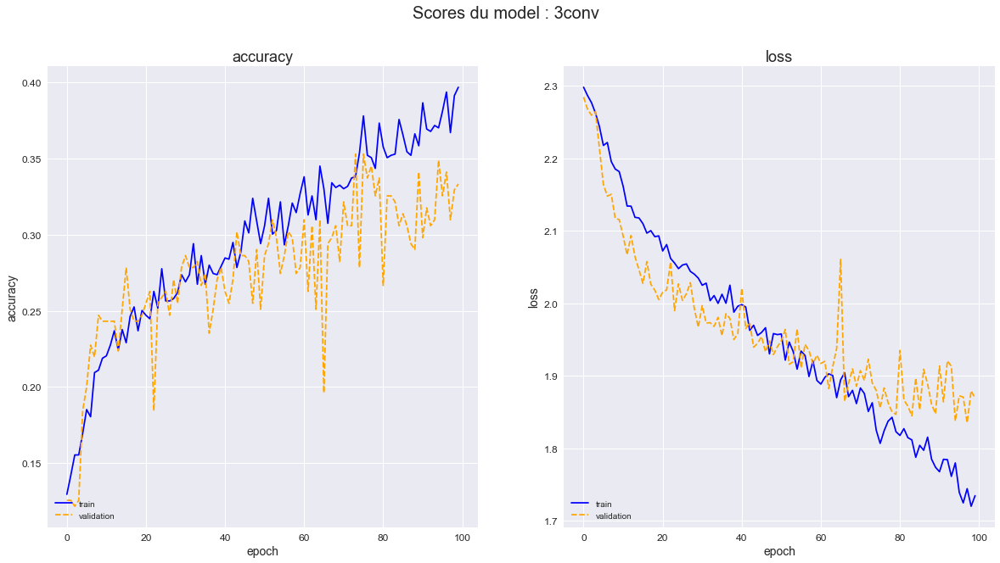

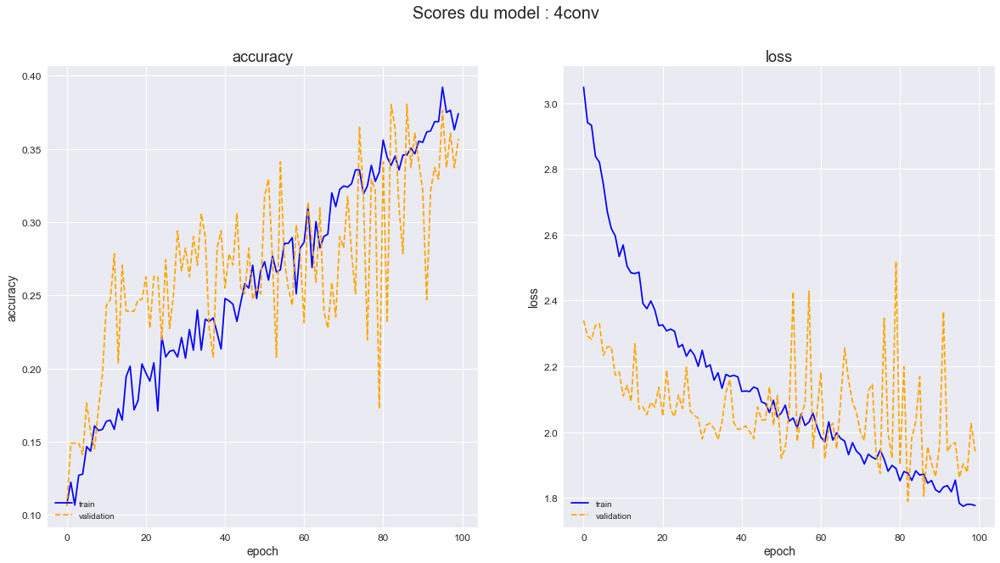

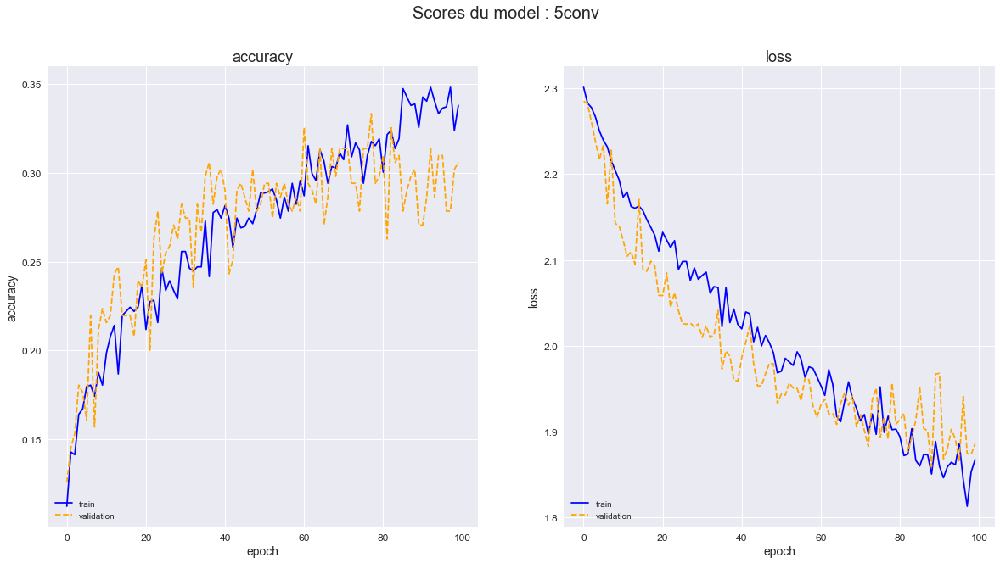

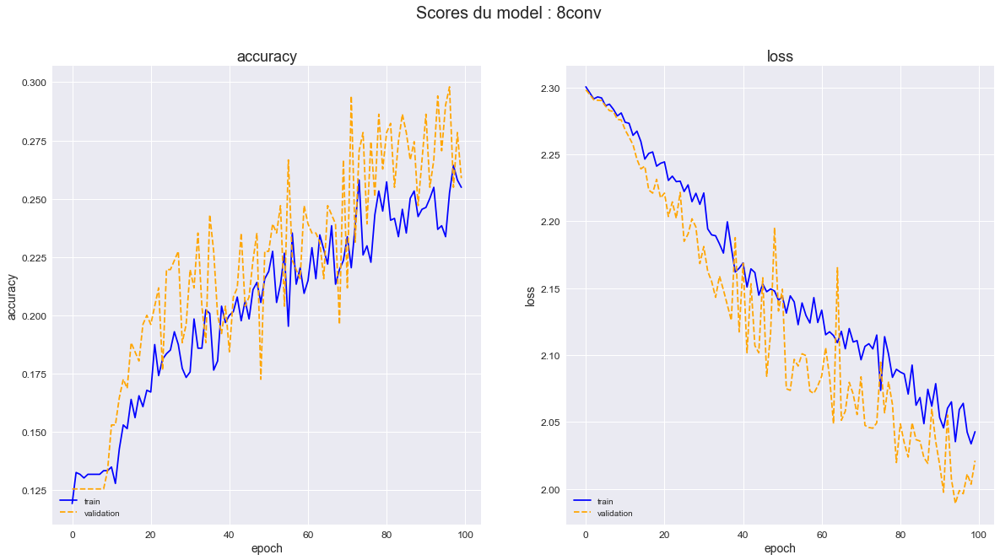

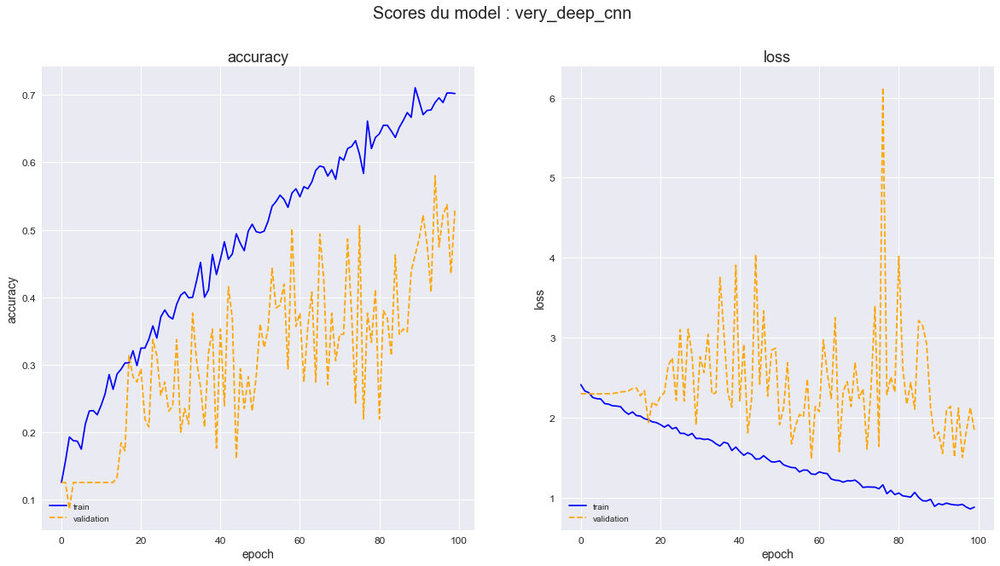

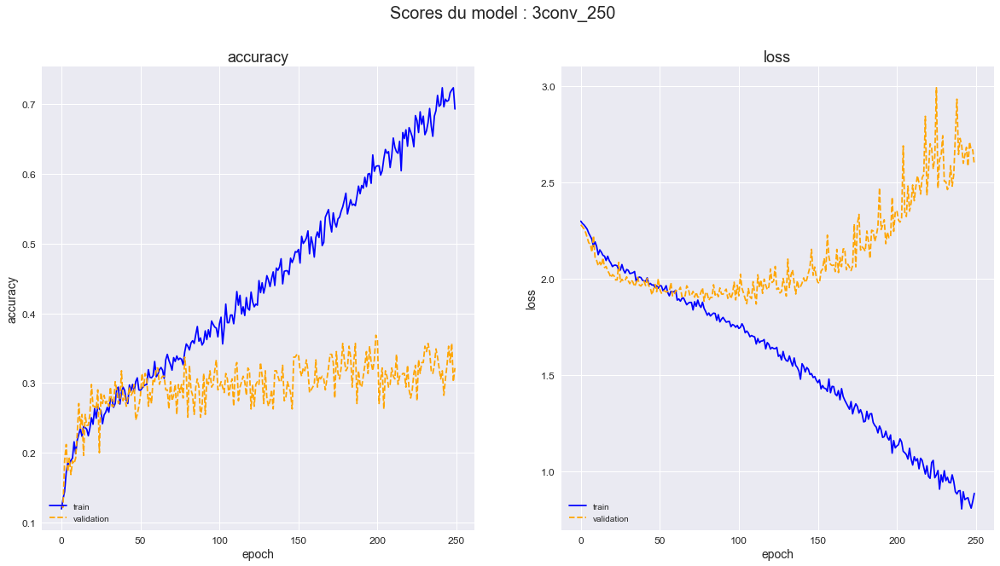

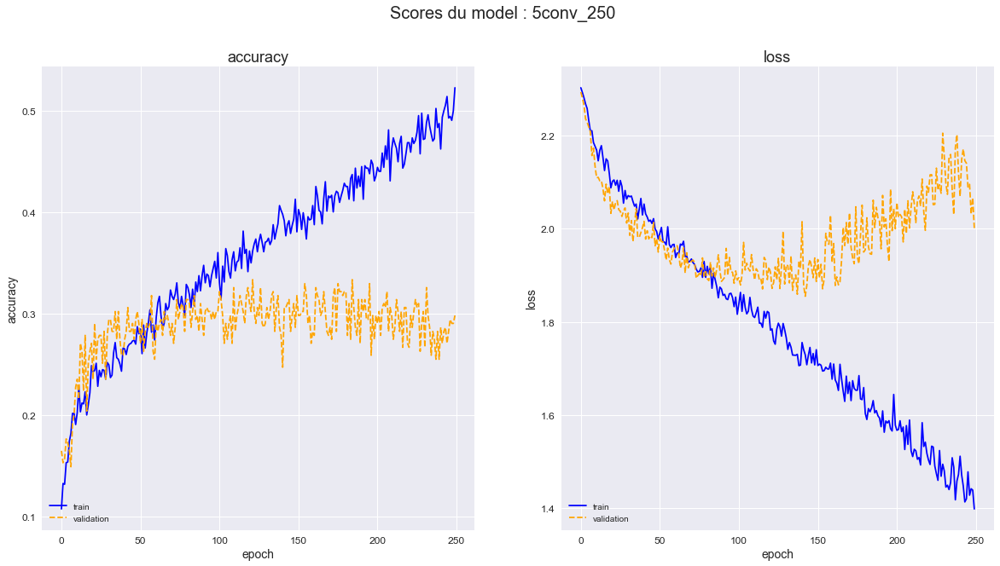

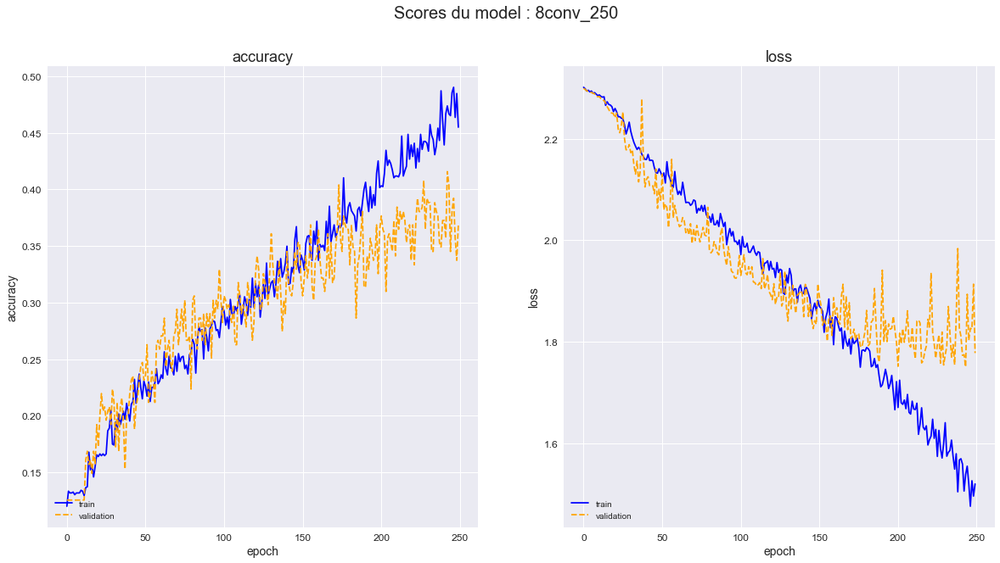

In [35]:
models_find.plot_history_scores(metric_list=['accuracy'])

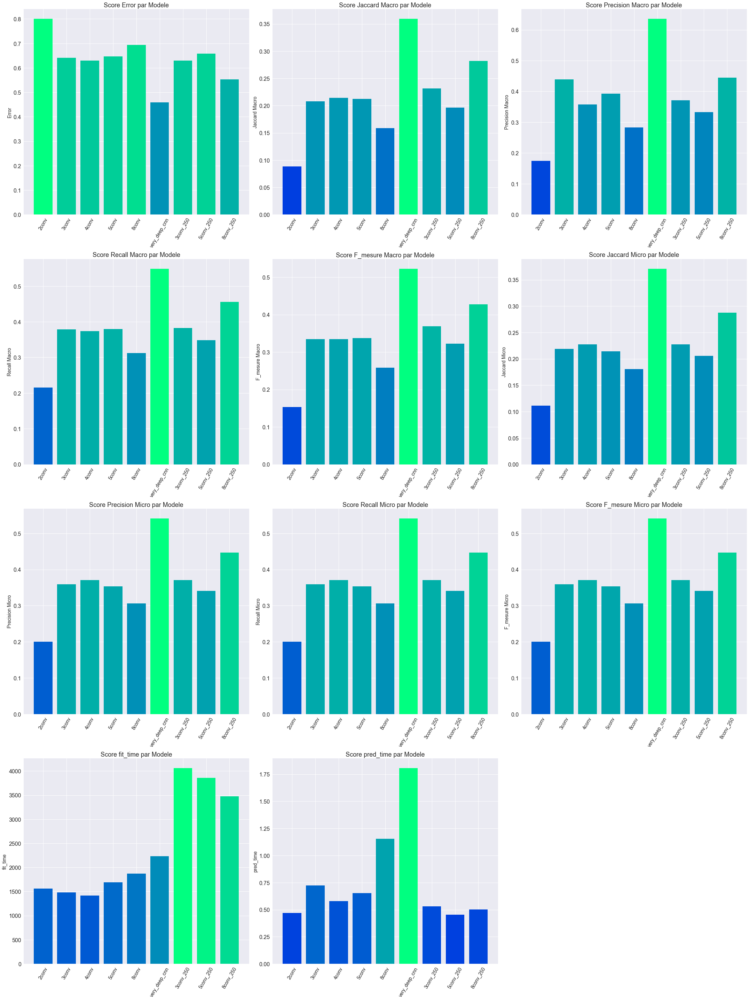

In [36]:
models_find.plot_perf()

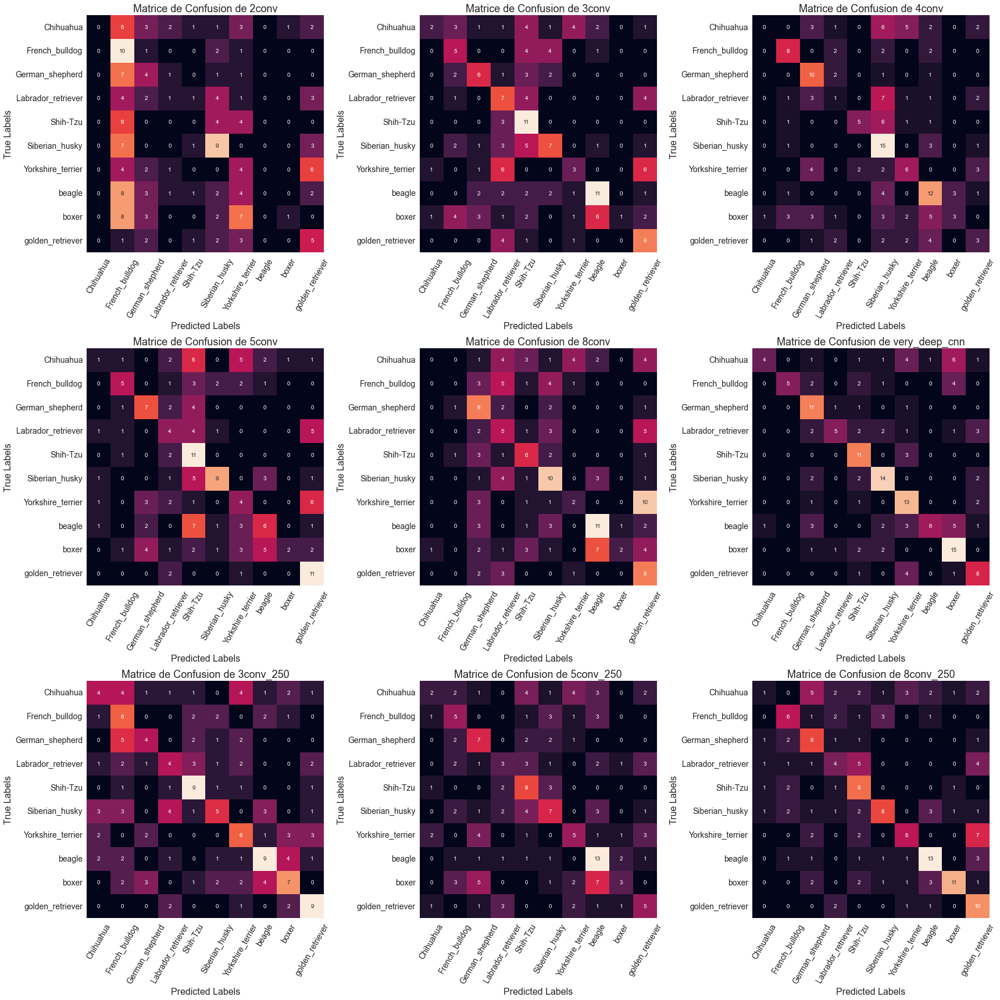

In [37]:
models_find.plot_confmat()

## Recherche de la meilleur resolution

In [50]:
models_resolution = ModelCNN(y_train=y_train, y_test=y_test, y_val=y_val, epochs=250)
models_resolution.add_scoring('accuracy')
models_resolution.add_scoring(f1_m)

x_train_box_100 = img_process(imgs=x_train, bndbox=box_train, resolution=100)
x_test_box_100 = img_process(imgs=x_test, bndbox=box_test, resolution=100)
x_val_box_100 = img_process(imgs=x_val, bndbox=box_val, resolution=100)

x_train_box_150 = img_process(imgs=x_train, bndbox=box_train, resolution=150)
x_test_box_150 = img_process(imgs=x_test, bndbox=box_test, resolution=150)
x_val_box_150 = img_process(imgs=x_val, bndbox=box_val, resolution=150)

x_train_box_200 = img_process(imgs=x_train, bndbox=box_train, resolution=200)
x_test_box_200 = img_process(imgs=x_test, bndbox=box_test, resolution=200)
x_val_box_200 = img_process(imgs=x_val, bndbox=box_val, resolution=200)

x_train_box_300 = img_process(imgs=x_train, bndbox=box_train, resolution=300)
x_test_box_300 = img_process(imgs=x_test, bndbox=box_test, resolution=300)
x_val_box_300 = img_process(imgs=x_val, bndbox=box_val, resolution=300)

models_resolution.add_data('box_100', x_train_box_100, x_test_box_100, x_val_box_100)
models_resolution.add_data('box_150', x_train_box_150, x_test_box_150, x_val_box_150)
models_resolution.add_data('box_200', x_train_box_200, x_test_box_200, x_val_box_200)
models_resolution.add_data('box_300', x_train_box_300, x_test_box_300, x_val_box_300)

opt = optimizers.SGD(learning_rate=0.01)

bright = ImageDataGenerator(
    brightness_range=(0.5, 1.5),
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True)
models_resolution.add_augment('bright', bright)

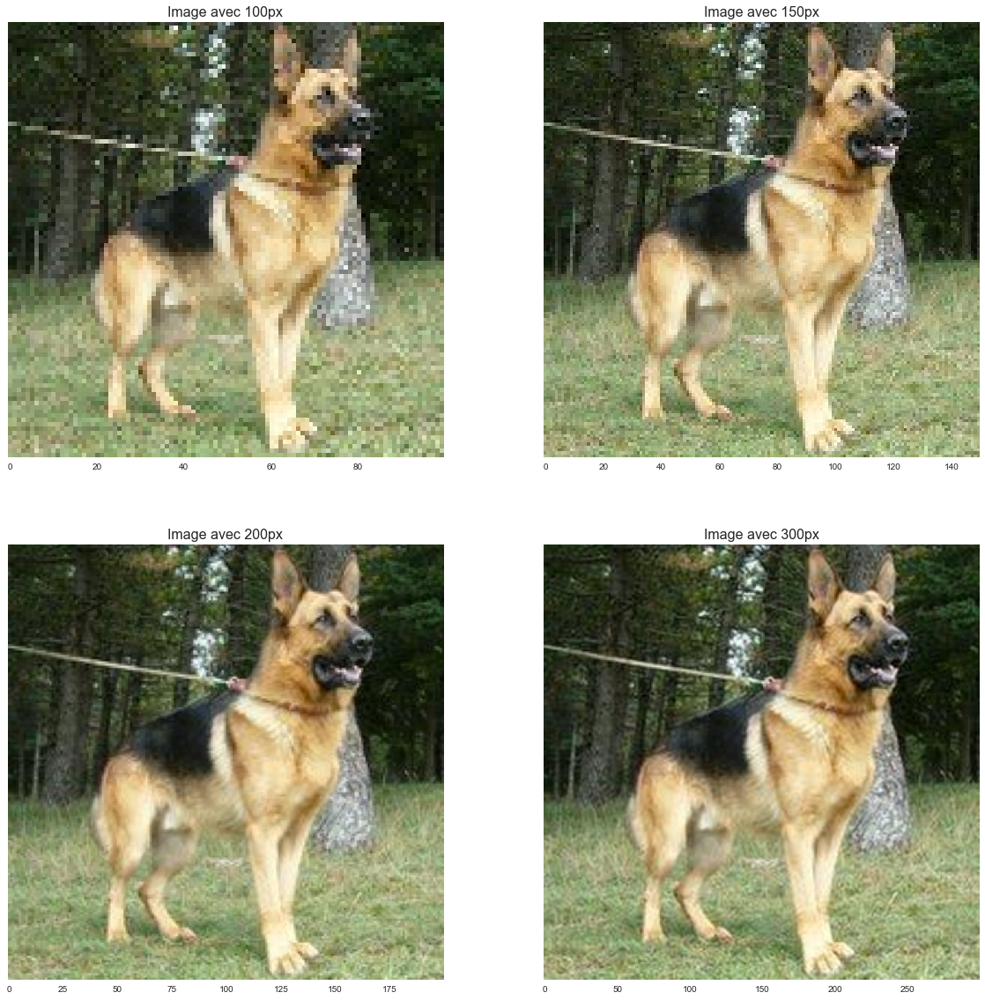

In [56]:
plot_img([
    x_train_box_100[3],
    x_train_box_150[3],
    x_train_box_200[3],
    x_train_box_300[3]
], [
    "Image avec 100px",
    "Image avec 150px",
    "Image avec 200px",
    "Image avec 300px",
])

In [38]:
mod_8conv= [
    [
        Rescaling(scale=1./255),
        Conv2D(filters=32, kernel_size=(3,3), padding='same', activation='relu'),
        Conv2D(32, (3,3), activation='relu'),
        MaxPooling2D((2,2)),  # Pooling
        Dropout(0.2), # Dropout
        Conv2D(64, (3,3), padding='same', activation='relu'),
        Conv2D(64, (3,3), activation='relu'),
        MaxPooling2D((2,2)),
        Dropout(0.2),
        Conv2D(128, (3,3), padding='same', activation='relu'),
        Conv2D(128, (3,3), activation='relu'),
        Activation('relu'),
        MaxPooling2D((2,2)),
        Dropout(0.2),
        Conv2D(512, (5,5), padding='same', activation='relu'),
        Conv2D(512, (5,5), activation='relu'),
        MaxPooling2D((4,4)),
        Dropout(0.2),
        Flatten(),
        Dense(1024, activation='relu'),
        Dropout(0.2),
        Dense(num_breeds, activation='softmax')
    ], [
        Rescaling(scale=1./255),
        Conv2D(filters=32, kernel_size=(3,3), padding='same', activation='relu'),
        Conv2D(32, (3,3), activation='relu'),
        MaxPooling2D((2,2)),  # Pooling
        Dropout(0.2), # Dropout
        Conv2D(64, (3,3), padding='same', activation='relu'),
        Conv2D(64, (3,3), activation='relu'),
        MaxPooling2D((2,2)),
        Dropout(0.2),
        Conv2D(128, (3,3), padding='same', activation='relu'),
        Conv2D(128, (3,3), activation='relu'),
        Activation('relu'),
        MaxPooling2D((2,2)),
        Dropout(0.2),
        Conv2D(512, (5,5), padding='same', activation='relu'),
        Conv2D(512, (5,5), activation='relu'),
        MaxPooling2D((4,4)),
        Dropout(0.2),
        Flatten(),
        Dense(1024, activation='relu'),
        Dropout(0.2),
        Dense(num_breeds, activation='softmax')
    ], [
        Rescaling(scale=1./255),
        Conv2D(filters=32, kernel_size=(3,3), padding='same', activation='relu'),
        Conv2D(32, (3,3), activation='relu'),
        MaxPooling2D((2,2)),  # Pooling
        Dropout(0.2), # Dropout
        Conv2D(64, (3,3), padding='same', activation='relu'),
        Conv2D(64, (3,3), activation='relu'),
        MaxPooling2D((2,2)),
        Dropout(0.2),
        Conv2D(128, (3,3), padding='same', activation='relu'),
        Conv2D(128, (3,3), activation='relu'),
        Activation('relu'),
        MaxPooling2D((2,2)),
        Dropout(0.2),
        Conv2D(512, (5,5), padding='same', activation='relu'),
        Conv2D(512, (5,5), activation='relu'),
        MaxPooling2D((4,4)),
        Dropout(0.2),
        Flatten(),
        Dense(1024, activation='relu'),
        Dropout(0.2),
        Dense(num_breeds, activation='softmax')
    ], [
        Rescaling(scale=1./255),
        Conv2D(filters=32, kernel_size=(3,3), padding='same', activation='relu'),
        Conv2D(32, (3,3), activation='relu'),
        MaxPooling2D((2,2)),  # Pooling
        Dropout(0.2), # Dropout
        Conv2D(64, (3,3), padding='same', activation='relu'),
        Conv2D(64, (3,3), activation='relu'),
        MaxPooling2D((2,2)),
        Dropout(0.2),
        Conv2D(128, (3,3), padding='same', activation='relu'),
        Conv2D(128, (3,3), activation='relu'),
        Activation('relu'),
        MaxPooling2D((2,2)),
        Dropout(0.2),
        Conv2D(512, (5,5), padding='same', activation='relu'),
        Conv2D(512, (5,5), activation='relu'),
        MaxPooling2D((4,4)),
        Dropout(0.2),
        Flatten(),
        Dense(1024, activation='relu'),
        Dropout(0.2),
        Dense(num_breeds, activation='softmax')
    ]
]

In [18]:
for box in ['box_100', 'box_150', 'box_200', 'box_300']:
    models_resolution.add_model(name='8conv_'+box, layers=mod_8conv[0], optimizer=opt)
    del mod_8conv[0]
    models_resolution.fit(model_name='8conv_'+box, data=box, augment='bright')
    models_resolution.save_models('Models/search_resolution_'+box+'.pkl')
    models_resolution.unload_models()

le model dropout_6conv_box_100 ajouté
Epoch 1/250
40/40 [==============================] - 6s 119ms/step - loss: 2.3015 - accuracy: 0.1224 - f1_m: 9.3940 - val_loss: 2.3005 - val_accuracy: 0.1255 - val_f1_m: 9.2331
Epoch 2/250
40/40 [==============================] - 5s 111ms/step - loss: 2.2997 - accuracy: 0.1302 - f1_m: 9.3285 - val_loss: 2.2989 - val_accuracy: 0.1255 - val_f1_m: 9.1983
Epoch 3/250
40/40 [==============================] - 5s 113ms/step - loss: 2.2980 - accuracy: 0.1325 - f1_m: 9.2199 - val_loss: 2.2976 - val_accuracy: 0.1255 - val_f1_m: 9.1983
Epoch 4/250
40/40 [==============================] - 5s 112ms/step - loss: 2.2977 - accuracy: 0.1318 - f1_m: 9.1880 - val_loss: 2.2964 - val_accuracy: 0.1255 - val_f1_m: 9.1983
Epoch 5/250
40/40 [==============================] - 5s 114ms/step - loss: 2.2966 - accuracy: 0.1318 - f1_m: 9.1348 - val_loss: 2.2955 - val_accuracy: 0.1255 - val_f1_m: 9.1983
Epoch 6/250
40/40 [==============================] - 6s 152ms/step - loss: 2.

In [49]:
models_resolution.save_models('Models/search_params.pkl')
del models_resolution

données du fichier Models/search_params.pkl bien sauvegardé


In [51]:
models_resolution.load_models('Models/search_params.pkl')

données du fichier Models/search_params.pkl bien chargé


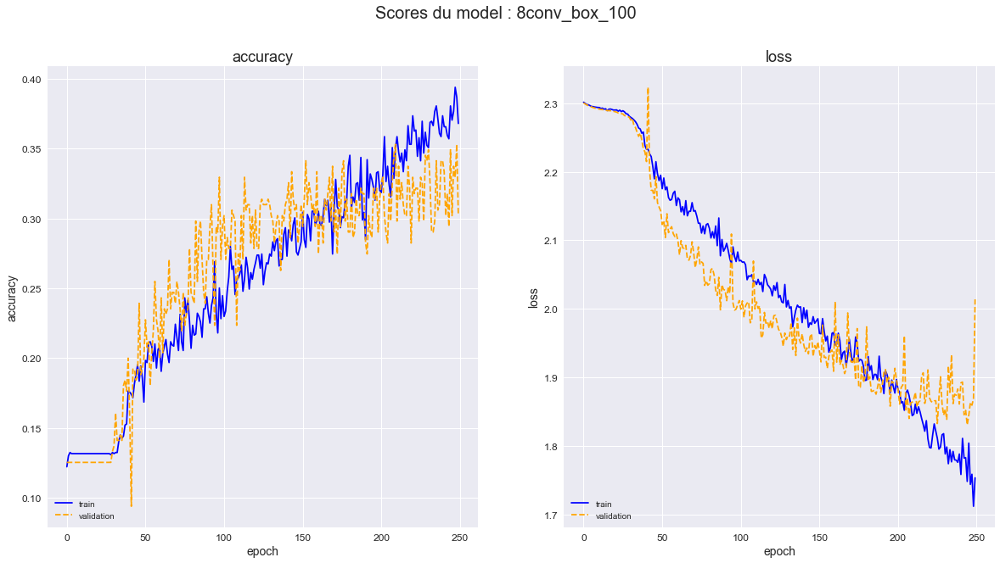

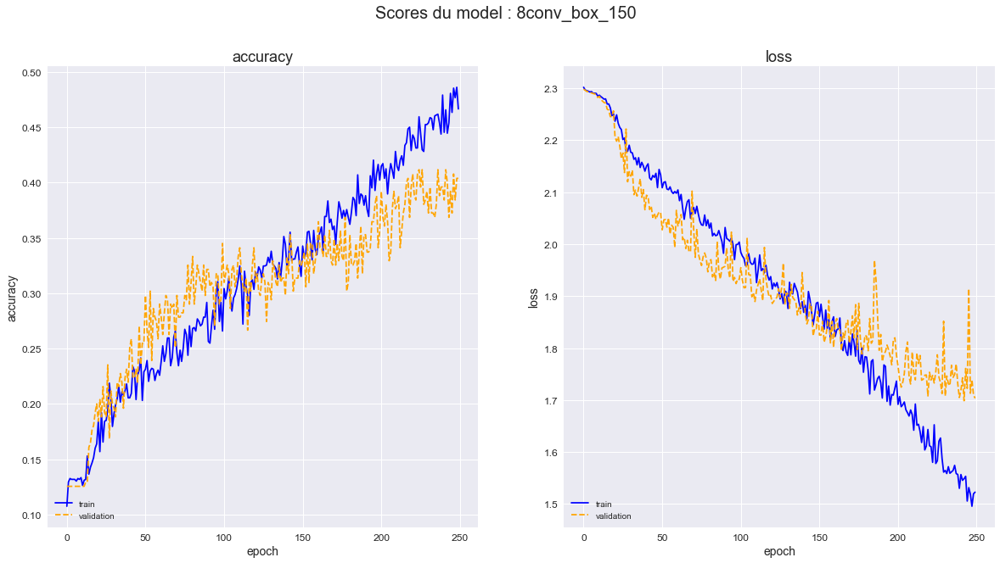

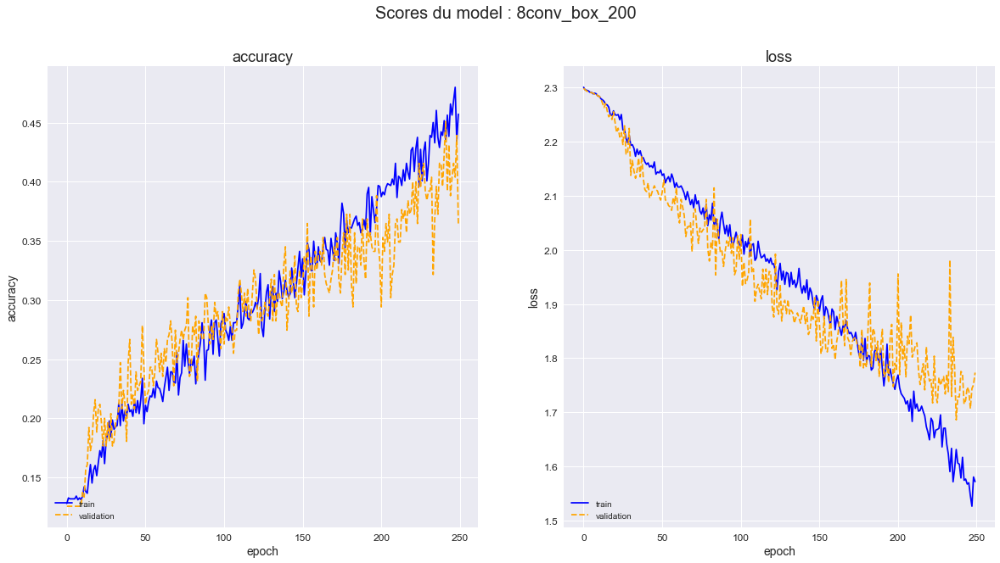

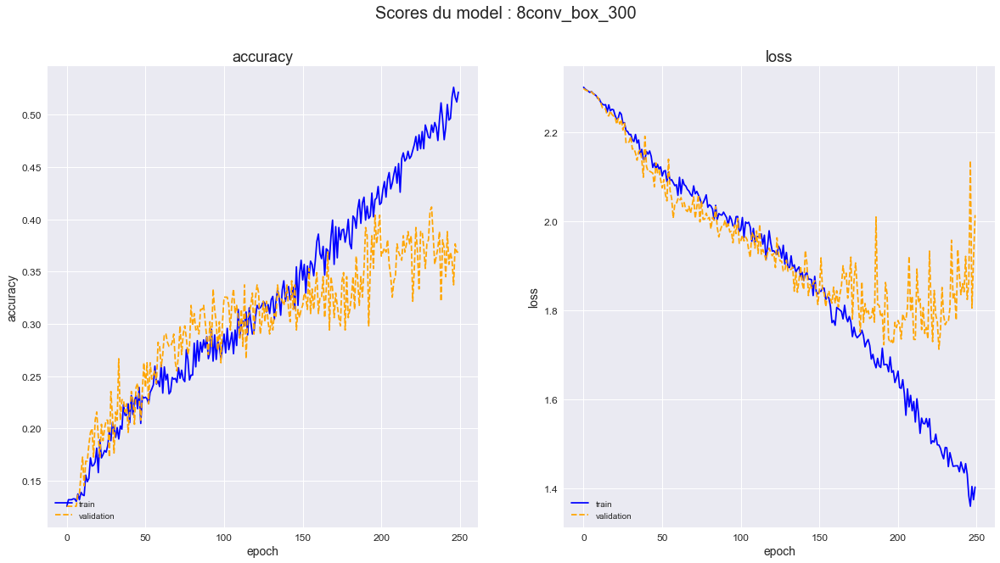

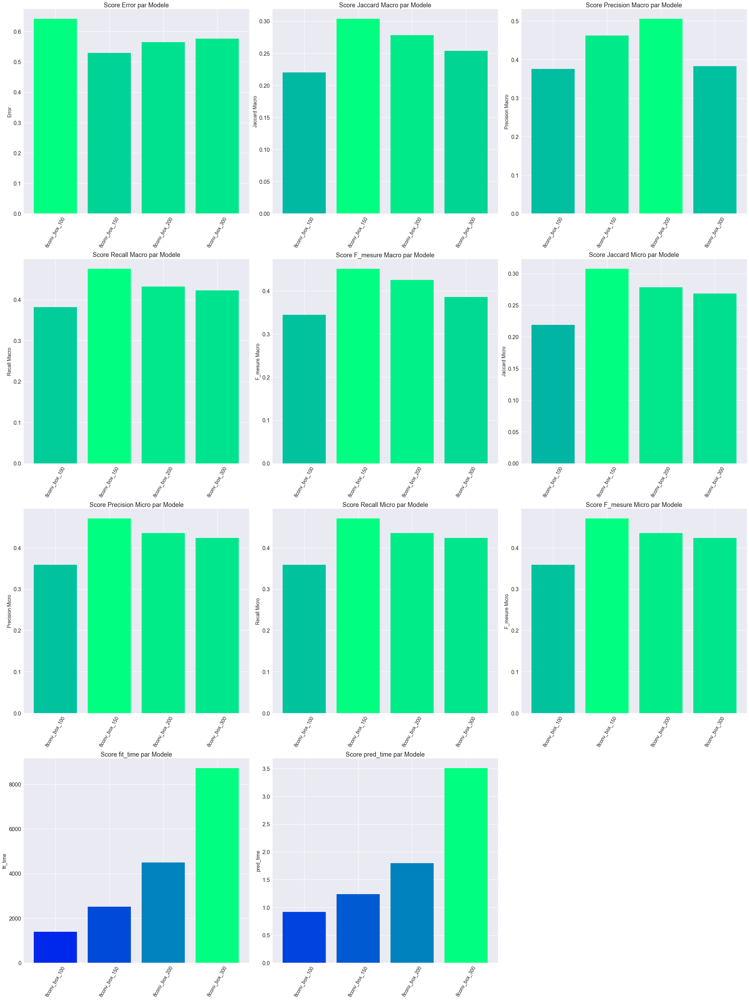

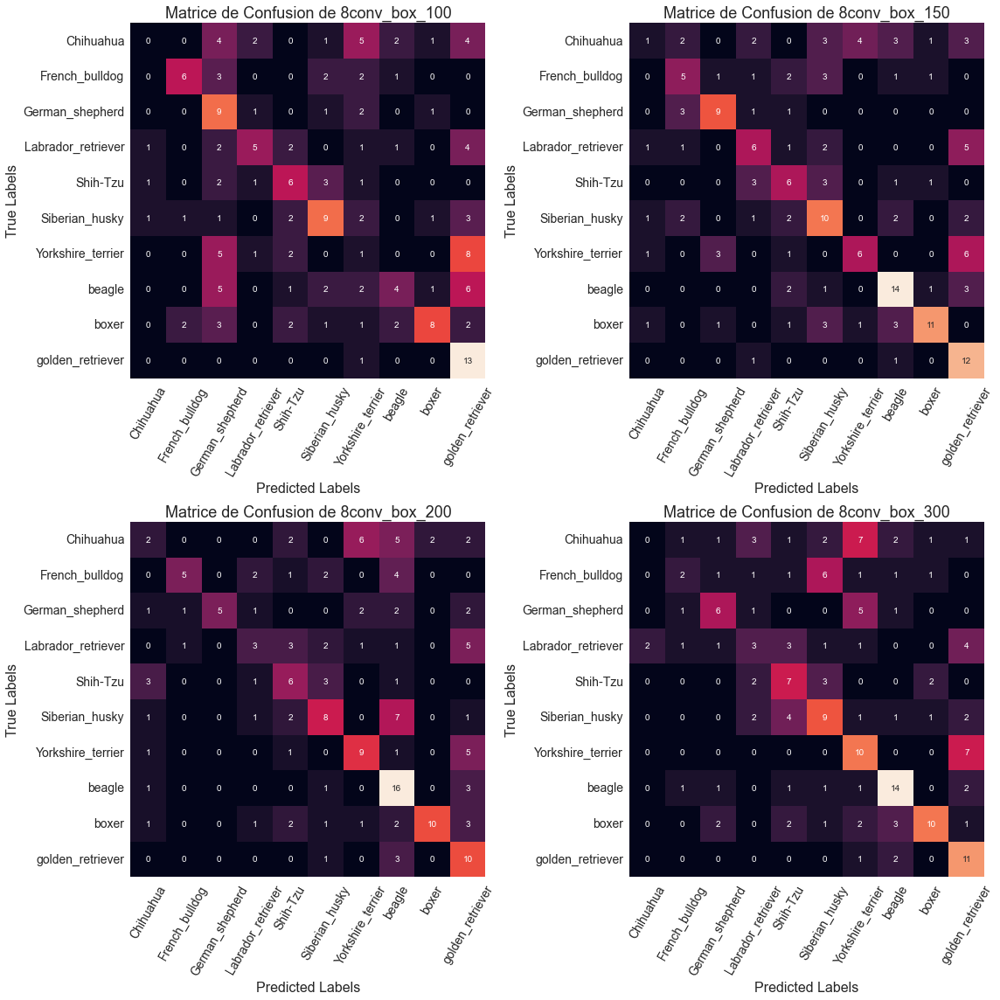

In [52]:
models_resolution.plot_history_scores(metric_list=['accuracy'])
models_resolution.plot_perf()
models_resolution.plot_confmat()

## Recherche du meilleur Learning rate

In [64]:
models_opt = ModelCNN(y_train=y_train, y_test=y_test, y_val=y_val, epochs=200)
models_opt.add_scoring('accuracy')
models_opt.add_scoring(f1_m)

x_train_box_150 = img_process(imgs=x_train, bndbox=box_train, resolution=150)
x_test_box_150 = img_process(imgs=x_test, bndbox=box_test, resolution=150)
x_val_box_150 = img_process(imgs=x_val, bndbox=box_val, resolution=150)

models_opt.add_data('box', x_train_box_150, x_test_box_150, x_val_box_150)

bright = ImageDataGenerator(
    brightness_range=(0.5, 1.5),
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True)
models_opt.add_augment('bright', bright)

In [11]:
for opt in [0.1, 0.05, 0.01, 0.005, 0.001, 0.0001]:
    mod_8conv= [
            Rescaling(scale=1./255),
            Conv2D(filters=32, kernel_size=(3,3), padding='same', activation='relu'),
            Conv2D(32, (3,3), activation='relu'),
            MaxPooling2D((2,2)),  # Pooling
            Dropout(0.2), # Dropout
            Conv2D(64, (3,3), padding='same', activation='relu'),
            Conv2D(64, (3,3), activation='relu'),
            MaxPooling2D((2,2)),
            Dropout(0.2),
            Conv2D(128, (3,3), padding='same', activation='relu'),
            Conv2D(128, (3,3), activation='relu'),
            Activation('relu'),
            MaxPooling2D((2,2)),
            Dropout(0.2),
            Conv2D(512, (5,5), padding='same', activation='relu'),
            Conv2D(512, (5,5), activation='relu'),
            MaxPooling2D((4,4)),
            Dropout(0.2),
            Flatten(),
            Dense(1024, activation='relu'),
            Dropout(0.2),
            Dense(num_breeds, activation='softmax')
        ]
    models_opt.add_model(name='8conv_'+str(opt), layers=mod_8conv, optimizer=optimizers.SGD(learning_rate=opt))
    del mod_8conv
    models_opt.fit(model_name='8conv_'+str(opt), data='box', augment='bright')
    models_opt.save_models('Models/search_opt_'+str(opt)+'.pkl')
    models_opt.unload_models()

le model dropout_6conv_0.1 ajouté
Epoch 1/200
40/40 [==============================] - 28s 471ms/step - loss: 2.3005 - accuracy: 0.1200 - f1_m: 9.5426 - val_loss: 2.2932 - val_accuracy: 0.1255 - val_f1_m: 9.1983
Epoch 2/200
40/40 [==============================] - 8s 208ms/step - loss: 2.2950 - accuracy: 0.1310 - f1_m: 9.3034 - val_loss: 2.2949 - val_accuracy: 0.1255 - val_f1_m: 9.7192
Epoch 3/200
40/40 [==============================] - 8s 208ms/step - loss: 2.2932 - accuracy: 0.1255 - f1_m: 9.4226 - val_loss: 2.2915 - val_accuracy: 0.1255 - val_f1_m: 9.6147
Epoch 4/200
40/40 [==============================] - 8s 207ms/step - loss: 2.2949 - accuracy: 0.1271 - f1_m: 9.3324 - val_loss: 2.2927 - val_accuracy: 0.1255 - val_f1_m: 9.4588
Epoch 5/200
40/40 [==============================] - 8s 207ms/step - loss: 2.2975 - accuracy: 0.1318 - f1_m: 9.4633 - val_loss: 2.2917 - val_accuracy: 0.1255 - val_f1_m: 9.7358
Epoch 6/200
40/40 [==============================] - 8s 207ms/step - loss: 2.294

c:\Users\Jayma\.conda\envs\tf\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


données du fichier Models/search_opt_0.001.pkl bien sauvegardé
le model dropout_6conv_0.0001 ajouté
Epoch 1/200
40/40 [==============================] - 10s 231ms/step - loss: 2.3029 - accuracy: 0.1035 - f1_m: 9.6436 - val_loss: 2.3021 - val_accuracy: 0.1098 - val_f1_m: 9.8338
Epoch 2/200
40/40 [==============================] - 10s 252ms/step - loss: 2.3039 - accuracy: 0.1012 - f1_m: 9.6597 - val_loss: 2.3020 - val_accuracy: 0.1137 - val_f1_m: 9.8248
Epoch 3/200
40/40 [==============================] - 10s 234ms/step - loss: 2.3021 - accuracy: 0.1067 - f1_m: 9.6121 - val_loss: 2.3019 - val_accuracy: 0.1137 - val_f1_m: 9.8159
Epoch 4/200
40/40 [==============================] - 10s 247ms/step - loss: 2.3032 - accuracy: 0.1020 - f1_m: 9.6324 - val_loss: 2.3018 - val_accuracy: 0.1059 - val_f1_m: 9.7989
Epoch 5/200
40/40 [==============================] - 10s 230ms/step - loss: 2.3030 - accuracy: 0.1012 - f1_m: 9.6212 - val_loss: 2.3018 - val_accuracy: 0.1098 - val_f1_m: 9.7906
Epoch 6/20

c:\Users\Jayma\.conda\envs\tf\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [62]:
models_opt.save_models('Models/search_opt.pkl')
del models_opt

données du fichier Models/search_opt.pkl bien sauvegardé


In [65]:
models_opt.load_models('Models/search_opt.pkl')

données du fichier Models/search_opt.pkl bien chargé


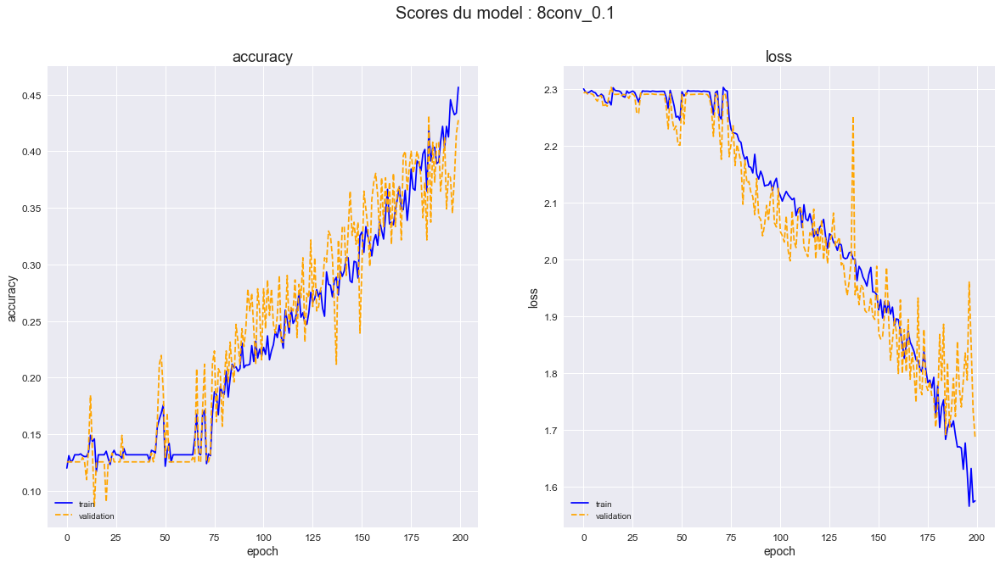

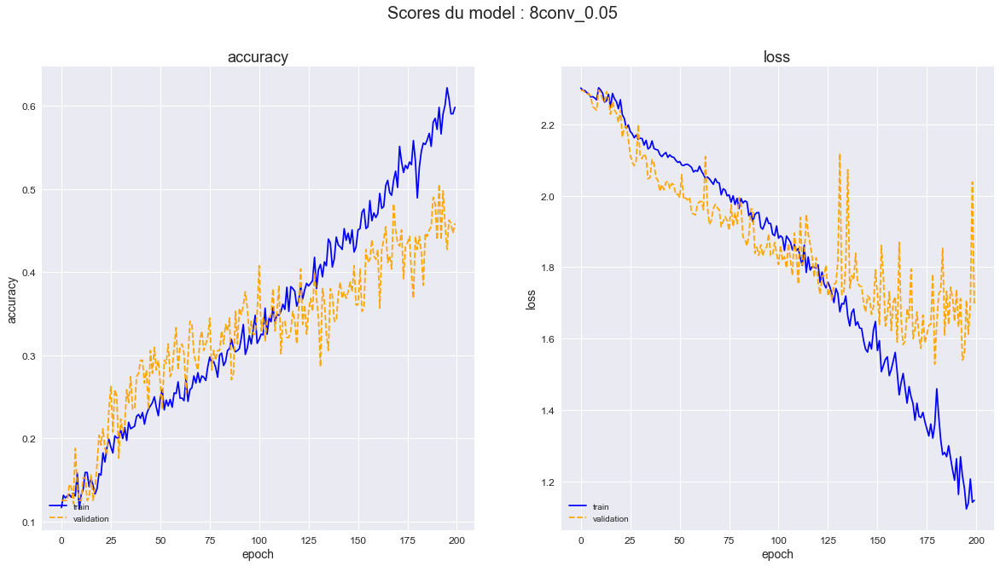

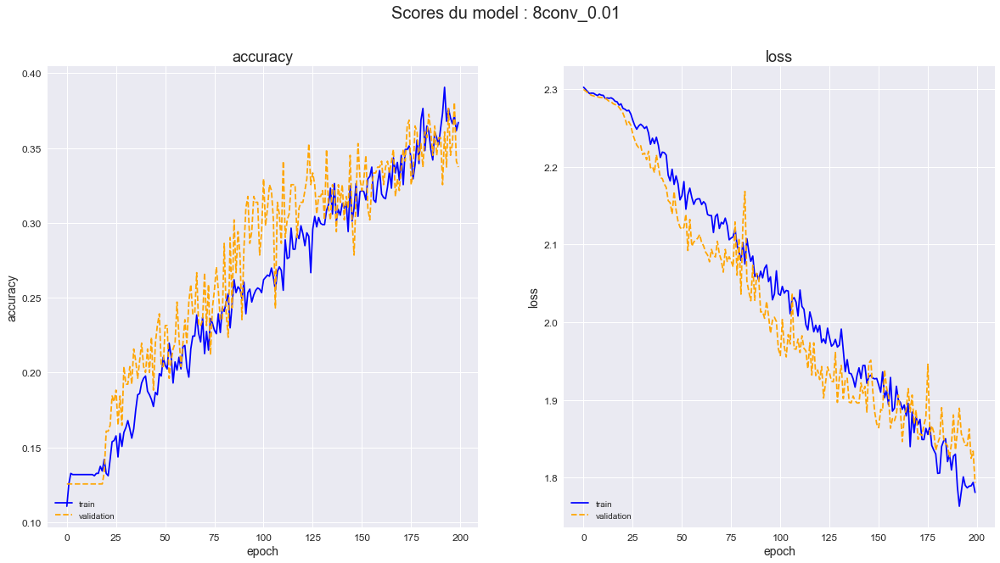

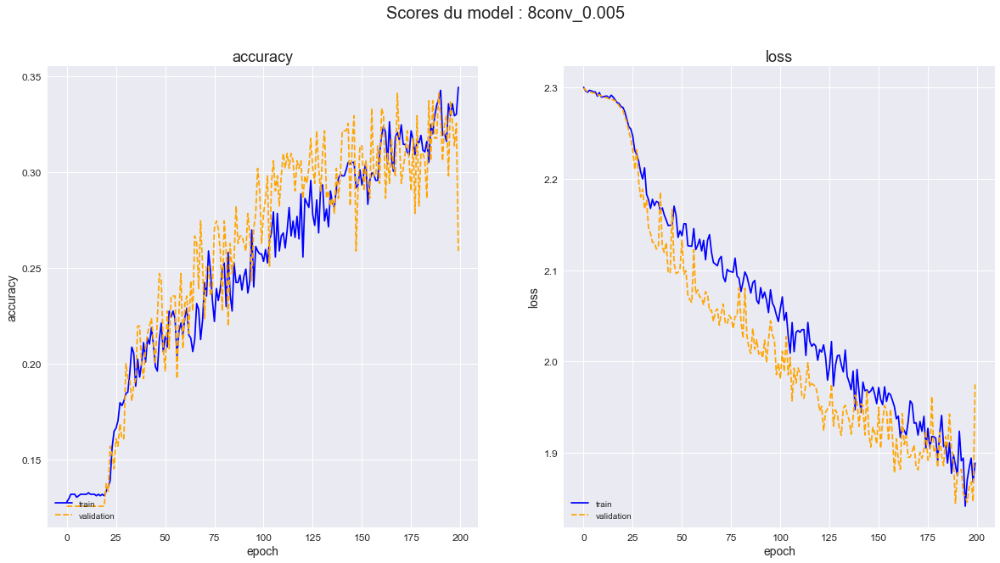

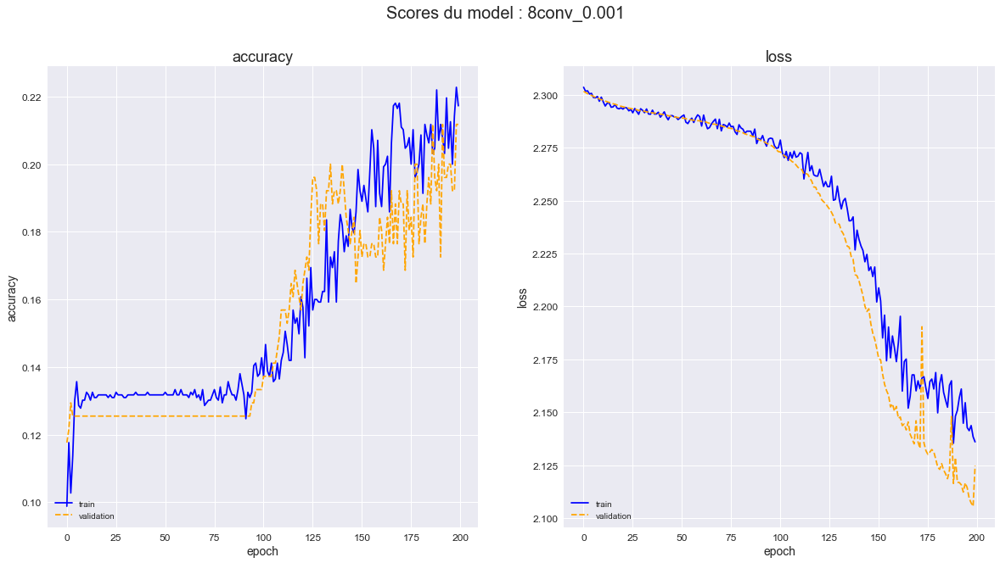

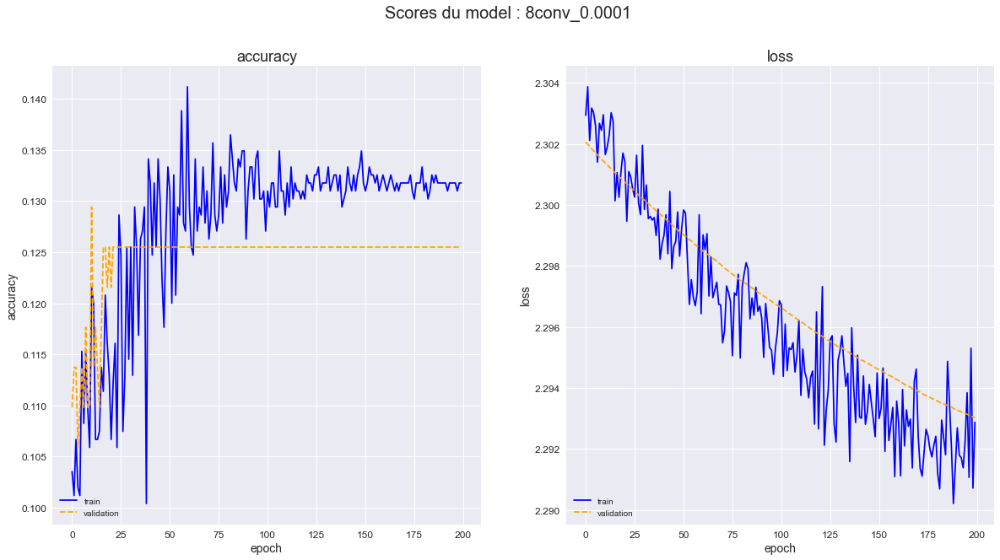

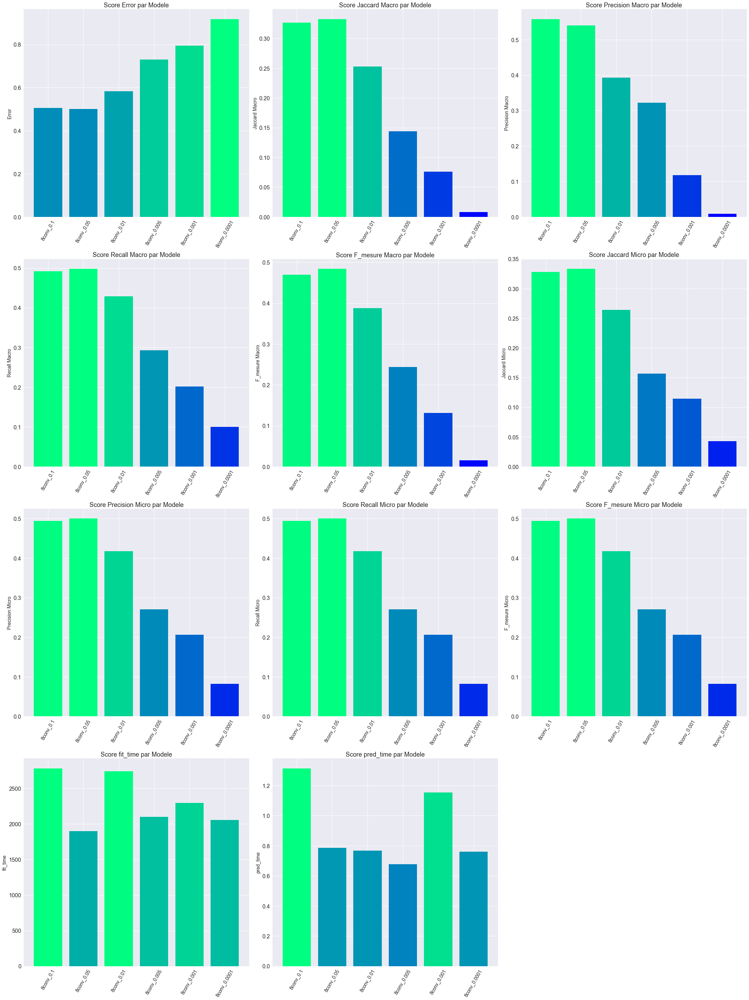

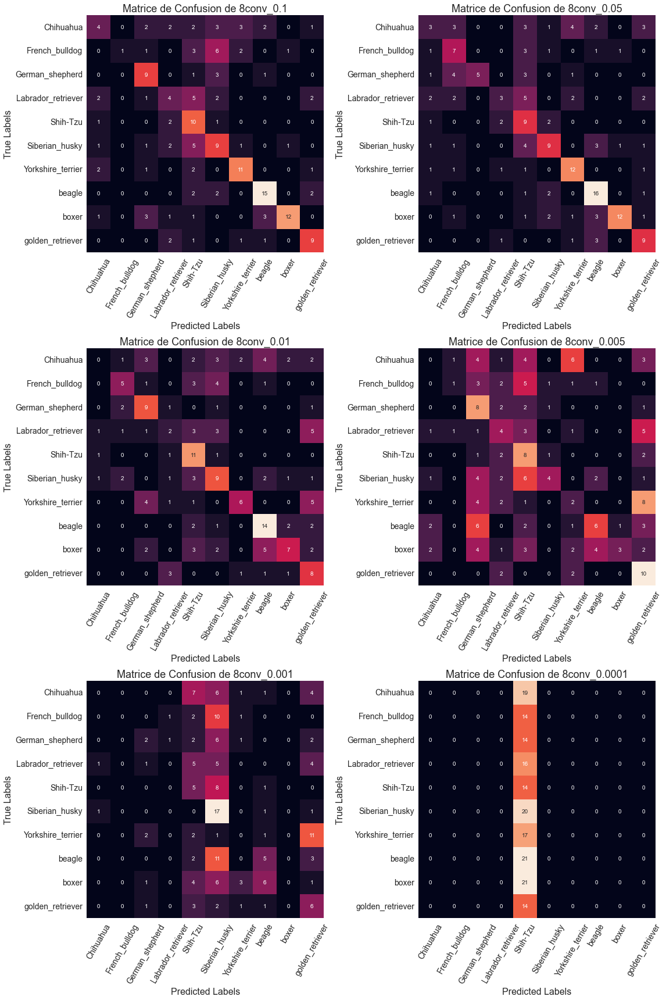

In [66]:
models_opt.plot_history_scores(metric_list=['accuracy'])
models_opt.plot_perf()
models_opt.plot_confmat()

## Recherche du meilleur Batsh

In [13]:
models_batsh = ModelCNN(y_train=y_train, y_test=y_test, y_val=y_val, epochs=200)
models_batsh.add_scoring('accuracy')
models_batsh.add_scoring(f1_m)

x_train_box_150 = img_process(imgs=x_train, bndbox=box_train, resolution=150)
x_test_box_150 = img_process(imgs=x_test, bndbox=box_test, resolution=150)
x_val_box_150 = img_process(imgs=x_val, bndbox=box_val, resolution=150)

models_batsh.add_data('box', x_train_box_150, x_test_box_150, x_val_box_150)

opt = optimizers.SGD(learning_rate=0.05)

bright = ImageDataGenerator(
    brightness_range=(0.5, 1.5),
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True)
models_batsh.add_augment('bright', bright)

In [11]:
for batsh in [4, 8, 16, 32, 64]:
    mod_8conv= [
            Rescaling(scale=1./255),
            Conv2D(filters=32, kernel_size=(3,3), padding='same', activation='relu'),
            Conv2D(32, (3,3), activation='relu'),
            MaxPooling2D((2,2)),  # Pooling
            Dropout(0.2), # Dropout
            Conv2D(64, (3,3), padding='same', activation='relu'),
            Conv2D(64, (3,3), activation='relu'),
            MaxPooling2D((2,2)),
            Dropout(0.2),
            Conv2D(128, (3,3), padding='same', activation='relu'),
            Conv2D(128, (3,3), activation='relu'),
            Activation('relu'),
            MaxPooling2D((2,2)),
            Dropout(0.2),
            Conv2D(512, (5,5), padding='same', activation='relu'),
            Conv2D(512, (5,5), activation='relu'),
            MaxPooling2D((4,4)),
            Dropout(0.2),
            Flatten(),
            Dense(1024, activation='relu'),
            Dropout(0.2),
            Dense(num_breeds, activation='softmax')
        ]
    models_batsh.add_model(name='8conv_'+str(batsh), layers=mod_8conv, optimizer=opt)
    del mod_8conv
    models_batsh.fit(model_name='8conv_'+str(batsh), data='box', augment='bright', batch=batsh)
    models_batsh.save_models('Models/search_batsh_'+str(batsh)+'.pkl')
    models_batsh.unload_models()

le model 8conv_4 ajouté
Epoch 1/200
319/319 [==============================] - 25s 68ms/step - loss: 2.3019 - accuracy: 0.1239 - f1_m: 9.3951 - val_loss: 2.2984 - val_accuracy: 0.1255 - val_f1_m: 9.4661
Epoch 2/200
319/319 [==============================] - 21s 67ms/step - loss: 2.3008 - accuracy: 0.1302 - f1_m: 9.5261 - val_loss: 2.2911 - val_accuracy: 0.1176 - val_f1_m: 9.4661
Epoch 3/200
319/319 [==============================] - 19s 60ms/step - loss: 2.3009 - accuracy: 0.1278 - f1_m: 9.4441 - val_loss: 2.2932 - val_accuracy: 0.1255 - val_f1_m: 9.2448
Epoch 4/200
319/319 [==============================] - 19s 61ms/step - loss: 2.2994 - accuracy: 0.1278 - f1_m: 9.4054 - val_loss: 2.2950 - val_accuracy: 0.1255 - val_f1_m: 9.4245
Epoch 5/200
319/319 [==============================] - 19s 60ms/step - loss: 2.2990 - accuracy: 0.1318 - f1_m: 9.4284 - val_loss: 2.2942 - val_accuracy: 0.1255 - val_f1_m: 9.6875
Epoch 6/200
319/319 [==============================] - 19s 61ms/step - loss: 2.29

c:\Users\Jayma\.conda\envs\tf\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


données du fichier Models/search_batsh_4.pkl bien sauvegardé
le model 8conv_8 ajouté
Epoch 1/200
160/160 [==============================] - 15s 75ms/step - loss: 2.3009 - accuracy: 0.1216 - f1_m: 9.5140 - val_loss: 2.2927 - val_accuracy: 0.1255 - val_f1_m: 9.7548
Epoch 2/200
160/160 [==============================] - 11s 70ms/step - loss: 2.2995 - accuracy: 0.1247 - f1_m: 9.4461 - val_loss: 2.2912 - val_accuracy: 0.1255 - val_f1_m: 9.7548
Epoch 3/200
160/160 [==============================] - 11s 70ms/step - loss: 2.2987 - accuracy: 0.1278 - f1_m: 9.4103 - val_loss: 2.2949 - val_accuracy: 0.1255 - val_f1_m: 9.7548
Epoch 4/200
160/160 [==============================] - 11s 70ms/step - loss: 2.2986 - accuracy: 0.1255 - f1_m: 9.2667 - val_loss: 2.2916 - val_accuracy: 0.1255 - val_f1_m: 9.4777
Epoch 5/200
160/160 [==============================] - 11s 70ms/step - loss: 2.2968 - accuracy: 0.1302 - f1_m: 9.3879 - val_loss: 2.2903 - val_accuracy: 0.1255 - val_f1_m: 9.2195
Epoch 6/200
160/160 

In [12]:
models_batsh.save_models('Models/search_batsh.pkl')
del models_batsh

données du fichier Models/search_batsh.pkl bien sauvegardé


In [14]:
models_batsh.load_models('Models/search_batsh.pkl')

données du fichier Models/search_batsh.pkl bien chargé


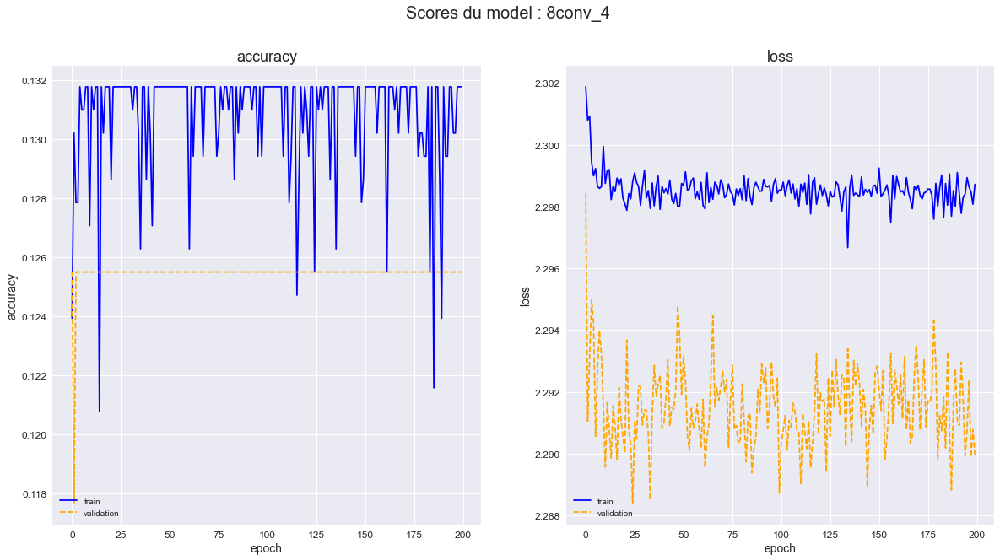

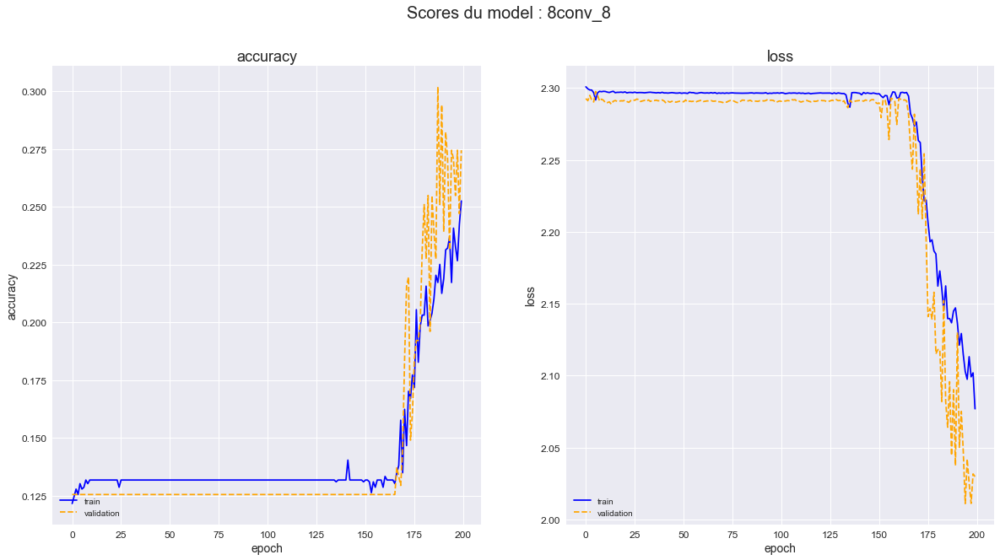

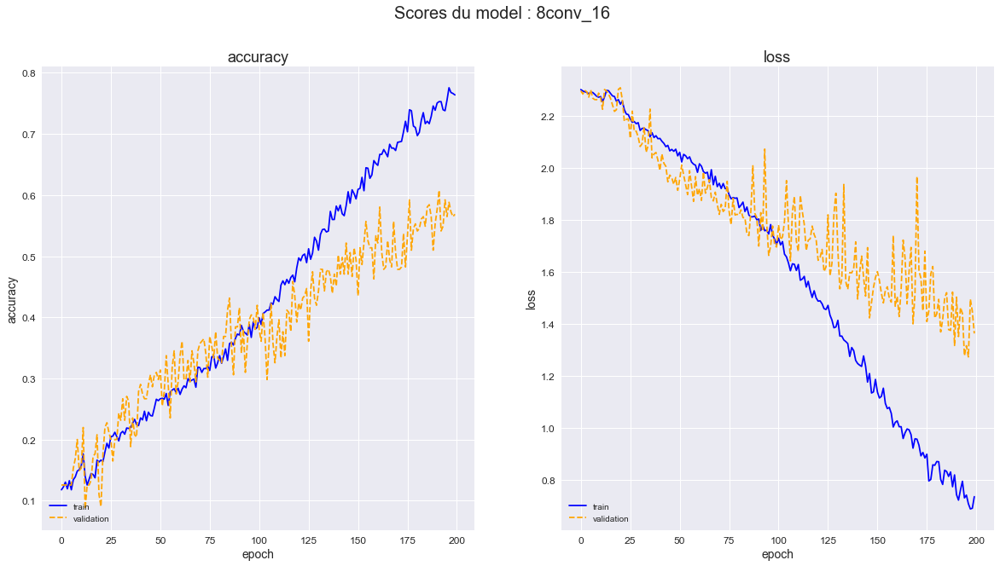

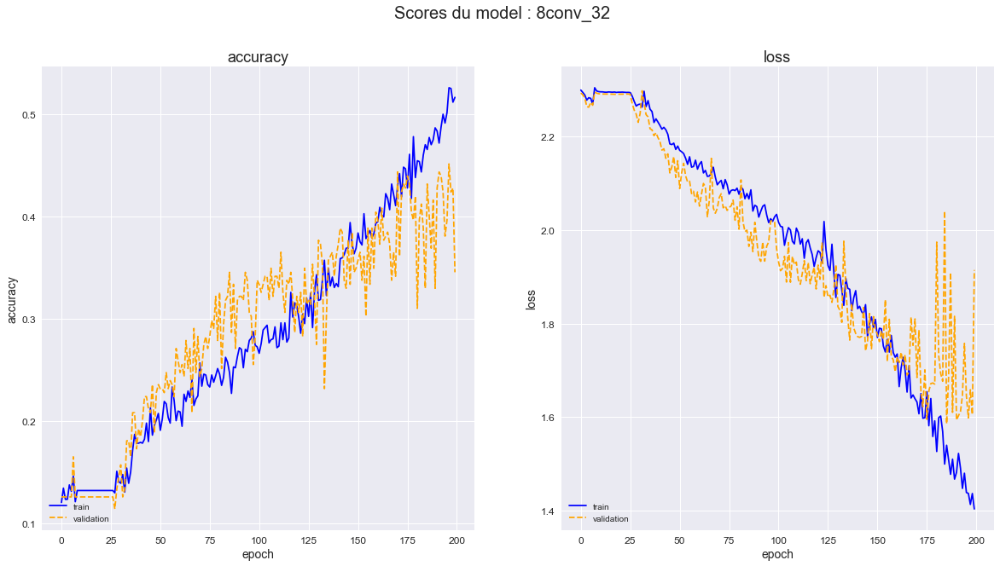

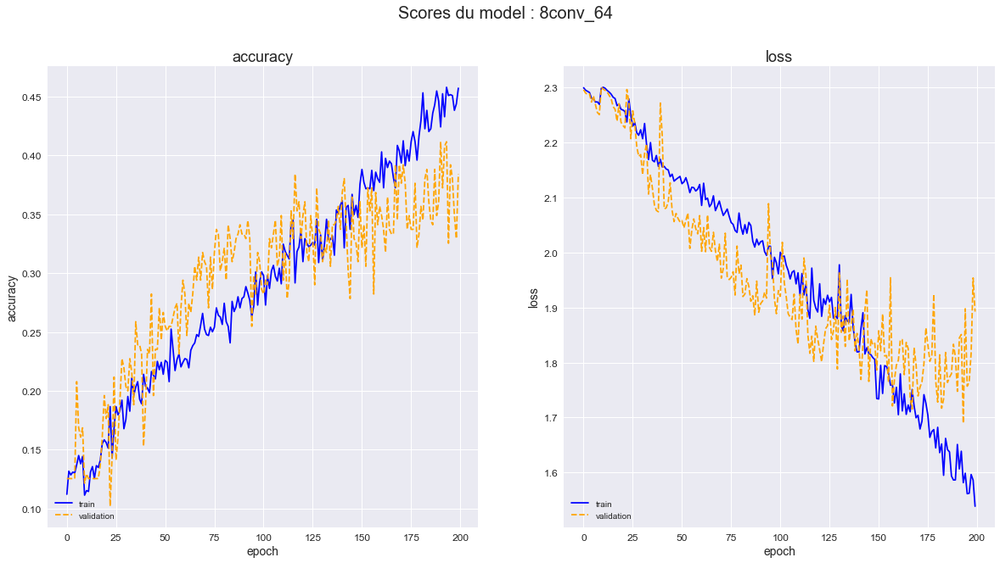

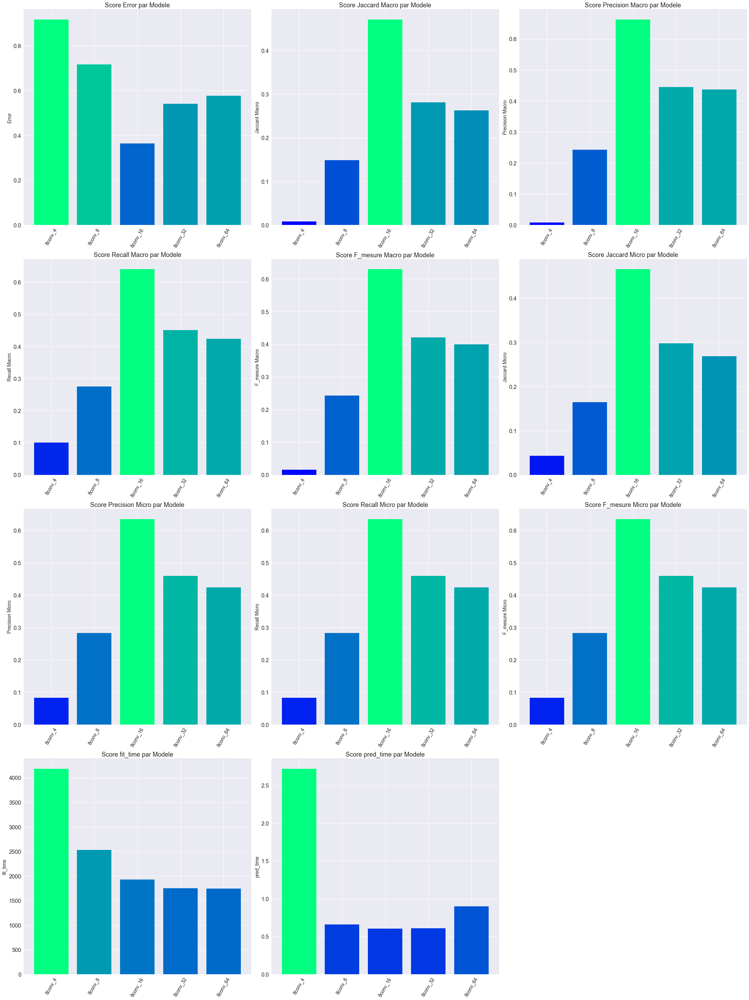

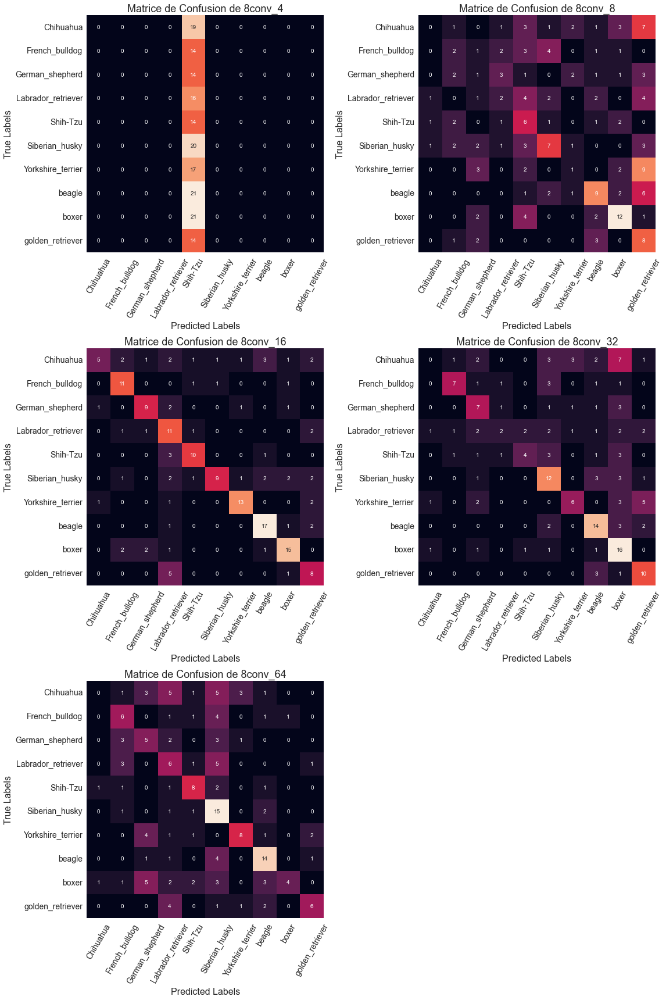

In [15]:
models_batsh.plot_history_scores(metric_list=['accuracy'])
models_batsh.plot_perf()
models_batsh.plot_confmat()

## Recherche du meilleur Transfert learning

In [76]:
models_transfert = ModelCNN(y_train=y_train, y_test=y_test, y_val=y_val, epochs=20)
models_transfert.add_scoring('accuracy')
models_transfert.add_scoring(f1_m)

x_train_box_224 = img_process(imgs=x_train, bndbox=box_train, resolution=224)
x_test_box_224 = img_process(imgs=x_test, bndbox=box_test, resolution=224)
x_val_box_224 = img_process(imgs=x_val, bndbox=box_val, resolution=224)

x_train_box_299 = img_process(imgs=x_train, bndbox=box_train, resolution=299)
x_test_box_299 = img_process(imgs=x_test, bndbox=box_test, resolution=299)
x_val_box_299 = img_process(imgs=x_val, bndbox=box_val, resolution=299)

x_train_xception = tf.keras.applications.xception.preprocess_input(x_train_box_299)
x_test_xception = tf.keras.applications.xception.preprocess_input(x_test_box_299)
x_val_xception = tf.keras.applications.xception.preprocess_input(x_val_box_299)
models_transfert.add_data('xception', x_train_xception, x_test_xception, x_val_xception)

x_train_vgg16 = tf.keras.applications.vgg16.preprocess_input(x_train_box_224)
x_test_vgg16 = tf.keras.applications.vgg16.preprocess_input(x_test_box_224)
x_val_vgg16 = tf.keras.applications.vgg16.preprocess_input(x_val_box_224)
models_transfert.add_data('vgg16', x_train_vgg16, x_test_vgg16, x_val_vgg16)

x_train_inception_resnet = tf.keras.applications.inception_resnet_v2.preprocess_input(x_train_box_299)
x_test_inception_resnet = tf.keras.applications.inception_resnet_v2.preprocess_input(x_test_box_299)
x_val_inception_resnet = tf.keras.applications.inception_resnet_v2.preprocess_input(x_val_box_299)
models_transfert.add_data('inception_resnet', x_train_inception_resnet, x_test_inception_resnet, x_val_inception_resnet)

x_train_resnet = tf.keras.applications.resnet50.preprocess_input(x_train_box_224)
x_test_resnet = tf.keras.applications.resnet50.preprocess_input(x_test_box_224)
x_val_resnet = tf.keras.applications.resnet50.preprocess_input(x_val_box_224)
models_transfert.add_data('resnet', x_train_resnet, x_test_resnet, x_val_resnet)

x_train_efficientnet = tf.keras.applications.efficientnet.preprocess_input(x_train_box_224)
x_test_efficientnet = tf.keras.applications.efficientnet.preprocess_input(x_test_box_224)
x_val_efficientnet = tf.keras.applications.efficientnet.preprocess_input(x_val_box_224)
models_transfert.add_data('efficientnet', x_train_efficientnet, x_test_efficientnet, x_val_efficientnet)


opt = optimizers.SGD(learning_rate=0.01)
basic = ImageDataGenerator(
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True)
models_transfert.add_augment('basic', basic)

In [13]:
xception_model = tf.keras.applications.xception.Xception(
    weights='imagenet',
    include_top=False,
    pooling='avg')
new_xception_model = transfert_to_model(xception_model, num_breeds)

models_transfert.add_model(name='xception', model=new_xception_model, optimizer=opt)
models_transfert.fit(model_name='xception', data='xception', augment='basic')
del new_xception_model, xception_model
models_transfert.save_models('Models/models_transfert_xception.pkl')
models_transfert.unload_models()


vgg16_model = tf.keras.applications.VGG16(
    weights='imagenet',
    include_top=False,
    pooling='avg')
new_vgg16_model = transfert_to_model(vgg16_model, num_breeds)

models_transfert.add_model(name='vgg16', model=new_vgg16_model, optimizer=opt)
models_transfert.fit(model_name='vgg16', data='vgg16', augment='basic')
del new_vgg16_model, vgg16_model
models_transfert.save_models('Models/models_transfert_vgg16.pkl')
models_transfert.unload_models()


inception_resnet_model = tf.keras.applications.InceptionResNetV2(
    weights='imagenet',
    include_top=False,
    pooling='avg')
new_inception_resnet_model = transfert_to_model(inception_resnet_model, num_breeds)

models_transfert.add_model(name='inception_resnet', model=new_inception_resnet_model, optimizer=opt)
models_transfert.fit(model_name='inception_resnet', data='inception_resnet', augment='basic')
del new_inception_resnet_model, inception_resnet_model
models_transfert.save_models('Models/models_transfert_inception_resnet.pkl')
models_transfert.unload_models()


resnet_model = tf.keras.applications.ResNet50(
    weights='imagenet',
    include_top=False,
    pooling='avg')
new_resnet_model = transfert_to_model(resnet_model, num_breeds)

models_transfert.add_model(name='resnet', model=new_resnet_model , optimizer=opt)
models_transfert.fit(model_name='resnet', data='resnet', augment='basic')
del new_resnet_model, resnet_model
models_transfert.save_models('Models/models_transfert_resnet.pkl')
models_transfert.unload_models()


efficient_net_model = tf.keras.applications.EfficientNetB7(
    weights='imagenet',
    include_top=False,
    pooling='avg')
new_efficient_net_model = transfert_to_model(efficient_net_model, num_breeds)

models_transfert.add_model(name='efficient_net', model=new_efficient_net_model , optimizer=opt)
models_transfert.fit(model_name='efficient_net', data='efficientnet', augment='basic')
del new_efficient_net_model, efficient_net_model
models_transfert.save_models('Models/models_transfert_efficient_net.pkl')
models_transfert.unload_models()

le model xception ajouté
Epoch 1/20
40/40 [==============================] - 36s 809ms/step - loss: 1.9843 - accuracy: 0.4949 - f1_m: 8.7377 - val_loss: 1.6094 - val_accuracy: 0.8980 - val_f1_m: 8.0464
Epoch 2/20
40/40 [==============================] - 30s 749ms/step - loss: 1.3395 - accuracy: 0.9004 - f1_m: 6.5431 - val_loss: 1.0033 - val_accuracy: 0.9725 - val_f1_m: 4.5694
Epoch 3/20
40/40 [==============================] - 30s 750ms/step - loss: 0.8737 - accuracy: 0.9537 - f1_m: 3.4048 - val_loss: 0.6239 - val_accuracy: 0.9882 - val_f1_m: 1.9115
Epoch 4/20
40/40 [==============================] - 30s 750ms/step - loss: 0.5836 - accuracy: 0.9663 - f1_m: 2.0331 - val_loss: 0.4143 - val_accuracy: 0.9882 - val_f1_m: 1.3925
Epoch 5/20
40/40 [==============================] - 30s 754ms/step - loss: 0.4321 - accuracy: 0.9757 - f1_m: 1.5778 - val_loss: 0.2985 - val_accuracy: 0.9922 - val_f1_m: 1.2256
Epoch 6/20
40/40 [==============================] - 30s 749ms/step - loss: 0.3224 - accura

In [14]:
models_transfert.save_models('Models/models_transfert.pkl')
del models_transfert

données du fichier Models/models_transfert.pkl bien sauvegardé


In [77]:
models_transfert.load_models('Models/models_transfert.pkl')

données du fichier Models/models_transfert.pkl bien chargé


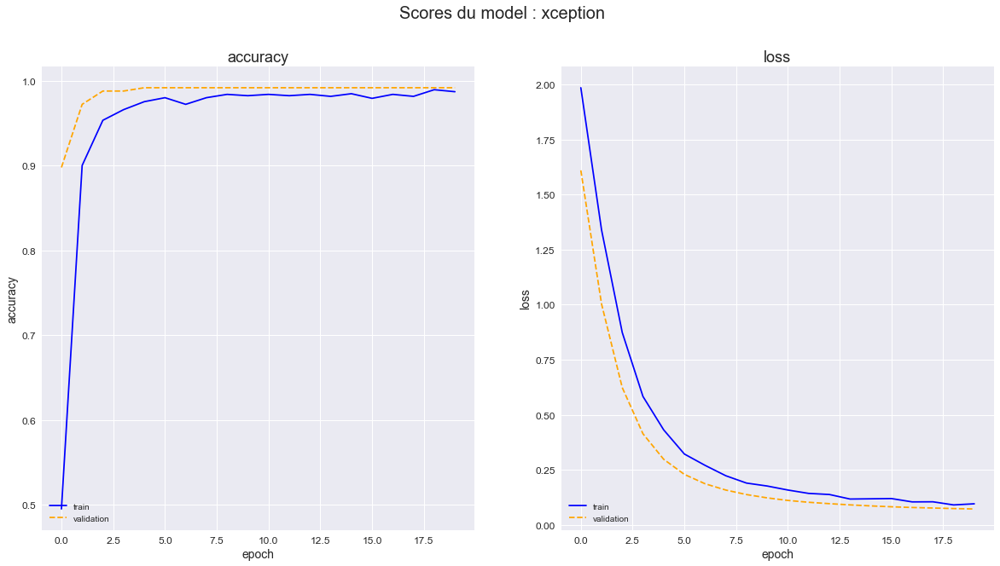

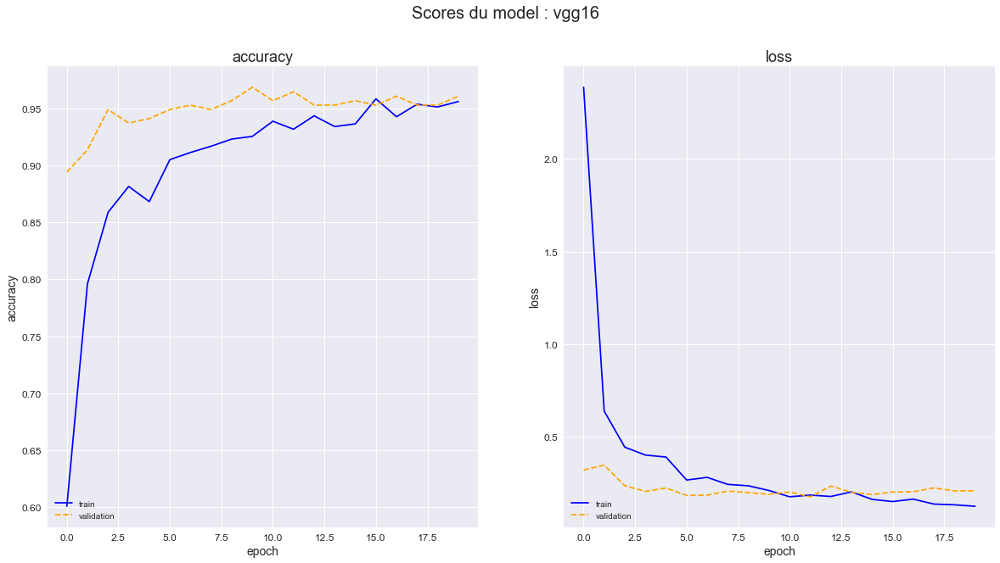

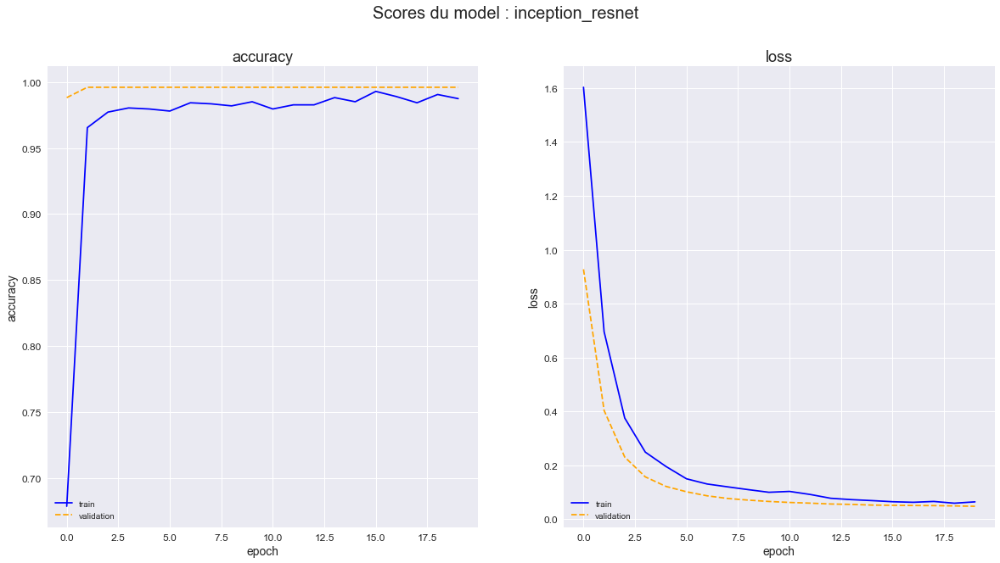

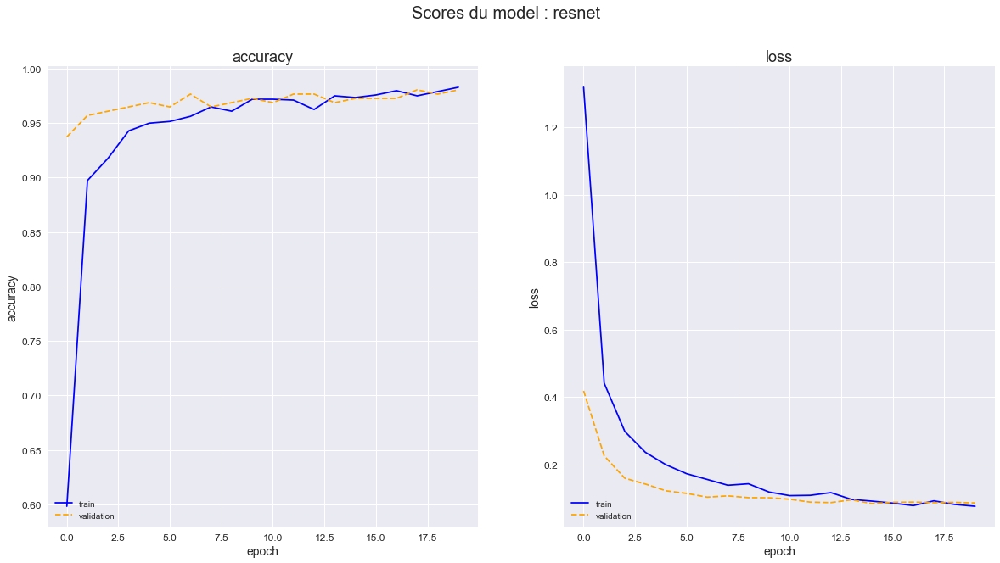

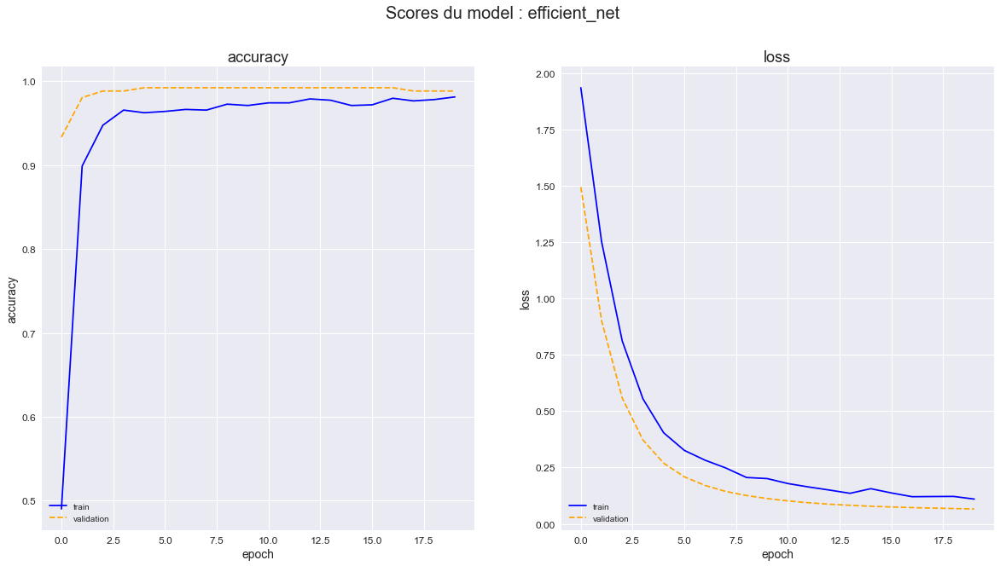

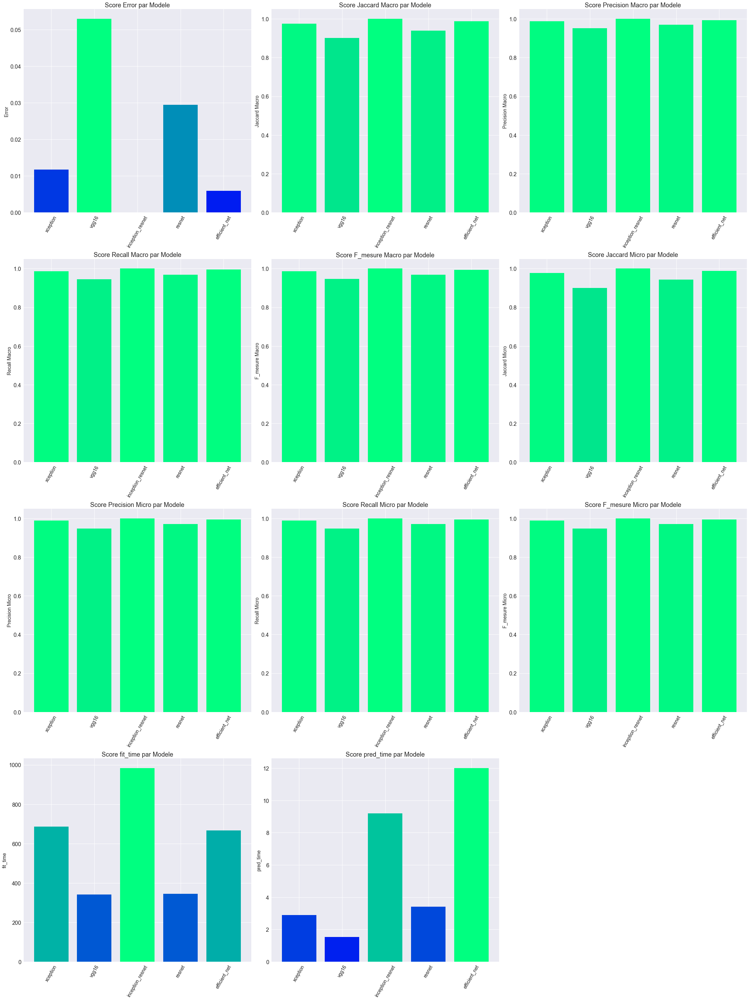

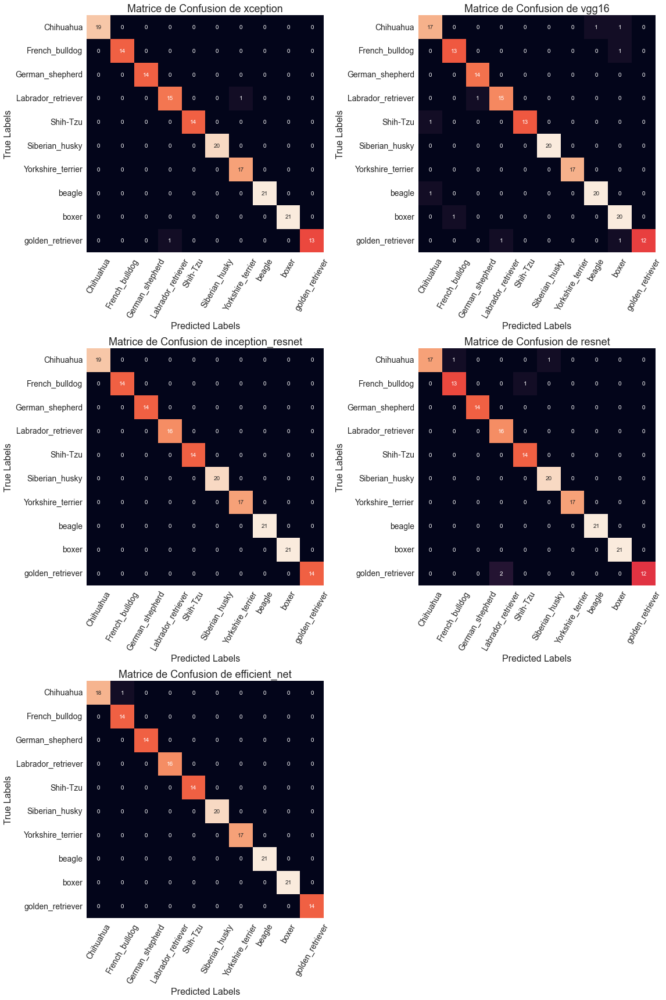

In [78]:
models_transfert.plot_history_scores(metric_list=['accuracy'])
models_transfert.plot_perf()
models_transfert.plot_confmat()

## Transfert Learning avec 80 races

In [8]:
IMAGES = 'Data/images/'
ANNOTATION = 'Data/annotation/'
folder_list = os.listdir(IMAGES)
final_folder = random.sample(folder_list, 80)

num_breeds = len(final_folder)
img_path = []
labels = []
bndbox = []

for folder_path in final_folder:
    files_path = os.listdir(ANNOTATION + folder_path)
    for file_path in files_path:
        img_path.append(IMAGES + folder_path + '/' + file_path + '.jpg')
        annot_elem = etree.parse(ANNOTATION + folder_path + '/' + file_path).getroot().find('object')
        labels.append(annot_elem.find('name').text)
        bndbox.append({
            'xmin': int(annot_elem.find('bndbox').find('xmin').text),
            'ymin': int(annot_elem.find('bndbox').find('ymin').text),
            'xmax': int(annot_elem.find('bndbox').find('xmax').text),
            'ymax': int(annot_elem.find('bndbox').find('ymax').text)
        })

In [9]:
size = []
ratios = []
imgs = []
size_box = []
ratios_box = []
img_box = []
for i, path in enumerate(img_path):
    imgs.append(cv.cvtColor(cv.imread(path), cv.COLOR_BGR2RGB))
    shape = cv.imread(path).shape
    size.append(shape[0]*shape[1])
    ratios.append(shape[0]/shape[1])
    img_box.append(recadre_inbox(imgs[i], bndbox=bndbox[i]))
    shape = img_box[-1].shape
    size_box.append(shape[0]*shape[1])
    ratios_box.append(shape[0]/shape[1])
size = np.array(size)
ratios = np.array(ratios)
size_box = np.array(size_box)
ratios_box = np.array(ratios_box)

lab_encode = LabelEncoder()
Y = lab_encode.fit_transform(labels)

train_ratio = 0.75
validation_ratio = 0.15
test_ratio = 0.10

# train is now 75% of the entire data set
# the _junk suffix means that we drop that variable completely
x_train, x_test, y_train, y_test, box_train, box_test = train_test_split(imgs, Y, bndbox, test_size=1 - train_ratio, random_state=8)

# test is now 10% of the initial data set
# validation is now 15% of the initial data set
x_val, x_test, y_val, y_test, box_val, box_test = train_test_split(x_test, y_test, box_test, test_size=test_ratio/(test_ratio + validation_ratio), random_state=7) 

In [15]:
models_full_transfert = ModelCNN(y_train=y_train, y_test=y_test, y_val=y_val, epochs=20)
models_full_transfert.add_scoring('accuracy')
models_full_transfert.add_scoring(f1_m)

x_train_box_224 = img_process(imgs=x_train, bndbox=box_train, resolution=224)
x_test_box_224 = img_process(imgs=x_test, bndbox=box_test, resolution=224)
x_val_box_224 = img_process(imgs=x_val, bndbox=box_val, resolution=224)

x_train_box_299 = img_process(imgs=x_train, bndbox=box_train, resolution=299)
x_test_box_299 = img_process(imgs=x_test, bndbox=box_test, resolution=299)
x_val_box_299 = img_process(imgs=x_val, bndbox=box_val, resolution=299)

opt = optimizers.SGD(learning_rate=0.01)
basic = ImageDataGenerator(
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True)
models_full_transfert.add_augment('basic', basic)
del x_train, x_test, box_train, box_test, x_val, box_val, imgs, bndbox

In [11]:
x_train_xception = tf.keras.applications.xception.preprocess_input(x_train_box_299)
x_test_xception = tf.keras.applications.xception.preprocess_input(x_test_box_299)
x_val_xception = tf.keras.applications.xception.preprocess_input(x_val_box_299)
models_full_transfert.add_data('xception', x_train_xception, x_test_xception, x_val_xception)
xception_model = tf.keras.applications.xception.Xception(
    weights='imagenet',
    include_top=False,
    pooling='avg')
new_xception_model = transfert_to_model(xception_model, num_breeds)

models_full_transfert.add_model(name='xception', model=new_xception_model, optimizer=opt)
models_full_transfert.fit(model_name='xception', data='xception', augment='basic')
del new_xception_model, xception_model, x_train_xception, x_test_xception, x_val_xception, models_full_transfert.x['xception']
models_full_transfert.save_models('Models/models_full_transfert_xception.pkl')
models_full_transfert.unload_models()



x_train_vgg16 = tf.keras.applications.vgg16.preprocess_input(x_train_box_224)
x_test_vgg16 = tf.keras.applications.vgg16.preprocess_input(x_test_box_224)
x_val_vgg16 = tf.keras.applications.vgg16.preprocess_input(x_val_box_224)
models_full_transfert.add_data('vgg16', x_train_vgg16, x_test_vgg16, x_val_vgg16)
vgg16_model = tf.keras.applications.VGG16(
    weights='imagenet',
    include_top=False,
    pooling='avg')
new_vgg16_model = transfert_to_model(vgg16_model, num_breeds)

models_full_transfert.add_model(name='vgg16', model=new_vgg16_model, optimizer=opt)
models_full_transfert.fit(model_name='vgg16', data='vgg16', augment='basic')
del new_vgg16_model, vgg16_model, x_train_vgg16, x_test_vgg16, x_val_vgg16, models_full_transfert.x['vgg16']
models_full_transfert.save_models('Models/models_full_transfert_vgg16.pkl')
models_full_transfert.unload_models()


x_train_inception_resnet = tf.keras.applications.inception_resnet_v2.preprocess_input(x_train_box_299)
x_test_inception_resnet = tf.keras.applications.inception_resnet_v2.preprocess_input(x_test_box_299)
x_val_inception_resnet = tf.keras.applications.inception_resnet_v2.preprocess_input(x_val_box_299)
models_full_transfert.add_data('inception_resnet', x_train_inception_resnet, x_test_inception_resnet, x_val_inception_resnet)
inception_resnet_model = tf.keras.applications.InceptionResNetV2(
    weights='imagenet',
    include_top=False,
    pooling='avg')
new_inception_resnet_model = transfert_to_model(inception_resnet_model, num_breeds)

models_full_transfert.add_model(name='inception_resnet', model=new_inception_resnet_model, optimizer=opt)
models_full_transfert.fit(model_name='inception_resnet', data='inception_resnet', augment='basic')
del new_inception_resnet_model, inception_resnet_model, x_train_inception_resnet, x_test_inception_resnet, x_val_inception_resnet, models_full_transfert.x['inception_resnet']
models_full_transfert.save_models('Models/models_full_transfert_inception_resnet.pkl')
models_full_transfert.unload_models()
# models_full_transfert.load_models('Models/models_full_transfert_inception_resnet.pkl')



x_train_resnet = tf.keras.applications.resnet50.preprocess_input(x_train_box_224)
x_test_resnet = tf.keras.applications.resnet50.preprocess_input(x_test_box_224)
x_val_resnet = tf.keras.applications.resnet50.preprocess_input(x_val_box_224)
models_full_transfert.add_data('resnet', x_train_resnet, x_test_resnet, x_val_resnet)
resnet_model = tf.keras.applications.ResNet50(
    weights='imagenet',
    include_top=False,
    pooling='avg')
new_resnet_model = transfert_to_model(resnet_model, num_breeds)

models_full_transfert.add_model(name='resnet', model=new_resnet_model , optimizer=opt)
models_full_transfert.fit(model_name='resnet', data='resnet', augment='basic')
del new_resnet_model, resnet_model, x_train_resnet, x_test_resnet, x_val_resnet, models_full_transfert.x['resnet']
models_full_transfert.save_models('Models/models_full_transfert_resnet.pkl')
models_full_transfert.unload_models()



x_train_efficientnet = tf.keras.applications.efficientnet.preprocess_input(x_train_box_224)
x_test_efficientnet = tf.keras.applications.efficientnet.preprocess_input(x_test_box_224)
x_val_efficientnet = tf.keras.applications.efficientnet.preprocess_input(x_val_box_224)
models_full_transfert.add_data('efficientnet', x_train_efficientnet, x_test_efficientnet, x_val_efficientnet)
efficient_net_model = tf.keras.applications.EfficientNetB7(
    weights='imagenet',
    include_top=False,
    pooling='avg')
new_efficient_net_model = transfert_to_model(efficient_net_model, num_breeds)

models_full_transfert.add_model(name='efficient_net', model=new_efficient_net_model , optimizer=opt)
models_full_transfert.fit(model_name='efficient_net', data='efficientnet', augment='basic')
del new_efficient_net_model, efficient_net_model, x_train_efficientnet, x_test_efficientnet, x_val_efficientnet, models_full_transfert.x['efficientnet']
models_full_transfert.save_models('Models/models_full_transfert_efficient_net.pkl')
models_full_transfert.unload_models()

données du fichier Models/models_full_transfert_inception_resnet.pkl bien chargé
le model resnet ajouté
Epoch 1/20
321/321 [==============================] - 144s 419ms/step - loss: 3.2185 - accuracy: 0.2543 - f1_m: 42.9114 - val_loss: 1.4877 - val_accuracy: 0.6980 - val_f1_m: 21.2080
Epoch 2/20
321/321 [==============================] - 124s 386ms/step - loss: 1.4641 - accuracy: 0.6145 - f1_m: 14.3056 - val_loss: 0.7218 - val_accuracy: 0.8300 - val_f1_m: 7.0932
Epoch 3/20
321/321 [==============================] - 124s 385ms/step - loss: 1.0233 - accuracy: 0.7024 - f1_m: 7.8440 - val_loss: 0.5452 - val_accuracy: 0.8446 - val_f1_m: 4.6658
Epoch 4/20
321/321 [==============================] - 123s 382ms/step - loss: 0.8657 - accuracy: 0.7403 - f1_m: 6.0953 - val_loss: 0.4928 - val_accuracy: 0.8529 - val_f1_m: 3.8337
Epoch 5/20
321/321 [==============================] - 123s 384ms/step - loss: 0.7614 - accuracy: 0.7674 - f1_m: 5.1542 - val_loss: 0.4403 - val_accuracy: 0.8597 - val_f1_m: 

In [12]:
models_full_transfert.save_models('Models/models_full_transfert.pkl')
del models_full_transfert

données du fichier Models/models_full_transfert.pkl bien sauvegardé


In [16]:
models_full_transfert = ModelCNN(y_train=y_train, y_test=y_test, y_val=y_val, epochs=20)
models_full_transfert.add_scoring('accuracy')
models_full_transfert.load_models('Models/models_full_transfert.pkl')

données du fichier Models/models_full_transfert.pkl bien chargé


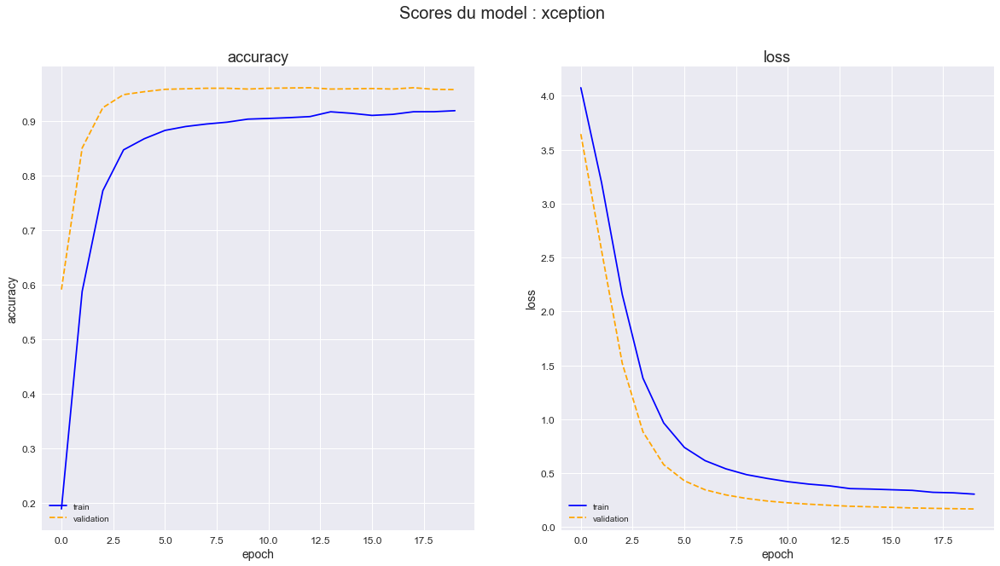

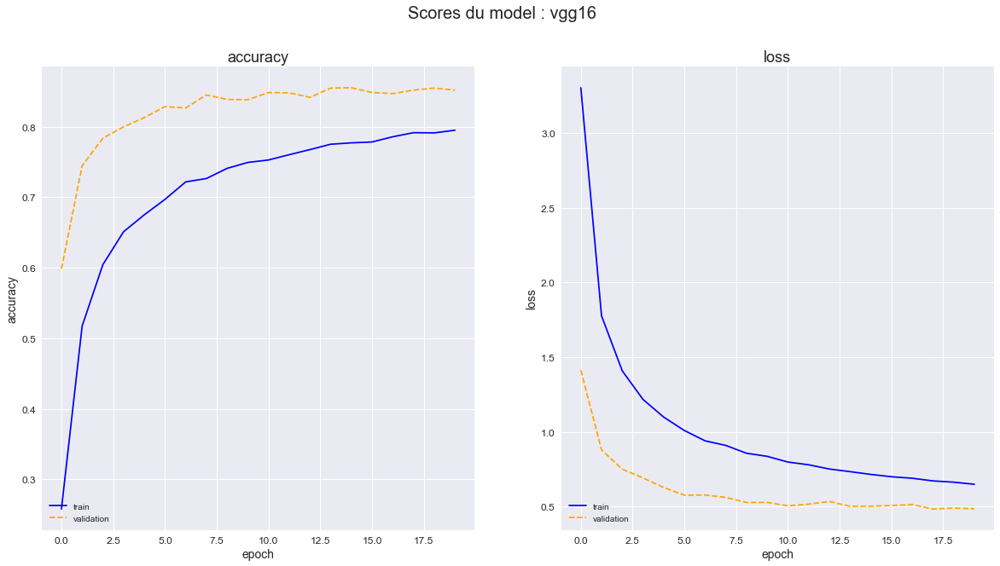

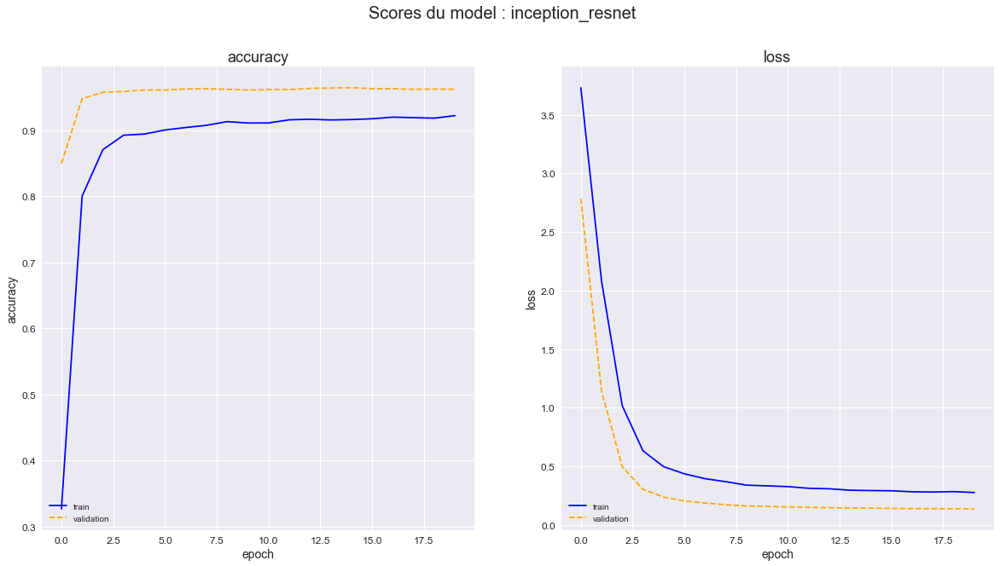

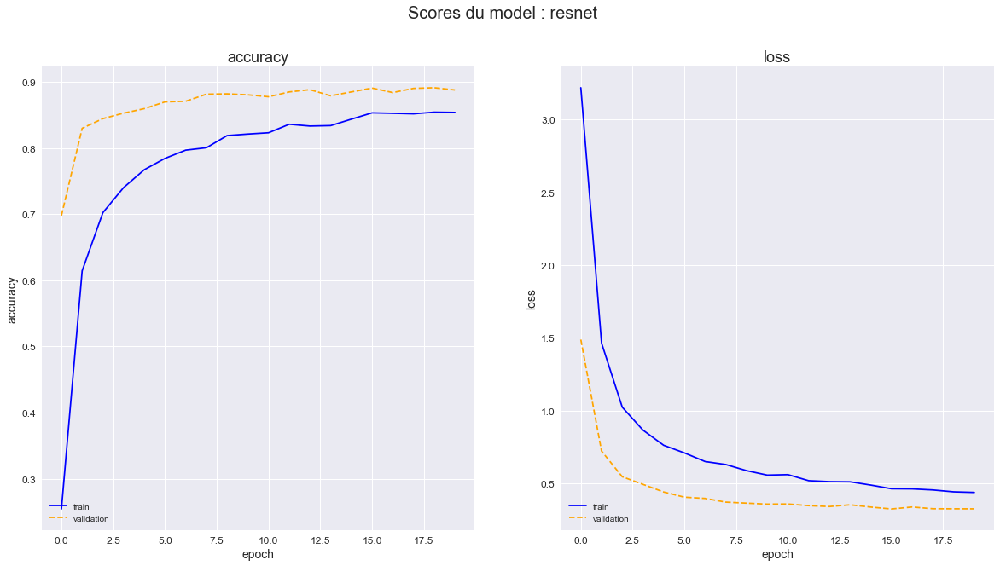

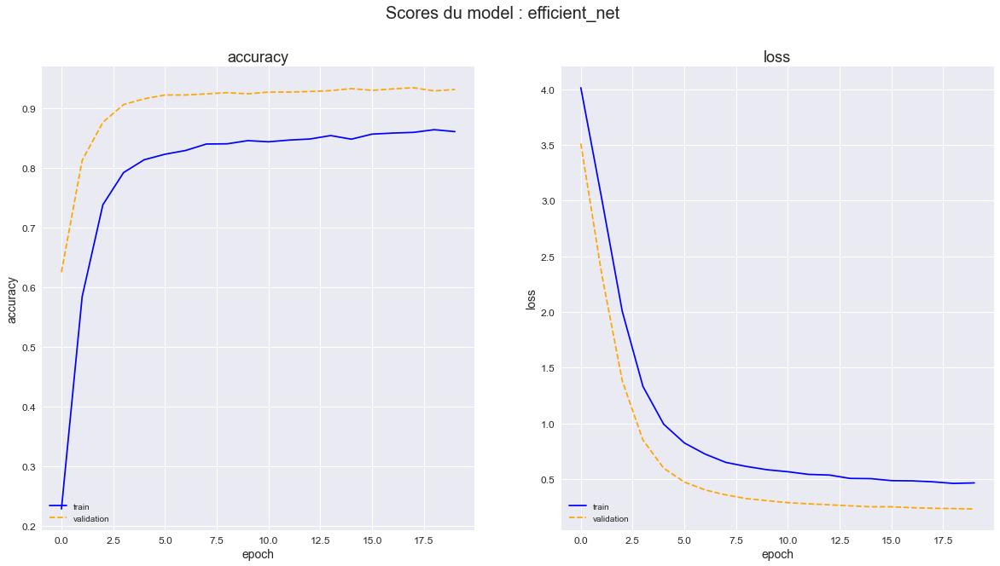

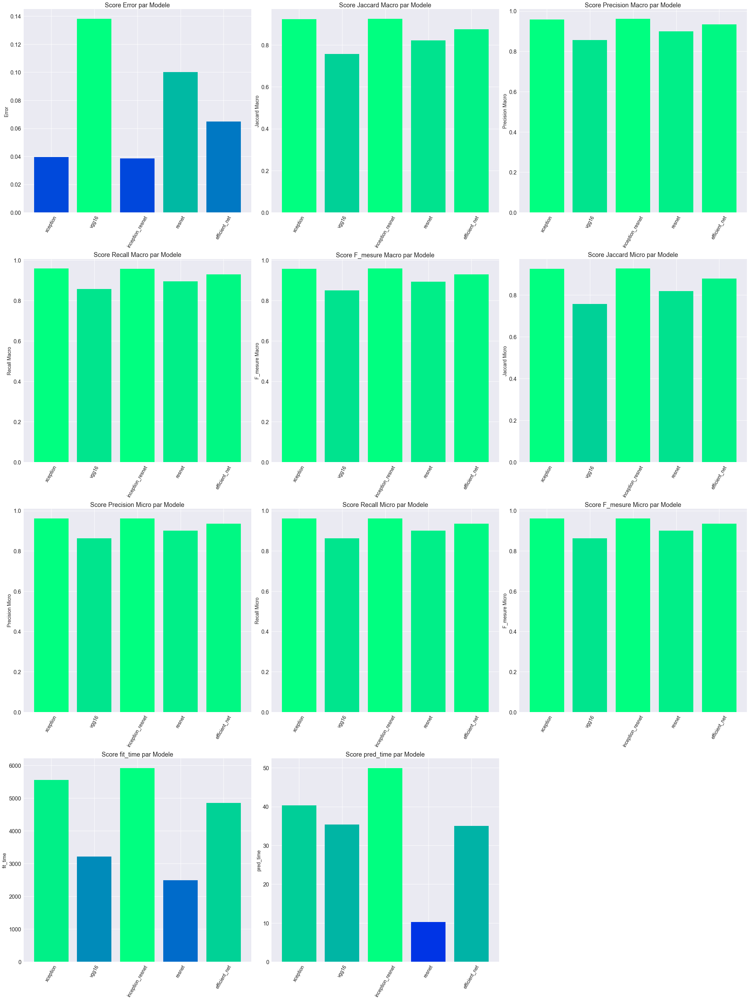

In [17]:
models_full_transfert.plot_history_scores(metric_list=['accuracy'])
models_full_transfert.plot_perf()

## Comparaison final

In [8]:
IMAGES = 'Data/images/'
ANNOTATION = 'Data/annotation/'
folder_list = os.listdir(IMAGES)
final_folder = random.sample(folder_list, 80)

num_breeds = len(final_folder)
img_path = []
labels = []
bndbox = []

for folder_path in final_folder:
    files_path = os.listdir(ANNOTATION + folder_path)
    for file_path in files_path:
        img_path.append(IMAGES + folder_path + '/' + file_path + '.jpg')
        annot_elem = etree.parse(ANNOTATION + folder_path + '/' + file_path).getroot().find('object')
        labels.append(annot_elem.find('name').text)
        bndbox.append({
            'xmin': int(annot_elem.find('bndbox').find('xmin').text),
            'ymin': int(annot_elem.find('bndbox').find('ymin').text),
            'xmax': int(annot_elem.find('bndbox').find('xmax').text),
            'ymax': int(annot_elem.find('bndbox').find('ymax').text)
        })

size = []
ratios = []
imgs = []
size_box = []
ratios_box = []
img_box = []
for i, path in enumerate(img_path):
    imgs.append(cv.cvtColor(cv.imread(path), cv.COLOR_BGR2RGB))
    shape = cv.imread(path).shape
    size.append(shape[0]*shape[1])
    ratios.append(shape[0]/shape[1])
    img_box.append(recadre_inbox(imgs[i], bndbox=bndbox[i]))
    shape = img_box[-1].shape
    size_box.append(shape[0]*shape[1])
    ratios_box.append(shape[0]/shape[1])
size = np.array(size)
ratios = np.array(ratios)
size_box = np.array(size_box)
ratios_box = np.array(ratios_box)

lab_encode = LabelEncoder()
Y = lab_encode.fit_transform(labels)

train_ratio = 0.75
validation_ratio = 0.15
test_ratio = 0.10

# train is now 75% of the entire data set
# the _junk suffix means that we drop that variable completely
x_train, x_test, y_train, y_test, box_train, box_test = train_test_split(imgs, Y, bndbox, test_size=1 - train_ratio, random_state=8)

# test is now 10% of the initial data set
# validation is now 15% of the initial data set
x_val, x_test, y_val, y_test, box_val, box_test = train_test_split(x_test, y_test, box_test, test_size=test_ratio/(test_ratio + validation_ratio), random_state=7) 

In [17]:
models_final = ModelCNN(y_train=y_train, y_test=y_test, y_val=y_val, epochs=100)
models_final.add_scoring('accuracy')
models_final.add_scoring(f1_m)

x_train_box_150 = img_process(imgs=x_train, bndbox=box_train, resolution=150)
x_test_box_150 = img_process(imgs=x_test, bndbox=box_test, resolution=150)
x_val_box_150 = img_process(imgs=x_val, bndbox=box_val, resolution=150)

x_train_xception = tf.keras.applications.xception.preprocess_input(img_process(imgs=x_train, bndbox=box_train, resolution=299))
x_test_xception = tf.keras.applications.xception.preprocess_input(img_process(imgs=x_test, bndbox=box_test, resolution=299))
x_val_xception = tf.keras.applications.xception.preprocess_input(img_process(imgs=x_val, bndbox=box_val, resolution=299))

models_final.add_data('box', x_train_box_150, x_test_box_150, x_val_box_150)
models_final.add_data('xception', x_train_xception, x_test_xception, x_val_xception)

opt = optimizers.SGD(learning_rate=0.01)

bright = ImageDataGenerator(
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True)
models_final.add_augment('bright', bright)
del x_train, x_test, box_train, box_test, x_val, box_val, imgs, bndbox

In [10]:
models_final.epochs = 20
xception_model = tf.keras.applications.xception.Xception(
    weights='imagenet',
    include_top=False,
    pooling='avg')
new_xception_model = transfert_to_model(xception_model, num_breeds)

models_final.add_model(name='xception', model=new_xception_model, optimizer=opt)
models_final.fit(model_name='xception', data='xception', augment='bright')
del new_xception_model, xception_model, x_train_xception, x_test_xception, x_val_xception, models_final.x['xception']
models_final.save_models('Models/models_final_xception.pkl')
models_final.unload_models()

models_final.epochs = 100
mod_8conv= [
        Rescaling(scale=1./255),
        Conv2D(filters=32, kernel_size=(3,3), padding='same', activation='relu'),
        Conv2D(32, (3,3), activation='relu'),
        MaxPooling2D((2,2)),  # Pooling
        Dropout(0.2), # Dropout
        Conv2D(64, (3,3), padding='same', activation='relu'),
        Conv2D(64, (3,3), activation='relu'),
        MaxPooling2D((2,2)),
        Dropout(0.2),
        Conv2D(128, (3,3), padding='same', activation='relu'),
        Conv2D(128, (3,3), activation='relu'),
        Activation('relu'),
        MaxPooling2D((2,2)),
        Dropout(0.2),
        Conv2D(512, (5,5), padding='same', activation='relu'),
        Conv2D(512, (5,5), activation='relu'),
        MaxPooling2D((4,4)),
        Dropout(0.2),
        Flatten(),
        Dense(1024, activation='relu'),
        Dropout(0.2),
        Dense(num_breeds, activation='softmax')
    ]
models_final.add_model(name='8conv', layers=mod_8conv, optimizer=opt)
del mod_8conv
models_final.fit(model_name='8conv', data='box', augment='bright')
models_final.save_models('Models/models_final_8conv.pkl')
models_final.unload_models()



le model xception ajouté
Epoch 1/20
323/323 [==============================] - 383s 1s/step - loss: 4.0822 - accuracy: 0.1716 - f1_m: 72.0685 - val_loss: 3.6347 - val_accuracy: 0.5714 - val_f1_m: 70.7394
Epoch 2/20
323/323 [==============================] - 228s 704ms/step - loss: 3.1879 - accuracy: 0.5670 - f1_m: 60.5280 - val_loss: 2.5459 - val_accuracy: 0.8281 - val_f1_m: 55.7345
Epoch 3/20
323/323 [==============================] - 227s 703ms/step - loss: 2.1743 - accuracy: 0.7482 - f1_m: 43.3600 - val_loss: 1.5321 - val_accuracy: 0.9061 - val_f1_m: 34.0159
Epoch 4/20
323/323 [==============================] - 227s 702ms/step - loss: 1.4106 - accuracy: 0.8232 - f1_m: 24.7793 - val_loss: 0.9128 - val_accuracy: 0.9293 - val_f1_m: 14.8693
Epoch 5/20
323/323 [==============================] - 227s 702ms/step - loss: 0.9813 - accuracy: 0.8561 - f1_m: 13.5942 - val_loss: 0.6132 - val_accuracy: 0.9308 - val_f1_m: 7.8050
Epoch 6/20
323/323 [==============================] - 228s 706ms/step

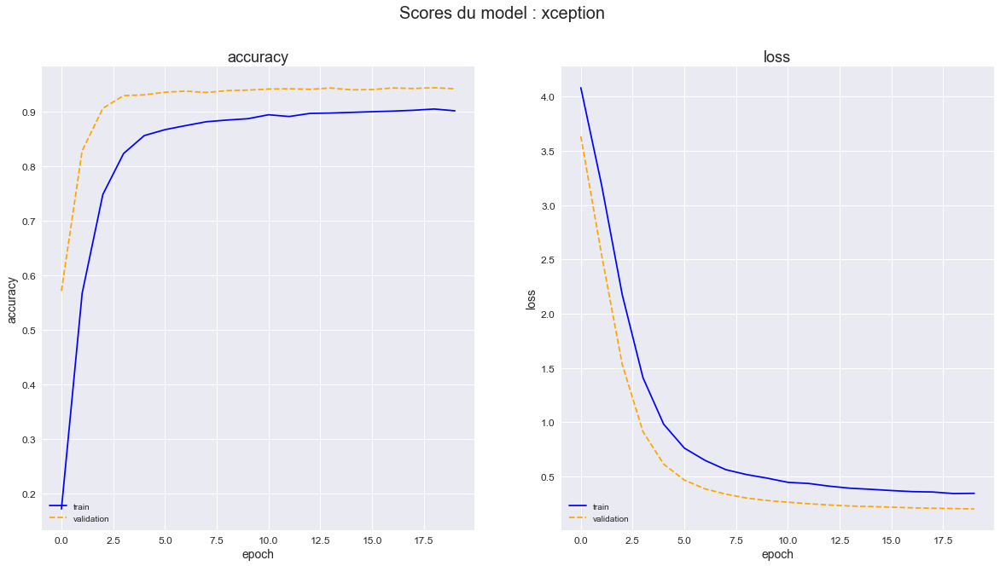

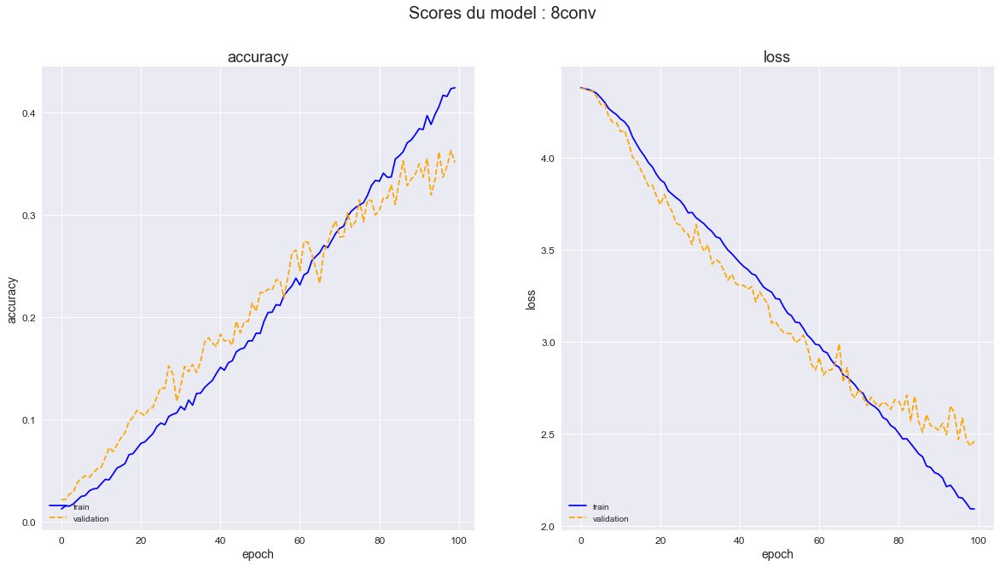

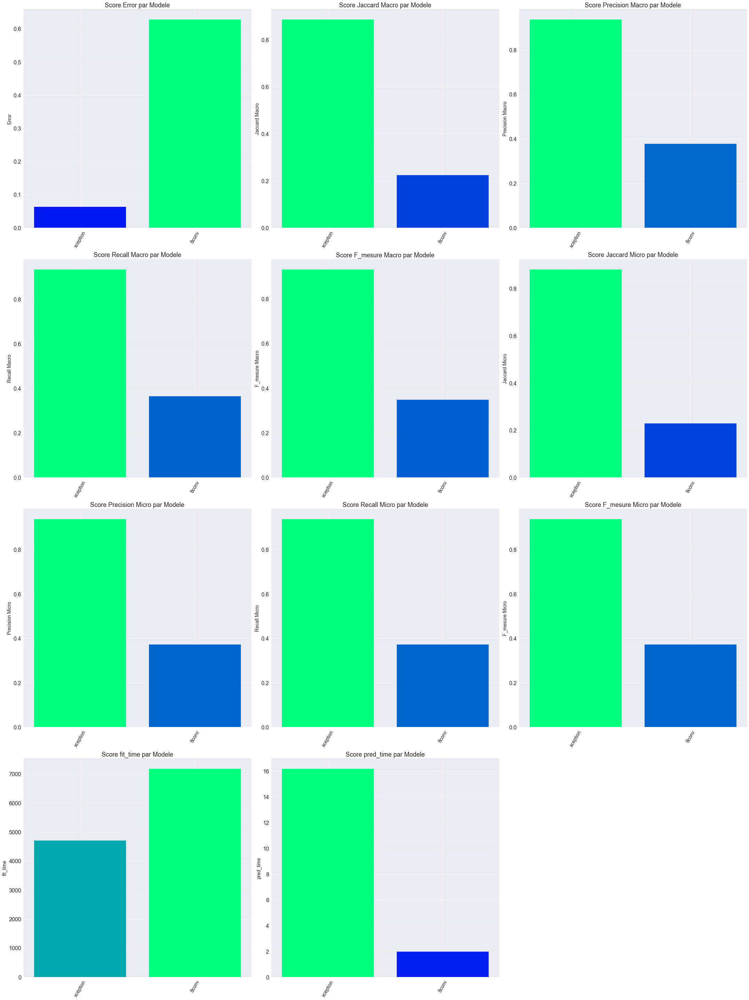

In [12]:
models_final.plot_history_scores(metric_list=['accuracy'])
models_final.plot_perf()

## Modèle final

In [ ]:
IMAGES = 'Data/images/'
ANNOTATION = 'Data/annotation/'
folder_list = os.listdir(IMAGES)
final_folder = folder_list

num_breeds = len(final_folder)
img_path = []
labels = []
bndbox = []

for folder_path in final_folder:
    files_path = os.listdir(ANNOTATION + folder_path)
    for file_path in files_path:
        img_path.append(IMAGES + folder_path + '/' + file_path + '.jpg')
        annot_elem = etree.parse(ANNOTATION + folder_path + '/' + file_path).getroot().find('object')
        labels.append(annot_elem.find('name').text)
        bndbox.append({
            'xmin': int(annot_elem.find('bndbox').find('xmin').text),
            'ymin': int(annot_elem.find('bndbox').find('ymin').text),
            'xmax': int(annot_elem.find('bndbox').find('xmax').text),
            'ymax': int(annot_elem.find('bndbox').find('ymax').text)
        })

size = []
ratios = []
imgs = []
size_box = []
ratios_box = []
img_box = []
for i, path in enumerate(img_path):
    imgs.append(cv.cvtColor(cv.imread(path), cv.COLOR_BGR2RGB))
    shape = cv.imread(path).shape
    size.append(shape[0]*shape[1])
    ratios.append(shape[0]/shape[1])
    img_box.append(recadre_inbox(imgs[i], bndbox=bndbox[i]))
    shape = img_box[-1].shape
    size_box.append(shape[0]*shape[1])
    ratios_box.append(shape[0]/shape[1])
size = np.array(size)
ratios = np.array(ratios)
size_box = np.array(size_box)
ratios_box = np.array(ratios_box)

lab_encode = LabelEncoder()
Y = lab_encode.fit_transform(labels)

train_ratio = 0.75
validation_ratio = 0.15
test_ratio = 0.10

# train is now 75% of the entire data set
# the _junk suffix means that we drop that variable completely
x_train, x_test, y_train, y_test, box_train, box_test = train_test_split(imgs, Y, bndbox, test_size=1 - train_ratio, random_state=8)

# test is now 10% of the initial data set
# validation is now 15% of the initial data set
x_val, x_test, y_val, y_test, box_val, box_test = train_test_split(x_test, y_test, box_test, test_size=test_ratio/(test_ratio + validation_ratio), random_state=7) 

In [12]:
x_train_xception = tf.keras.applications.xception.preprocess_input(img_process(imgs=x_train, bndbox=box_train, resolution=299))
x_test_xception = tf.keras.applications.xception.preprocess_input(img_process(imgs=x_test, bndbox=box_test, resolution=299))
x_val_xception = tf.keras.applications.xception.preprocess_input(img_process(imgs=x_val, bndbox=box_val, resolution=299))

opt = optimizers.SGD(learning_rate=0.01)

bright = ImageDataGenerator(
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True)
del x_train, x_test, box_train, box_test, x_val, box_val, imgs, bndbox

In [13]:
xception_model = tf.keras.applications.xception.Xception(
    weights='imagenet',
    include_top=False,
    pooling='avg')
new_xception_model = transfert_to_model(xception_model, num_breeds)
new_xception_model.compile(optimizer=opt,
            loss="sparse_categorical_crossentropy",
            metrics=['accuracy'])
history = new_xception_model.fit(
    bright.flow(
        x_train_xception, y_train,
        batch_size=32, shuffle=True),
    validation_data=(x_val_xception, y_val),
    batch_size=32,
    steps_per_epoch=None,
    epochs=30,
    verbose=1)

Epoch 1/30
483/483 [==============================] - 407s 808ms/step - loss: 4.5295 - accuracy: 0.1276 - val_loss: 4.1178 - val_accuracy: 0.4678
Epoch 2/30
483/483 [==============================] - 389s 802ms/step - loss: 3.7110 - accuracy: 0.4501 - val_loss: 3.0576 - val_accuracy: 0.7247
Epoch 3/30
483/483 [==============================] - 388s 799ms/step - loss: 2.6452 - accuracy: 0.6494 - val_loss: 1.9058 - val_accuracy: 0.8393
Epoch 4/30
483/483 [==============================] - 382s 786ms/step - loss: 1.7614 - accuracy: 0.7407 - val_loss: 1.1410 - val_accuracy: 0.8811
Epoch 5/30
483/483 [==============================] - 384s 791ms/step - loss: 1.2375 - accuracy: 0.7860 - val_loss: 0.7598 - val_accuracy: 0.8963
Epoch 6/30
483/483 [==============================] - 383s 789ms/step - loss: 0.9718 - accuracy: 0.8047 - val_loss: 0.5823 - val_accuracy: 0.9041
Epoch 7/30
483/483 [==============================] - 385s 792ms/step - loss: 0.8163 - accuracy: 0.8225 - val_loss: 0.4841 -

In [14]:
new_xception_model.save('model.h5')
np.save('labels.npy', lab_encode.classes_)
del new_xception_model

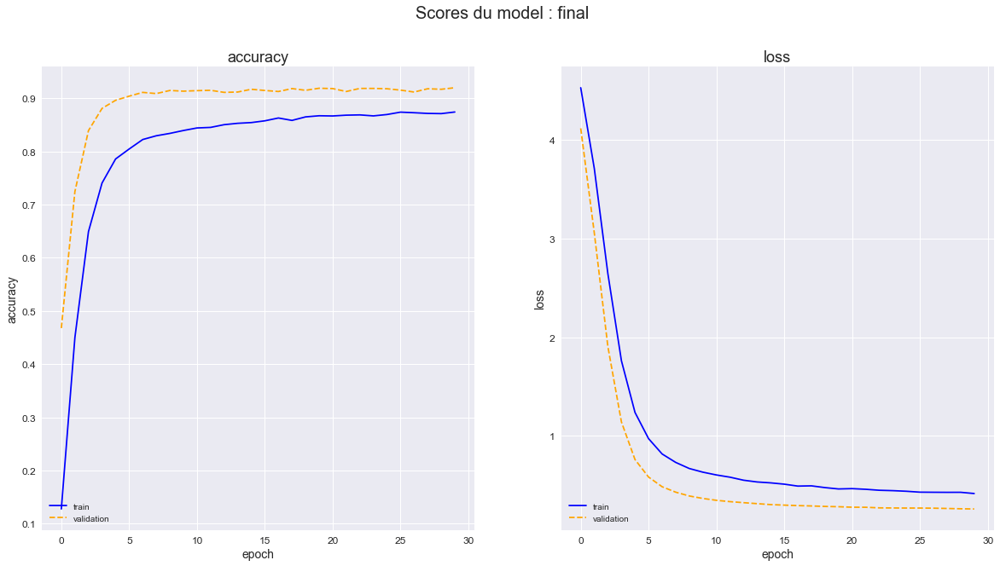

In [15]:
plt.figure(figsize=(20, 10))
plt.suptitle('Scores du model : final', fontsize=20)
plt.subplot(121)
plt.style.context('seaborn-whitegrid')
plt.plot(history.history['accuracy'], color="b")
plt.plot(history.history['val_accuracy'],
        linestyle='--', color="orange")
plt.title('accuracy', fontsize=18)
plt.yticks(fontsize=12)
plt.xticks(fontsize=12)
plt.xlabel('epoch', fontsize=14)
plt.ylabel('accuracy', fontsize=14)
plt.legend(['train', 'validation'], loc='lower left')
plt.subplot(122)
plt.style.context('seaborn-whitegrid')
plt.plot(history.history['loss'], color="b")
plt.plot(history.history['val_loss'],
        linestyle='--', color="orange")
plt.title('loss', fontsize=18)
plt.yticks(fontsize=12)
plt.xticks(fontsize=12)
plt.xlabel('epoch', fontsize=14)
plt.ylabel('loss', fontsize=14)
plt.legend(['train', 'validation'], loc='lower left')
plt.show()